# 1. Imports & Definitions

## 1.1. Master

Imports

In [1]:
''' imports '''

import numpy as np
import pandas as pd

from scipy.interpolate import splrep, splev
from scipy.signal import savgol_filter
import os, re, logging

%matplotlib widget
#import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt

import matplotlib.colors as colors
import matplotlib.cm as cmx

from matplotlib.gridspec import GridSpec
from matplotlib.colors import Normalize

import pickle, random

# density clustering using HDBSCAN* algorithm
#import hdbscan

# dimensionality reduction using UMAP
#import umap

''' torch imports '''

import torch, math

from torch import nn
from torch import optim
from torch.distributions import Normal

import glob
from PIL import Image
import matplotlib.animation as animation

import json

#import torchsde, torchcde



''' init shjnn dev env '''

# set auto reload imported modules
%load_ext autoreload
%autoreload 2

import os
# create save and gif folders if they dont exist already
if not os.path.exists('./saves/'):
    os.makedirs('./saves/')
if not os.path.exists('./gifs/'):
    os.makedirs('./gifs/')

# add location to path
import sys
sys.path.append('../libs/')

import shjnn
import time
import ffmpeg

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
#device = 'cpu'
device

device(type='cpu')

Dataloader


In [2]:
def dataloader(data_out):

    """
    Load raw data from file, map parameters to dimension data, compile lists of parameters, and generate full single-sample dataset.
    args: None
    returns: trajs, times, y
    """
    # decide whether to filter data before t=0
    filter = data_out['cut_zero']
    
    ## load raw data from file

    # open binary file for reading
    with open('{}/{}'.format('../run/', 'raw-full'), 'rb') as file:

        # load pickled data storage array
        db = pickle.load(file)


    ## parameter mappings to dimension data

    val_map = {
        # sample id to thickness in nm
        'thickness': {'source': 'sample',
                    '12': 160, '16': 160, '21': 160, '33': 160, '45': 160, '58': 160, },
        # intensity in uJ
        'intensity': {'source': 'int',
                    'dark': 0., '32uJ': 32., '10uJ': 10., '3uJ': 3., '1uJ': 1., '03uJ': .3},
        # voltage in V
        'voltage': {'source': 'vlt',
                    '05V': .5, '0V': 0., '15V': 1.5, '1V': 1., '2V': 2.},
        # delay time in log10(s)
        'delay': {'source': 'del',
                '100ns': 1e-7, '100us': 1e-4, '10ms': 1e-2, '10us': 1e-5, '1ms': 1e-3, '1us': 1e-6,
                '200ns': 2e-7, '200us': 2e-4, '20ms': 2e-2, '20us': 2e-5, '2ms': 2e-3, '2us': 2e-6,
                '500ns': 5e-7, '500us': 5e-4, '50ms': 5e-2, '50us': 5e-5, '5ms': 5e-3, '5us': 5e-6,
                },
    }

    ''' generate properties data '''

    # iterate nodes in database
    for node in db[:]:
        
        props = {}
        
        # iterate value mapping
        for key, value in val_map.items():
        
            # check node params for value
            if value['source'] in node['params'].keys():
                
                # map param to prop value
                props[key] = value[ node['params'][ value['source'] ] ]
                            
            else:
                # store zero for no match
                props[key] = 0.
                
        # store props in node
        node['props'] = props
    ''' generate properties data '''

    # iterate nodes in database
    for node in db[:]:
        
        props = {}
        
        # iterate value mapping
        for key, value in val_map.items():
        
            # check node params for value
            if value['source'] in node['params'].keys():
                
                # map param to prop value
                props[key] = value[ node['params'][ value['source'] ] ]
                            
            else:
                # store zero for no match
                props[key] = 0.
                
        # store props in node
        node['props'] = props

    ''' compile lists params '''

    # compile list samples
    smpls = sorted(list(set([ _['params']['sample'] for _ in db ])))
    print( 'smpls', smpls )

    # compile list voltages
    vlts = sorted(list(set([ _['props']['voltage'] for _ in db ])))
    print( 'vlts', vlts )

    # compile list voltages
    ints = sorted(list(set([ _['props']['intensity'] for _ in db ])))
    print( 'ints', ints )

    # complete list delays
    #dels = sorted(list(set([ _['props']['delay'] for _ in db ])))[1::]
    # restricted delay set
    dels = sorted(list(set([ _['props']['delay'] for _ in db ])))[1::3]
    print( 'dels', dels )

    
    ''' get full single-sample dataset '''

    # select transient conditions
    _smpl = '33'
    #_int = '10uJ'
    #_vlt = '15V'
    #_del = '10us'

    _db = [ n for n in db if
        n['params']['sample'] == _smpl and
        n['props']['delay'] != 0.
        #n['params']['int'] == _int and
        #n['params']['vlt'] == _vlt and
        #n['params']['del'] == _del
        ]

    print(len(_db))


    # initialise figure
    fig = plt.figure(figsize = (8,6))
    #axs = [[ fig.add_subplot(v,h,i+1) for i in range(h*v) ] for h,v in [(2,1)]][0]
    axs = [[ fig.add_subplot(v,h,i+1) for i in range(h*v) ] for h,v in [(1,1)]][0]

    # colourmap
    cnorm  = colors.Normalize(vmin = 0, vmax = len(_db[::10])); smap = cmx.ScalarMappable(norm = cnorm, cmap = 'viridis')

    # zero baseline
    axs[0].plot([1e-8, 1e-4], [0,0], '--k')


    for i, n in enumerate(_db[::10]):
        
        # get time axis
        t = n['data'][:,0]
        d = n['data'][:,1]/50.
        #d0 = dark0['data'][:,1]#/50.
        #ds = d-d0

        c = smap.to_rgba(i)

        #print(light['params']['del'])

        #np.power(10,val_map['delay'][light['params']['del']])
        #sub = np.vstack([dark[:,0], (light[:,1] - dark[:,1])/50. ]).T

        #l = light['data'][:,1]#/50.
        #s = l-d

        # calculate current transient, illuminated less dark transient, voltage over 50 Ohm res
        #a = (light[:,1] - dark[:,1])/50.

        # smooth and calculate derivatives
        a = savgol_filter(x = d, window_length = 5, polyorder = 1, deriv = 0)

        _ds = 10
        
        # plot data
        axs[0].plot(t[::_ds], d[::_ds], '.', alpha = 0.2, color = c, linewidth = 2)
        axs[0].plot(t[::_ds], a[::_ds], '-', alpha = 0.44, color = c, linewidth = 1, label = ''.format())


        #axs[1].plot(t, da, '-', alpha = 0.7, color = c, linewidth = 1, label = '{}'.format(light['params']['int']))

            
    # format plots
    for i in range(len(axs)):
        axs[i].set_xscale('log')
        axs[i].set_xlim(1.0e-8, 1.0e-4)
        #axs[i].set_xlim(2.0e-7, 1.0e-4)
        
        #axs[i].set_ylim(0., 1.0e-2)
        axs[i].set_xlabel('Extraction Time (s)')
        axs[i].set_ylabel('Extracted Charge (A)')
        #axs[i].legend(title='Illumination')
        
    plt.tight_layout()
    plt.show()

    if filter:
        # filter data to only include non-zero delay times
        j = np.where(_db[0]['data'][:,0] > 2e-7)[0]

        # get log time steps, shift decay start to zero
        d = np.transpose( np.stack([ [ 
        # np.log10(n['data'][j,0][::_ds]), # time

        n['data'][j,1][::_ds]*1e2, # response, scale to ~one
        #np.log10(n['data'][j,0][::_ds])+6.6,

        #np.ones(len(ts))* np.log10(n['props']['intensity']),
        #np.ones(len(ts))* n['props']['voltage']/10,
        #np.ones(len(ts))* np.abs(np.log10(n['props']['delay']))/10,
        ]
        #for n in _db ]), (2,0,1))
        for n in _db ]), (0,2,1))
        
        # compile env. labels
        ts = np.transpose( np.stack([ [ 
            #n['data'][:,0][::_ds], # time
            #n['data'][j,0][::_ds]
            
            np.log10(n['data'][j,0][::_ds])+6.7,
        ]
        #for n in _db ]), (2,0,1))
            for n in _db ]), (0,2,1))

    else:
        j = np.where(_db[0]['data'][:,0] > 1e-9)[0]
        # get log time steps, shift decay start to zero
        #ts = np.log10(db[0]['data'][:,0][::_ds])
        ts = np.transpose( np.stack([ [ 
            #n['data'][:,0][::_ds], # time
            #n['data'][j,0][::_ds]
            
            np.log10(n['data'][j,0][::_ds])+6.7,
        ]
        #for n in _db ]), (2,0,1))
            for n in _db ]), (0,2,1))


        # stack raw data and env vars, time first
        #d = np.transpose( np.stack([ [ n['data'][:,1][::_ds], 
        d = np.transpose( np.stack([ [ 
            #np.log10(n['data'][j,0][::_ds]), # time
            
            n['data'][j,1][::_ds]*1e2, # response, scale to ~one
            #np.log10(n['data'][j,0][::_ds])+6.6,
            
        #np.ones(len(ts))* np.log10(n['props']['intensity']),
        #np.ones(len(ts))* n['props']['voltage']/10,
        #np.ones(len(ts))* np.abs(np.log10(n['props']['delay']))/10,
        ]
        #for n in _db ]), (2,0,1))
            for n in _db ]), (0,2,1))

    print(ts.shape, d.shape)

    ''' compile env. labels '''

    # stack raw data and env vars, time first
    y = np.stack([ [ 
    n['props']['intensity'],
    n['props']['voltage'],
    n['props']['delay'],
    ]
        for n in _db ])

    y.shape

    # compile trajectories, time as tensors, push to device
    trajs = torch.Tensor(d).to(device)
    times = torch.Tensor(ts).to(device)

    print(len(d), d[0].shape, ts[0].shape)

    data_out['trajs'] = trajs
    data_out['times'] = times
    data_out['y'] = y


Initialise Model

In [3]:
def init_model(model_params):
    """
        inits models - always to CPU.
        args: model_params
        return: model_params (updated)
    """
    latent_dim = model_params['latent_dim']
    nhidden = model_params['nhidden']
    rnn_nhidden = model_params['rnn_nhidden']
    obs_dim = model_params['obs_dim']
    lr = model_params['lr']
    n_batch = model_params['n_batch']

    func, rec, dec, optim, device = shjnn.init_model(latent_dim, nhidden, rnn_nhidden, obs_dim, n_batch, lr, device = 'cpu')
    loss: list = []
    epochs = 0
    device

    model_params['func'] = func
    model_params['rec'] = rec
    model_params['dec'] = dec
    model_params['optim'] = optim
    model_params['device'] = device
    model_params['loss'] = loss
    model_params['epochs'] = epochs
    model_params['loss'] = loss
    model_params['MSE_loss'] = loss
    model_params['KL_loss'] = loss

    return model_params

Training loop

In [4]:
def training_loop(n_epochs, model_params, dataset):
    ''' run training loop with save 
        args: n_epochs, model_params, dataset
        return: model_params (updated)
    '''

    

    # beta for beta latent dissentanglement
    #beta = 4.
    # beta = .01

    # update learning rate
    # lr = 1e-3

    lr = model_params['lr']
    n_batch = model_params['n_batch']
    beta = model_params['beta']
    optim = model_params['optim']


    for g in optim.param_groups:
        g['lr'] = lr

    # get data
    trajs = dataset['trajs']
    times = dataset['times']

    # get model
    func = model_params['func']
    rec = model_params['rec']
    dec = model_params['dec']
    device = model_params['device']

    # run training for epochs, return loss
    try:
        _epochs, _loss, _MSE_loss, _KL_loss = shjnn.train(func, rec, dec, optim, trajs[:], times[:], n_epochs, n_batch, device, beta)
        print('Try')
        print('loss', _loss, 'epochs', _epochs, 'MSE_loss', _MSE_loss, 'KL_loss', _KL_loss)
        # plot all three losses
        plt.figure()
        plt.plot(_loss, label = 'loss')
        plt.plot(_MSE_loss, label = 'MSE_loss')
        plt.plot(_KL_loss, label = 'KL_loss')
        plt.legend()
        plt.show()

        # update loss, epochs
        print(type(model_params['loss']), type(_loss))
        print(type(model_params['MSE_loss']), type(_MSE_loss))
        print(type(model_params['KL_loss']), type(_KL_loss))
        model_params['loss'] += _loss
        model_params['epochs'] += _epochs
        model_params['MSE_loss'] += _MSE_loss
        model_params['KL_loss'] += _KL_loss

        # plot all three losses again
        plt.figure()
        plt.plot(model_params['loss'], label = 'loss')
        # plt.plot(model_params['MSE_loss'], label = 'MSE_loss')
        # plt.plot(model_params['KL_loss'], label = 'KL_loss')
        plt.legend()
        plt.show()
    except:
        model_params['loss'] += model_params['loss'][-1]
        model_params['epochs'] += model_params['epochs'][-1]
        model_params['MSE_loss'] += model_params['MSE_loss'][-1]
        model_params['KL_loss'] += model_params['KL_loss'][-1]
        print('Except')
        print('loss', model_params['loss'], 'epochs', model_params['epochs'], 'MSE_loss', model_params['MSE_loss'], 'KL_loss', model_params['KL_loss'])

    return model_params

def done_training(model_params):
    """ check if training is done
        args: model_params
        return: bool
    """
    reach_epoch = model_params['epochs'] >= model_params['total_epochs_train']
    if len(model_params['loss']) < 10:
        reach_loss = False
    elif model_params['loss'] == None:
        reach_loss = False
    else:
        reach_loss = model_params['loss'][-1] < model_params['loss_thresh']
    return  reach_epoch or reach_loss

input adaptive update functions here

In [5]:
# parameter update functions (runs during runs and updatesand )

def update_beta(model_params, epochs):
    model_params['beta'] = model_params['beta']

def update_lr(model_params, epochs):
    model_params['lr'] = model_params['lr']

def update_n_epochs(model_params, epochs):
    return

def update_params(model_params, epochs):
    update_beta(model_params, epochs)
    update_lr(model_params, epochs)
    update_n_epochs(model_params, epochs)

Data processing and interpretation

In [6]:
def plot_training_loss(model_params, save=False, split=False):
    ''' plot training loss '''
    if split:
        MSE_loss = model_params['MSE_loss']
        KL_loss = model_params['KL_loss']

        k = 1; _w = 5; _h = 2*k; fig = plt.figure(figsize = (_w, _h))
        #fig.canvas.layout.width = '{}in'.format(_w); fig.canvas.layout.height= '{}in'.format(_h)
        ax = [ [ fig.add_subplot(j,1,i) for i in range(1,j+1) ] for j in [k] ][0]
        ax1 = ax[0].twinx()

        # plot original and predicted trajectories
        ax[0].plot([_+1e1 for _ in MSE_loss], '-b', label = 'MSE loss', alpha = 0.3, color='red')
        ax1.plot([_+1e1 for _ in KL_loss], '-b', label = 'KL loss', alpha = 0.3)

        # smooth loss
        train_MSE_loss = np.abs( savgol_filter(MSE_loss, 13, 3) )
        train_KL_loss = np.abs( savgol_filter(KL_loss, 13, 3) )

        # plot original and predicted trajectories
        # ax[0].plot([_+1e1 for _ in train_MSE_loss], '-b', alpha = 0.8, color='red')
        # ax1.plot([_+1e1 for _ in train_KL_loss], '-b', alpha = 0.8)


        # format and display figure
        plt.yscale('log')
        #plt.xscale('log')

        plt.xlabel('Iterations')
        plt.ylabel('Loss')

        plt.legend()
        plt.tight_layout()
        plt.show()

        if save:
            folder = model_params['folder']
            save_folder = f"{folder}/loss_graph/"
            if not os.path.exists(save_folder):
                os.makedirs(save_folder)
            plt.savefig(f"{save_folder}/loss_graph_split.png")
    else:
        # get loss
        loss = model_params['loss']

        # initialise figure
        k = 1; _w = 5; _h = 2*k; fig = plt.figure(figsize = (_w, _h))
        #fig.canvas.layout.width = '{}in'.format(_w); fig.canvas.layout.height= '{}in'.format(_h)
        ax = [ [ fig.add_subplot(j,1,i) for i in range(1,j+1) ] for j in [k] ][0]


        # plot original and predicted trajectories
        ax[0].plot([_+1e1 for _ in loss], '-b', label = 'training loss', alpha = 0.3)

        # smooth loss
        train_loss = np.abs( savgol_filter(loss, 13, 3) )

        # plot original and predicted trajectories
        ax[0].plot([_+1e1 for _ in train_loss], '-b', alpha = 0.8)


        # format and display figure
        plt.yscale('log')
        #plt.xscale('log')

        plt.xlabel('Iterations')
        plt.ylabel('Loss')

        plt.legend()
        plt.tight_layout()
        plt.show()

        if save:
            folder = model_params['folder']
            save_folder = f"{folder}/loss_graph/"
            if not os.path.exists(save_folder):
                os.makedirs(save_folder)
            plt.savefig(f"{save_folder}/loss_graph.png")

def plot_training_loss(model_params, save=False, split=False):
    ''' plot training loss '''
    if split:
        MSE_loss = model_params['MSE_loss']
        KL_loss = model_params['KL_loss']
        print(MSE_loss)
        print(KL_loss)

        k = 1
        _w = 5
        _h = 2*k
        fig = plt.figure(figsize=(_w, _h))

        # Simplified subplot addition
        ax = fig.add_subplot(1, 1, 1)
        ax1 = ax.twinx()

        # Plot MSE_loss with red color on the primary y-axis
        ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3)

        # Plot KL_loss with blue color on the secondary y-axis
        ax1.plot(KL_loss, '-b', label='KL loss', alpha=0.3)

        # Smooth loss using Savitzky-Golay filter for both MSE_loss and KL_loss
        train_MSE_loss = np.abs(savgol_filter(MSE_loss, 13, 3))
        train_KL_loss = np.abs(savgol_filter(KL_loss, 13, 3))

        # Optionally plot smoothed losses (uncomment to use)
        # ax.plot(train_MSE_loss, '-r', alpha=0.8)
        # ax1.plot(train_KL_loss, '-b', alpha=0.8)

        # Labels and legend
        ax.set_xlabel('Iterations')
        ax.set_ylabel('MSE Loss', color='r')
        ax1.set_ylabel('KL Loss', color='b')

        # Only call plt.legend() after setting labels for each line plot.
        ax.legend(loc='upper left')
        ax1.legend(loc='upper right')

        plt.tight_layout()
        plt.show()

        if save:
            folder = model_params['folder']
            save_folder = f"{folder}/loss_graph/"
            if not os.path.exists(save_folder):
                os.makedirs(save_folder)
            plt.savefig(f"{save_folder}/loss_graph_split.png")
    else:
        # get loss
        loss = model_params['loss']

        # initialise figure
        k = 1; _w = 5; _h = 2*k; fig = plt.figure(figsize = (_w, _h))
        #fig.canvas.layout.width = '{}in'.format(_w); fig.canvas.layout.height= '{}in'.format(_h)
        ax = [ [ fig.add_subplot(j,1,i) for i in range(1,j+1) ] for j in [k] ][0]


        # plot original and predicted trajectories
        ax[0].plot([_+1e1 for _ in loss], '-b', label = 'training loss', alpha = 0.3)

        # smooth loss
        train_loss = np.abs( savgol_filter(loss, 13, 3) )

        # plot original and predicted trajectories
        ax[0].plot([_+1e1 for _ in train_loss], '-b', alpha = 0.8)


        # format and display figure
        plt.yscale('log')
        #plt.xscale('log')

        plt.xlabel('Iterations')
        plt.ylabel('Loss')

        plt.legend()
        plt.tight_layout()
        plt.show()

        if save:
            folder = model_params['folder']
            save_folder = f"{folder}/loss_graph/"
            if not os.path.exists(save_folder):
                os.makedirs(save_folder)
            plt.savefig(f"{save_folder}/loss_graph.png")

In [7]:
def display_random_fit(model_params, dataset, show=True, save=False, random_samples=True):
    ''' random assess model fit '''


    # get data
    trajs = dataset['trajs']
    times = dataset['times']
    y = dataset['y']

    # get model
    func = model_params['func']
    rec = model_params['rec']
    dec = model_params['dec']
    optim = model_params['optim']
    device = model_params['device']
    epoch = model_params['epochs']
    

    # initialise figure
    k = trajs[0].shape[-1]; _w = 7; _h = 4*k; fig = plt.figure(figsize = (_w, _h))
    #fig.canvas.layout.width = '{}in'.format(_w); fig.canvas.layout.height= '{}in'.format(_h)
    ax = [ [ fig.add_subplot(j,1,i) for i in range(1,j+1) ] for j in [k] ][0]

    # generate inference function
    infer_step = shjnn.make_infer_step(func, rec, dec, optim, device, _input = 'traj', _sample=False)

    # select data
    j = list(range(len(trajs)))
    if random_samples:
        random.shuffle(j)

    # downsample
    j = j[::30]

    # build colourmap
    cnorm  = colors.Normalize(vmin = 0, vmax = len(j)); smap = cmx.ScalarMappable(norm = cnorm, cmap = 'brg')

    # iterate over transients
    for _,i in enumerate(j):
        
        # get colour
        c = smap.to_rgba(_)
        
        # send mini-batch to device
        traj = trajs[i].view(1, *trajs[i].size()).to(device)
        
        #_time = np.linspace(-7.8, -4.2, 1000)#/10
        #_time = np.linspace(-6.5+6.6, -4.2+6.6, 1000)#/10
        
        _time = np.linspace(0, 2.5, 1000)#/10
        
        #_time = np.linspace(-7., -4.2, 1000)
        #_time = np.logspace(-7.8, -4.2, 1000)
        
        #_time = np.logspace(0, 1.7, 20)
        time = torch.Tensor(_time).to(device)

        # perform inference step for prediciton
        pred_x, pred_z = infer_step(traj, time)

        # return prediction to cpu
        pred_x = pred_x.cpu().numpy()[0]
        
        #print(pred_x.shape, pred_z[0,0,:])
        
        _traj = trajs[i].cpu()
        _t = times[i].cpu()

        for l in range(k):
            u = 0
            
            #ax[k].set_ylim(-.8, .8)
            sc_ = 50*1e2/1e3
            
            # plot original and predicted trajectories
            ax[l].plot(_t, _traj[:, l+u]/sc_, '.', alpha = 0.6, color = c)
            ax[l].plot(_time - 1.0, pred_x[:, l+u]/sc_, '-', label = '{:.1f} $\mu J$, {:.1f} V, {:.0e} s'.format(y[i][0], y[i][1], y[i][2]),
                    linewidth = 2, alpha = 0.4, color = c)

            
    plt.xlabel('Time [10$^{-7}$ + -log$_{10}(t)$ s]')
    plt.ylabel('Charge [mA]')
    # tile includes epoch number, learning rate atnd beta
    plt.title('Epoch: {}, lr: {:.1e}, beta: {:.1e}'.format(epoch, model_params['lr'], model_params['beta']))

    #plt.xscale('log')
    plt.legend(loc='upper right', title='Intensity, Bias, Delay')

    plt.tight_layout()

    if show:
        plt.show()
    if save:
        #save as a png]
        #todo: change
        folder = model_params['folder']
        #if saves folder does not exist create it
        if not os.path.exists(folder):
            os.makedirs(folder)
        fig.savefig(folder + '/training_epoch_{}.png'.format(epoch), dpi=300)

def save_random_fit(model_params, dataset, random_samples=True):
    display_random_fit(model_params, dataset, show=False, save=True, random_samples=random_samples)

def clear_saves():
    ''' clear all save files in saves directory '''
    import os
    import glob
    #todo change??
    files = glob.glob('saves/*')
    for f in files:
        os.remove(f)

Saving and recording Data

In [8]:
def compile_learning_gif(model_params, display=True):
    # compile gif from png in saves folder
    # set read destinatino here
    folder = model_params['folder']
    glob_target = folder + '/*.png'
    print(glob_target)
    files = sorted(glob.glob(glob_target))
    image_array = []

    for my_file in files:
        
        image = Image.open(my_file)
        image_array.append(image)

    print('image_arrays shape:', np.array(image_array).shape)

    # Create the figure and axes objects
    fig, ax = plt.subplots()

    # Set the initial image
    im = ax.imshow(image_array[0], animated=True)

    def update(i):
        im.set_array(image_array[i])
        return im, 

    # Create the animation object
    animation_fig = animation.FuncAnimation(fig, update, frames=len(image_array), interval=200, blit=True,repeat_delay=10,)

    # Show the animation
    plt.show()

    # animation_fig.save("gifs/animated_GMM.gif")

    
    # to html5 video using pillow
    if not os.path.exists(folder + "/gifs/"):
        os.makedirs(folder + "/gifs/")
    animation_fig.save(folder + "/gifs/learning_pattern.gif", writer="pillow")

    # if (display):
    #     video = animation_fig.to_html5_video()
    #     html = display.HTML(video)
    #     display.display(html) 

In [9]:
def save_model_params(model_params):
    #save model params as json file
    folder = model_params['folder']
    epoch = model_params['epochs']
    model_params_save = {
        # hyper params

        
        'nhidden': model_params['nhidden'],
        'rnn_nhidden': model_params['rnn_nhidden'],
        'obs_dim': model_params['obs_dim'],

        'latent_dim': model_params['latent_dim'],
        'lr': model_params['lr'],
        'n_batch': model_params['n_batch'],
        'beta': model_params['beta'],

        # training params
        'total_epochs_train': model_params['total_epochs_train'],
        'epochs_per_train': model_params['epochs_per_train'],
        'epochs': model_params['epochs'], # a record of the epochs
        'loss': model_params['loss'], 
        'MSE_loss': model_params['MSE_loss'],
        'KL_loss': model_params['KL_loss'],

        #labels
        'name': model_params['name'],
        'desc': model_params['desc'],
        'folder': model_params['folder'],
    }

    if not os.path.exists(folder + '/model'):
        os.makedirs(folder + '/model')
    with open(folder + f'/model/model_params_epoch_{epoch}.json', 'w') as fp:
        json.dump(model_params_save, fp)

def load_model_params():
    #load model params from json file
    folder = model_params['folder']
    epoch = 5   #enter your desired epoch to extract here
    with open(folder + f'/model/model_params_{epoch}.json', 'r') as fp:
        model_params = json.load(fp)
        init_model(model_params)
    return model_params

In [10]:
def save_model(model_params):
    #save model params as json file
    folder = model_params['folder']
    epoch = model_params['epochs']
    if not os.path.exists(folder + '/model'):
        os.makedirs(folder + '/model')

    # save model
    #load model params
    func = model_params['func']
    rec = model_params['rec']
    dec = model_params['dec']
    optim = model_params['optim']
    loss = model_params['loss']
    epochs = model_params['epochs']
    folder = model_params['folder']
    path = folder + f'/model/save_model_ckpt_{epoch}.pth'
    shjnn.save_state(path, func, rec, dec, optim, loss, epochs)

def load_model(model_params):
    #load model params from json file. Overwrite model params.
    folder = ""
    epoch = 5   #enter your desired epoch to extract here
    path = folder + f'/model/save_model_ckpt_{epoch}.pth'
    #dev = 'gpu'
    dev = 'cpu'
    shjnn.load_state(path, model_params['func'], model_params['rec'], dec = model_params['dec'], optim = model_params['optim'], loss = model_params['loss'], epochs = model_params['epochs'], dev = dev)

In [11]:
def sweep_latent_adaptives(model_params, dataset):
    for j in range(model_params['latent_dim']):
        sweep_latent_adaptive(model_params, dataset, j)

def sweep_latent_adaptive(model_params, dataset, latent_dim_number):
    ''' get z0 prediction of complete dataset '''

    # get data
    trajs = dataset['trajs']
    times = dataset['times']
    y = dataset['y']

    #get model
    func = model_params['func']
    rec = model_params['rec']
    dec = model_params['dec']
    optim = model_params['optim']
    device = model_params['device']
    epoch = model_params['epochs']
    latent_dims = model_params['latent_dim']

    # generate inference function
    infer_step = shjnn.make_infer_step(func, rec, dec, optim, device, _input = 'traj', _sample=False)

    # select data
    j = list(range(len(trajs)))
    #random.shuffle(j)

    Z = []

    Zz = []

    for i in j[::]:
        
        # send mini-batch to device
        traj = trajs[i].view(1, *trajs[i].size()).to(device)
        
        _time = np.linspace(0, 2.5, 1000)#/10
        
        #_time = np.linspace(-7., -4.2, 1000)
        #_time = np.logspace(-7.8, -4.2, 1000)
        
        #_time = np.logspace(0, 1.7, 20)
        time = torch.Tensor(_time).to(device)

        # perform inference step for prediciton
        pred_x, pred_z = infer_step(traj, time)
        
        Z.append(pred_z[0, 0, ...].detach().numpy())
        
        Zz.append(pred_z[0, ...].detach().numpy())

        # return prediction to cpu
        pred_x = pred_x.cpu().numpy()[0]
        
    Z = np.stack(Z)
    Zz = np.stack(Zz)

    print(Z.shape, Zz.shape)

    ''' sweep latent adaptives '''

    # initialise figure
    k = trajs[0].shape[-1]; _w = 7; _h = 4*k; fig = plt.figure(figsize = (_w, _h))
    #fig.canvas.layout.width = '{}in'.format(_w); fig.canvas.layout.height= '{}in'.format(_h)
    ax = [ [ fig.add_subplot(j,1,i) for i in range(1,j+1) ] for j in [k] ][0]
    # setup ax for each latent dim


    # generate inference function
    #infer_step = shjnn.make_infer_step(func, rec, dec, optim, device, _input = 'traj', _sample=False)
    infer_step = shjnn.make_infer_step(func, rec, dec, optim, device, _input = 'latent')

    # set z dim to sweep
    j = latent_dim_number
    # for j in range(latent_dims):

    # set range over latent vector
    rr = 3
    _ = np.linspace(-rr,rr,10)

    # colourmap
    cnorm  = colors.Normalize(vmin = 0, vmax = len(_)); smap = cmx.ScalarMappable(norm = cnorm, cmap = 'cividis')

    # iterate over latent vector range
    for i in range(len(_)):
        _z = _[i]
        c = smap.to_rgba(i)

        # set init latent to mean of dataset or zeros
        _z0 = np.expand_dims(np.mean(Z, 0),0)
        #_z0 = np.expand_dims(np.zeros(Z.shape[-1]),0)
        
        # update latent vector for variation
        _z0[...,j] += _z
        #print(_z0)
        
        z0 = torch.Tensor(_z0).to(device)

        # define time axis
        _time = np.linspace(0, 2.5, 1000)#/10
        time = torch.Tensor(_time).to(device)

        # perform inference step for prediciton
        pred_x, pred_z = infer_step(z0, time)

        # return prediction to cpu
        pred_x = pred_x.cpu().numpy()[0]

        # plot predicted trajectories
        ax[0].plot(_time, pred_x[:, 0], '-', label = 'z{}, $\mu$ {:.1f} + {:.1f}'.format(j, np.mean(Z, 0)[j],_z), alpha = 0.6, color = c, linewidth = 2)

            
    plt.xlabel('Time [10$^{-7}$ + -log$_{10}(t)$ s]')
    plt.ylabel('Charge [mA]')

    plt.hlines(0., -.1, 2.6, colors = 'k', linestyle = '--', alpha = 0.5)
    plt.xlim(-.1,2.6)
            
    plt.legend()
        
    #plt.xscale('log')
    plt.tight_layout()
    plt.show()

    folder = model_params['folder']
    #if saves folder does not exist create it
    if not os.path.exists(folder + '/latent_dims'):
        os.makedirs(folder + '/latent_dims')
    fig.savefig(folder + f'/latent_dims/epoch_{epoch}_dim_{latent_dim_number}.png', dpi=300)

## 1.2. Extra function added by Sijin

In [12]:
def run_and_save(model_params, dataset, grid_search=False, grid_search_name="default"):

    import time

    print('The model parameters are: ' + str(model_params))

    name = model_params['name']
    desc = model_params['desc']

    #replace all spaces with _
    name = name.replace(" ", "_")
    desc = desc.replace(" ", "_")

    # create folder based on time, name and description
    timestr = time.strftime("%Y%m%d-%H%M%S")
    folder = './saves/' + desc + '_' + name + '_' + timestr
    if grid_search:
        folder = f'./saves/grid_seach/{grid_search_name}/' + desc + '_' + name + '_' + timestr
        #make parent dirs
        # if not os.path.exists(f'./saves/grid_seach'):
        #     os.makedirs(f'./saves/grid_seach')
        # if not os.path.exists(f'./saves/grid_seach/{grid_search_name}'):
        #     os.makedirs(f'./saves/grid_seach/{grid_search_name}')
    model_params['folder'] = folder
    if not os.path.exists(folder):
        os.makedirs(folder)

    train_epochs = model_params['epochs_per_train']
    print(model_params['loss'])
    init_model(model_params)
    print(model_params['loss'])
    while not done_training(model_params):
        training_loop(train_epochs, model_params, dataset)
        print("epochs printout:   ")
        print(model_params['epochs'])
        print("loss printout: ")
        print(model_params['loss'])
        update_params(model_params, model_params['epochs'])
        save_random_fit(model_params, dataset, random_samples=False)
        save_model(model_params)
        plot_training_loss(model_params, save=True, split=True)
    save_model_params(model_params)
    compile_learning_gif(model_params, display=False)

    return model_params

def grid_search(model_params):
    learning_rates = [1e-2]
    n_batches = [16]
    latent_dims = [2]
    betas = [4]


    # beta never above 4  done
    # latent_dims : 1, 2, 4, 8, 16   done
    # learning rats: 1e-2, 5e-3, 1e-3, 5e-4, 1e-4    done
    # ode solver struggles to "converge" when its already close. implement time/loss wrapper that stops the running when reached and output what epoch it reached the limit.

    #check both MSE and KL. KL should be around 1, MSE is dependent on the data. Try to normalise MSE so that it is around KL. feat. loss is MSE
    # check if kl loss is before or after beta.
    # could plot the KL loss and the MSE loss on the same graph to compare and see how its training.

    # add training gif for each run. done
    # save model checkpoints.   done
    

    # learning_rates = [5e-3, 1e-3]
    # n_batches = [16]
    # latent_dims = [8]
    # betas = [.001, 4,]

    run_description = "search2"

    data_record = {"learning rate": [],
                    "n_batch": [],
                    "latent_dim": [],
                    "beta": [],
                    "lowest_loss": []}
    
    loss_record = {"learning rate": [],
                   "n_batch": [],
                   "latent_dim": [],
                   "beta": [],
                   "loss": []}

    total_runs = len(learning_rates) * len(n_batches) * len(latent_dims) * len(betas)
    excel_folder_created = False
    excel_folder_path = ""

    
    for lr in learning_rates:
        for n_batch in n_batches:
            for latent_dim in latent_dims:
                for beta in betas:
                    model_params['lr'] = lr
                    model_params['n_batch'] = n_batch
                    model_params['latent_dim'] = latent_dim
                    model_params['beta'] = beta
                    model_params['desc'] = f"lr_{lr}_nb_{n_batch}_ld_{latent_dim}_b_{beta}"

                    try:
                        run_and_save(model_params, dataset, grid_search=True, grid_search_name=run_description)
                    except AssertionError:
                        model_params["loss"].append(-1)
                    # handle assertion error
                    

                    #write summary data to excel sheet
              

                    

                    # append information to data_record
                    data_record["learning rate"].append(lr)
                    data_record["n_batch"].append(n_batch)
                    data_record["latent_dim"].append(latent_dim)
                    data_record["beta"].append(beta)
                    loss = model_params['loss']
                    lowest_loss = min(loss)
                    data_record["lowest_loss"].append(lowest_loss)

                    # append information to loss_record
                    loss_record["learning rate"].append(lr)
                    loss_record["n_batch"].append(n_batch)
                    loss_record["latent_dim"].append(latent_dim)
                    loss_record["beta"].append(beta)
                    loss_record["loss"].append(loss)

                    model_params["epochs"] = 0
                    model_params["loss"] = 0

    if not excel_folder_created:
    #create excel sheet
        folder = model_params['folder']
        excel_folder_path = f'{folder}/../excel_output'
        if not os.path.exists(excel_folder_path):
            os.makedirs(excel_folder_path)
        excel_folder_created = True

    #write to excel
    df = pd.DataFrame(data_record)
    sheet = pd.ExcelWriter(f'{excel_folder_path}/summary.xlsx')
    df.to_excel(sheet)
    sheet.close()

    lf = pd.DataFrame(loss_record)
    loss_sheet = pd.ExcelWriter(f'{excel_folder_path}/loss_record.xlsx')
    lf.to_excel(loss_sheet)
    loss_sheet.close()
    
def display_random_fit(model_params, dataset, show=True, save=False, random_samples=True):
    ''' random assess model fit '''

    # get data
    trajs = dataset['trajs']
    times = dataset['times']
    y = dataset['y']
    filter = dataset['cut_zero']

    # get model
    func = model_params['func']
    rec = model_params['rec']
    dec = model_params['dec']
    optim = model_params['optim']
    device = model_params['device']
    epoch = model_params['epochs']


    # initialise figure
    k = trajs[0].shape[-1]; _w = 7; _h = 4*k; fig = plt.figure(figsize = (_w, _h))
    #fig.canvas.layout.width = '{}in'.format(_w); fig.canvas.layout.height= '{}in'.format(_h)
    ax = [ [ fig.add_subplot(j,1,i) for i in range(1,j+1) ] for j in [k] ][0]

    # generate inference function
    infer_step = shjnn.make_infer_step(func, rec, dec, optim, device, _input = 'traj', _sample=False)

    # select data
    j = list(range(len(trajs)))
    if random_samples:
        random.shuffle(j)

    # downsample
    j = j[::30]

    # build colourmap
    cnorm  = colors.Normalize(vmin = 0, vmax = len(j)); smap = cmx.ScalarMappable(norm = cnorm, cmap = 'brg')

    # iterate over transients
    for _,i in enumerate(j):
        
        # get colour
        c = smap.to_rgba(_)
        
        # send mini-batch to device
        traj = trajs[i].view(1, *trajs[i].size()).to(device)
        
        #_time = np.linspace(-7.8, -4.2, 1000)#/10
        #_time = np.linspace(-6.5+6.6, -4.2+6.6, 1000)#/10
        
        _time = np.linspace(0, 2.5, 1000)#/10
        
        #_time = np.linspace(-7., -4.2, 1000)
        #_time = np.logspace(-7.8, -4.2, 1000)
        
        #_time = np.logspace(0, 1.7, 20)
        time = torch.Tensor(_time).to(device)

        # perform inference step for prediciton
        pred_x, pred_z = infer_step(traj, time)

        # return prediction to cpu
        pred_x = pred_x.cpu().numpy()[0]
        
        #print(pred_x.shape, pred_z[0,0,:])
        
        _traj = trajs[i].cpu()
        _t = times[i].cpu()

        for l in range(k):
            u = 0
            
            #ax[k].set_ylim(-.8, .8)
            sc_ = 50*1e2/1e3
            
            # plot original and predicted trajectories
            ax[l].plot(_t, _traj[:, l+u]/sc_, '.', alpha = 0.6, color = c)
            if filter:
                ax[l].plot(_time, pred_x[:, l+u]/sc_, '-', label = '{:.1f} $\mu J$, {:.1f} V, {:.0e} s'.format(y[i][0], y[i][1], y[i][2]), linewidth = 2, alpha = 0.4, color = c)
            else:
                ax[l].plot(_time - 1.0, pred_x[:, l+u]/sc_, '-', label = '{:.1f} $\mu J$, {:.1f} V, {:.0e} s'.format(y[i][0], y[i][1], y[i][2]),
                    linewidth = 2, alpha = 0.4, color = c)

            
    plt.xlabel('Time [10$^{-7}$ + -log$_{10}(t)$ s]')
    plt.ylabel('Charge [mA]')
    # tile includes epoch number, learning rate atnd beta
    plt.title('Epoch: {}, lr: {:.1e}, beta: {:.1e}'.format(epoch, model_params['lr'], model_params['beta']))

    #plt.xscale('log')
    plt.legend(loc='upper right', title='Intensity, Bias, Delay')

    plt.tight_layout()

    if show:
        plt.show()
    if save:
        #save as a png
        #todo: change
        folder = model_params['folder']
        #if saves folder does not exist create it
        if not os.path.exists(folder):
            os.makedirs(folder)
        fig.savefig(folder + '/training_epoch_{}.png'.format(epoch), dpi=300)

def adaptive_run_and_save(model_params, dataset, adaptive_training):
    ''' run and save model with adaptive training '''
    # print out hte adaptive_training parameters
    print('The adaptive training parameters are: ' + str(adaptive_training))

    # extract the epochs
    epochs_list = adaptive_training['epochs']
    # extract the learning rates
    lr_list = adaptive_training['lr']
    # extract the beta
    beta_list = adaptive_training['beta']

    # update the total epochs to the sum of the list of epochs
    model_params['total_epochs_train'] = sum(epochs_list)

    # initialization
    name = model_params['name']
    desc = 'adaptive run'

    #replace all spaces with _
    name = name.replace(" ", "_")
    desc = desc.replace(" ", "_")

    # create folder based on time, name and description
    timestr = time.strftime("%Y%m%d-%H%M%S")
    folder = './saves/' + desc + '_' + name + '_' + timestr
    model_params['folder'] = folder
    if not os.path.exists(folder):
        os.makedirs(folder)
    init_model(model_params)

    # define cumulative epoch counts for plotting
    cumulative_epochs = np.cumsum(epochs_list)
    # plot the lr and beta as a function of epoch
    fig, ax = plt.subplots(1, 2, figsize = (10, 5))
    ax[0].plot(cumulative_epochs, lr_list, '-o')
    ax[0].set_xlabel('Epochs')
    ax[0].set_ylabel('Learning Rate')
    ax[1].plot(cumulative_epochs, beta_list, '-o')
    ax[1].set_xlabel('Epochs')
    ax[1].set_ylabel('Beta')
    # save the figure
    folder = model_params['folder']
    save_folder = f"{folder}/adaptive_parameters/"
    if not os.path.exists(save_folder):
        os.makedirs(save_folder)
    plt.savefig(f"{save_folder}/adaptive_parameters.png")
    plt.show()

    # for each epoch, learning rate and beta, run the model and save
    for k in range(len(epochs_list)):

        # update the model parameters
        model_params['lr'] = lr_list[k]
        model_params['beta'] = beta_list[k]
        train_epochs = epochs_list[k]
        update_params(model_params, model_params['epochs'])
        
        # conduct training
        training_loop(train_epochs, model_params, dataset)
        print("epochs printout:   ")
        print(model_params['epochs'])
        print("loss printout: ")
        print(model_params['loss'])
        update_params(model_params, model_params['epochs'])
        save_random_fit(model_params, dataset, random_samples=False)
        save_model(model_params)
        save_model_params(model_params)
        plot_training_loss(model_params, save=True ,split=True)
        compile_learning_gif(model_params, display=False)

        # check if the training is done
        if done_training(model_params):
            print('Training is done')
            break

def plot_training_loss(model_params, save=False, split=False, plot_total=False, plot_MSE=True, plot_KL=True):
    ''' plot training loss '''
    if split:
        MSE_loss = model_params['MSE_loss']
        KL_loss = model_params['KL_loss']
        total_loss = model_params['loss']

        k = 1
        _w = 5
        _h = 2*k
        fig = plt.figure(figsize=(_w, _h))

        # Simplified subplot addition
        ax = fig.add_subplot(1, 1, 1)

        # Plot MSE_loss with red color on the primary y-axis
        if plot_MSE:
            ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
            ax.set_yscale('log')
            ax.set_ylabel('MSE Loss')

        # Plot KL_loss with blue color on the secondary y-axis
        if plot_total:
            ax2 = ax.twinx()
            ax2.plot(total_loss, '-b', label='total loss', alpha=0.3, color='blue')
            ax2.set_yscale('log')
            ax2.set_ylabel('Total Loss')

        # add the KL loss to another axis
        if plot_KL:
            ax1 = ax.twinx()
            ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')
            # ax1.plot(-np.array(MSE_loss) + np.array(total_loss), '-g', label='KL loss2', alpha=0.3, color='green')
            ax1.set_ylabel('KL Loss')

        # Smooth loss using Savitzky-Golay filter for both MSE_loss and KL_loss
        # train_MSE_loss = np.abs(savgol_filter(MSE_loss, 13, 3))
        # train_KL_loss = np.abs(savgol_filter(KL_loss, 13, 3))

        # Optionally plot smoothed losses (uncomment to use)
        # ax.plot(train_MSE_loss, '-r', alpha=0.8)
        # ax1.plot(train_KL_loss, '-b', alpha=0.8)

        # Labels and legend
        ax.set_xlabel('Iterations')
        ax.set_ylabel('Losses')

        # Only call plt.legend() after setting labels for each line plot.
        ax.legend(loc='upper left')
        if plot_KL:
            ax1.legend(loc='upper right')
        if plot_total:
            ax2.legend(loc='upper center')
        
        # add the final loss value into the title
        plt.title(f'Final Loss: {round(total_loss[-1])}')
        plt.tight_layout()
        plt.show()

        if save:
            folder = model_params['folder']
            save_folder = f"{folder}/loss_graph/"
            if not os.path.exists(save_folder):
                os.makedirs(save_folder)
            plt.savefig(f"{save_folder}/loss_graph_split.png")
    else:
        # get loss
        loss = model_params['loss']

        # initialise figure
        k = 1; _w = 5; _h = 2*k; fig = plt.figure(figsize = (_w, _h))
        #fig.canvas.layout.width = '{}in'.format(_w); fig.canvas.layout.height= '{}in'.format(_h)
        ax = [ [ fig.add_subplot(j,1,i) for i in range(1,j+1) ] for j in [k] ][0]


        # plot original and predicted trajectories
        ax[0].plot([_+1e1 for _ in loss], '-b', label = 'training loss', alpha = 0.3)

        # smooth loss
        train_loss = np.abs( savgol_filter(loss, 13, 3) )

        # plot original and predicted trajectories
        ax[0].plot([_+1e1 for _ in train_loss], '-b', alpha = 0.8)


        # format and display figure
        plt.yscale('log')
        #plt.xscale('log')

        plt.xlabel('Iterations')
        plt.ylabel('Loss')

        plt.legend()
        plt.tight_layout()
        plt.show()

        if save:
            folder = model_params['folder']
            save_folder = f"{folder}/loss_graph/"
            if not os.path.exists(save_folder):
                os.makedirs(save_folder)
            plt.savefig(f"{save_folder}/loss_graph.png")

def init_model(model_params):
    """
        inits models - always to CPU.
        args: model_params
        return: model_params (updated)
    """
    latent_dim = model_params['latent_dim']
    nhidden = model_params['nhidden']
    rnn_nhidden = model_params['rnn_nhidden']
    obs_dim = model_params['obs_dim']
    lr = model_params['lr']
    n_batch = model_params['n_batch']

    func, rec, dec, optim, device = shjnn.init_model(latent_dim, nhidden, rnn_nhidden, obs_dim, n_batch, lr, device = 'cpu')
    epochs = 0
    device

    model_params['func'] = func
    model_params['rec'] = rec
    model_params['dec'] = dec
    model_params['optim'] = optim
    model_params['device'] = device
    model_params['loss'] = [0]
    model_params['epochs'] = epochs
    model_params['MSE_loss'] = [0]
    model_params['KL_loss'] = [0]

def training_loop(n_epochs, model_params, dataset):

    ''' run training loop with save 
        args: n_epochs, model_params, dataset
        return: model_params (updated)
    '''

    

    # beta for beta latent dissentanglement
    #beta = 4.
    # beta = .01

    # update learning rate
    # lr = 1e-3

    lr = model_params['lr']
    n_batch = model_params['n_batch']
    beta = model_params['beta']
    optim = model_params['optim']


    for g in optim.param_groups:
        g['lr'] = lr

    # get data
    trajs = dataset['trajs']
    times = dataset['times']

    # get model
    func = model_params['func']
    rec = model_params['rec']
    dec = model_params['dec']
    device = model_params['device']

    # run training for epochs, return loss
    try:
        _epochs, _loss, _MSE_loss, _KL_loss = shjnn.train(func, rec, dec, optim, trajs[:], times[:], n_epochs, n_batch, device, beta)

        # update loss, epochs
        model_params['loss'] += _loss
        model_params['epochs'] += _epochs
        model_params['MSE_loss'] += _MSE_loss
        model_params['KL_loss'] += _KL_loss
        
    except:
        model_params['loss'] += model_params['loss'][-1]
        model_params['epochs'] += model_params['epochs'][-1]
        model_params['MSE_loss'] += model_params['MSE_loss'][-1]
        model_params['KL_loss'] += model_params['KL_loss'][-1]
        print('Except')
        print('loss', model_params['loss'], 'epochs', model_params['epochs'], 'MSE_loss', model_params['MSE_loss'], 'KL_loss', model_params['KL_loss'])

    return model_params

def display_random_fit(model_params, dataset, show=True, save=False, random_samples=True):
    ''' random assess model fit '''


    # get data
    trajs = dataset['trajs']
    times = dataset['times']
    y = dataset['y']

    # get model
    func = model_params['func']
    rec = model_params['rec']
    dec = model_params['dec']
    optim = model_params['optim']
    device = model_params['device']
    epoch = model_params['epochs']
    

    # initialise figure
    k = trajs[0].shape[-1]; _w = 7; _h = 4*k; fig = plt.figure(figsize = (_w, _h))
    #fig.canvas.layout.width = '{}in'.format(_w); fig.canvas.layout.height= '{}in'.format(_h)
    ax = [ [ fig.add_subplot(j,1,i) for i in range(1,j+1) ] for j in [k] ][0]

    # generate inference function
    infer_step = shjnn.make_infer_step(func, rec, dec, optim, device, _input = 'traj', _sample=False)

    # select data
    j = list(range(len(trajs)))
    if random_samples:
        random.shuffle(j)

    # downsample
    j = j[::30]

    # build colourmap
    cnorm  = colors.Normalize(vmin = 0, vmax = len(j)); smap = cmx.ScalarMappable(norm = cnorm, cmap = 'brg')

    # iterate over transients
    for _,i in enumerate(j):
        
        # get colour
        c = smap.to_rgba(_)
        
        # send mini-batch to device
        traj = trajs[i].view(1, *trajs[i].size()).to(device)
        
        #_time = np.linspace(-7.8, -4.2, 1000)#/10
        #_time = np.linspace(-6.5+6.6, -4.2+6.6, 1000)#/10
        
        _time = np.linspace(0, 2.5, 1000)#/10
        
        #_time = np.linspace(-7., -4.2, 1000)
        #_time = np.logspace(-7.8, -4.2, 1000)
        
        #_time = np.logspace(0, 1.7, 20)
        time = torch.Tensor(_time).to(device)

        # perform inference step for prediciton
        pred_x, pred_z = infer_step(traj, time)

        # return prediction to cpu
        pred_x = pred_x.cpu().numpy()[0]
        
        #print(pred_x.shape, pred_z[0,0,:])
        
        _traj = trajs[i].cpu()
        _t = times[i].cpu()

        for l in range(k):
            u = 0
            
            #ax[k].set_ylim(-.8, .8)
            sc_ = 50*1e2/1e3
            
            # plot original and predicted trajectories
            ax[l].plot(_t, _traj[:, l+u]/sc_, '.', alpha = 0.6, color = c)
            ax[l].plot(_time, pred_x[:, l+u]/sc_, '-', label = '{:.1f} $\mu J$, {:.1f} V, {:.0e} s'.format(y[i][0], y[i][1], y[i][2]),
                    linewidth = 2, alpha = 0.4, color = c)

            
    plt.xlabel('Time [10$^{-7}$ + -log$_{10}(t)$ s]')
    plt.ylabel('Charge [mA]')
    # tile includes epoch number, and the loss
    # obtain the final loss
    plt.title('Epoch: {}, loss: {:.1e}'.format(epoch, model_params['loss'][-1]))

    #plt.xscale('log')
    plt.legend(loc='upper right', title='Intensity, Bias, Delay')

    plt.tight_layout()

    if show:
        plt.show()
    if save:
        #save as a png]
        #todo: change
        folder = model_params['folder']
        #if saves folder does not exist create it
        if not os.path.exists(folder):
            os.makedirs(folder)
        fig.savefig(folder + '/training_epoch_{}.png'.format(epoch), dpi=300)

# 2. Define parameters

Main

- always run #configure initial state here!

smpls ['12', '16', '21', '33', '45', '58']
vlts [0.0, 0.5, 1.0, 1.5, 2.0]
ints [0.0, 0.3, 1.0, 3.0, 10.0, 32.0]
dels [1e-07, 1e-06, 1e-05, 0.0001, 0.001, 0.01]
150


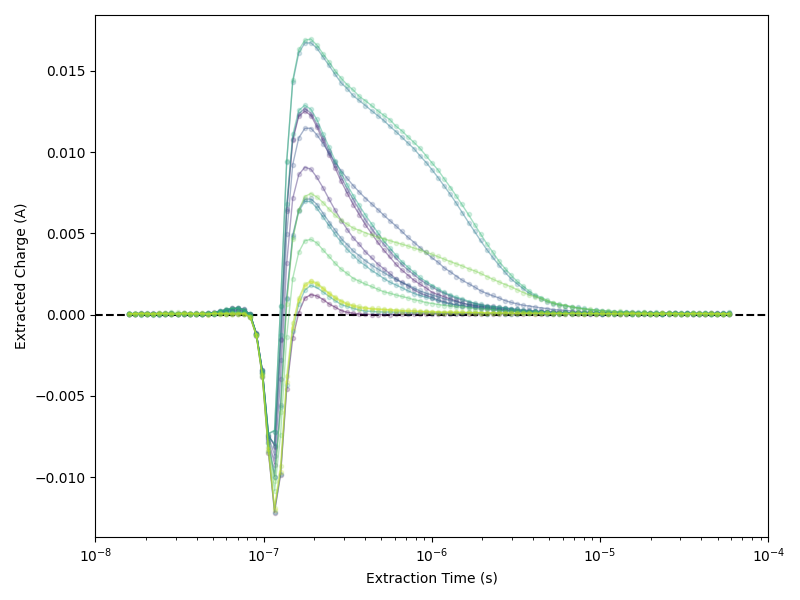

(150, 70, 1) (150, 70, 1)
150 (70, 1) (70, 1)


In [13]:
# configure initial state here.


# dictionary of hyper params
dataset = {
    'trajs': None,
    'times': None,
    'y': None,
    'cut_zero': True # whether to delete all data before t=0
}

dataset_PV = {
    'elec_df': r'C:\Users\z5183876\Documents\GitHub\PV-syst-data\Bomen\data_from_server\2021_elec_df.pkl'
    }

model_params = {
    # hyper params

    
    'nhidden': 128,
    'rnn_nhidden': 32,
    'obs_dim': 1,

    'latent_dim': 16,
    'lr': 1e-2,
    'n_batch': 16,
    'beta': 4,

    'optim': None,
    'device': None,
    'func': None,
    'rec': None,
    'dec': None,

    # training params
    'total_epochs_train': 4,
    'epochs_per_train': 2,
    'epochs': 0, # a record of the epochs
    'loss': 0, # loss = KL_loss + MSE loss
    'loss_thresh': 500,
    'MSE_loss': 0,
    'KL_loss': 0,

    #labels
    'name': "default",
    'desc': "default run",
    'folder': "saves"
}

amp = 2
freq = 1
adaptive_training = {
    # change the training parameters during the training procedure, all lists has to have the same length.
    # 'lr': np.logspace(-2, -3, 20),
    'lr': np.logspace(-2.7, -4, 20),
    # 'lr': np.linspace(2e-3, 1e-4, 20),
    'beta': amp*np.sin(np.linspace(0, 5/2*np.pi, 20)) + 2,
    'epochs': [50]*20
}

dataloader(dataset)
trajs = dataset['trajs']

obs_dim = trajs[0].size()[1]
model_params['obs_dim'] = obs_dim
# latent_dim, nhidden, rnn_nhidden, obs_dim, lr, n_batch, beta = get_hyper_params(trajs)
# model_params = get_hyper_params(dataset, model_params)
# # func, rec, dec, optim, device, loss, epochs = init_model(latent_dim, nhidden, rnn_nhidden, obs_dim, n_batch, lr)
# model_params = init_model(model_params)
# training_loop(func, rec, dec, optim, trajs, times, n_batch, device, beta)

#clear saves folder
# clear_saves()

# 3.Vanilla way of running code

## 3.1. Execute adaptive training

The adaptive training parameters are: {'lr': array([0.00199526, 0.00170443, 0.00145599, 0.00124376, 0.00106247,
       0.0009076 , 0.00077531, 0.0006623 , 0.00056576, 0.00048329,
       0.00041285, 0.00035267, 0.00030126, 0.00025735, 0.00021984,
       0.0001878 , 0.00016042, 0.00013704, 0.00011706, 0.0001    ]), 'beta': array([0.        , 0.21052632, 0.42105263, 0.63157895, 0.84210526,
       1.05263158, 1.26315789, 1.47368421, 1.68421053, 1.89473684,
       2.10526316, 2.31578947, 2.52631579, 2.73684211, 2.94736842,
       3.15789474, 3.36842105, 3.57894737, 3.78947368, 4.        ]), 'epochs': [50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50]}
intialising model on device: cpu


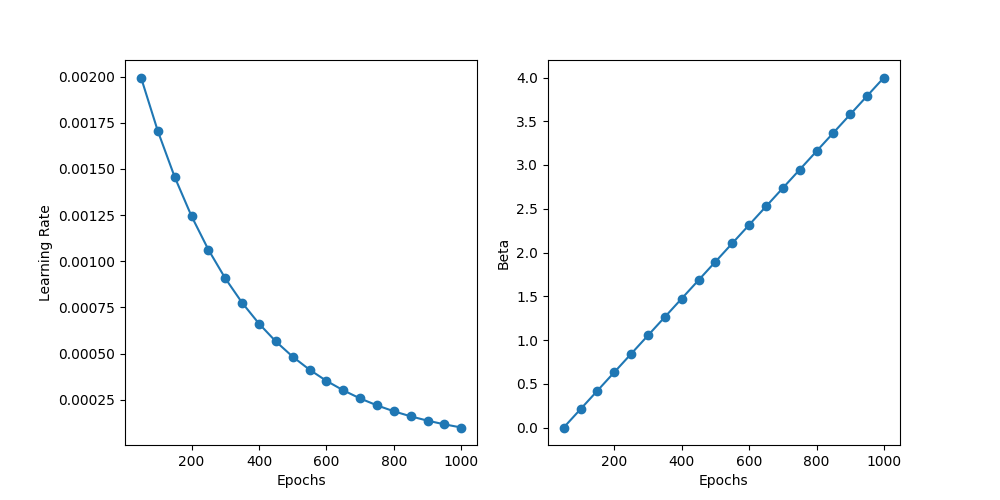

Epoch 1: Total Loss 75812.367, KL Loss 2.53, Feat. Loss 75812.37
Epoch 1: Total Loss 157506.703, KL Loss 3.29, Feat. Loss 157506.70
Epoch 1: Total Loss 127704.844, KL Loss 3.37, Feat. Loss 127704.84
Epoch 1: Total Loss 95800.680, KL Loss 3.41, Feat. Loss 95800.68
Epoch 1: Total Loss 100026.016, KL Loss 4.15, Feat. Loss 100026.02
Epoch 1: Total Loss 84375.289, KL Loss 4.77, Feat. Loss 84375.29
Epoch 1: Total Loss 82962.984, KL Loss 4.78, Feat. Loss 82962.98
Epoch 1: Total Loss 64752.664, KL Loss 5.63, Feat. Loss 64752.66
Epoch 1: Total Loss 118637.914, KL Loss 6.33, Feat. Loss 118637.91
Epoch 1 : 6050.53, 5987.54
Epoch 2: Total Loss 36832.648, KL Loss 6.47, Feat. Loss 36832.65
Epoch 2: Total Loss 117475.250, KL Loss 8.67, Feat. Loss 117475.25
Epoch 2: Total Loss 103200.891, KL Loss 9.39, Feat. Loss 103200.89
Epoch 2: Total Loss 71352.156, KL Loss 9.82, Feat. Loss 71352.16
Epoch 2: Total Loss 75897.438, KL Loss 11.27, Feat. Loss 75897.44
Epoch 2: Total Loss 85197.266, KL Loss 12.90, Feat

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


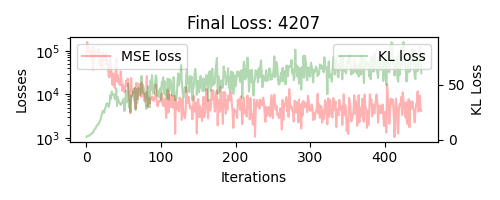

./saves/adaptive_run_default_20240314-092943/*.png
image_arrays shape: (1, 1200, 2100, 4)


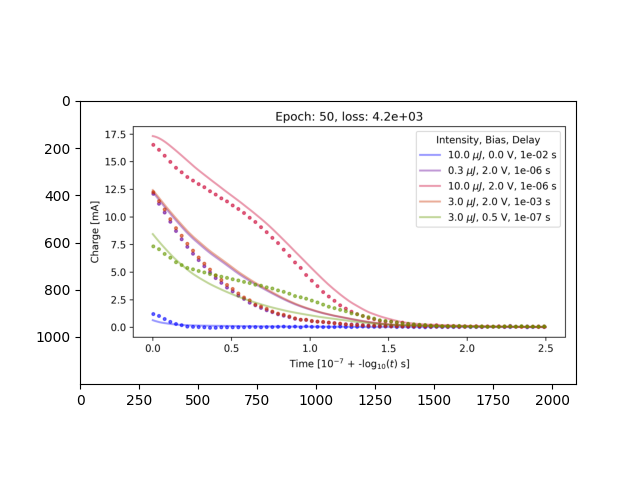

Epoch 1: Total Loss 7863.510, KL Loss 71.44, Feat. Loss 7848.47
Epoch 1: Total Loss 2023.338, KL Loss 62.73, Feat. Loss 2010.13
Epoch 1: Total Loss 3055.898, KL Loss 73.11, Feat. Loss 3040.51
Epoch 1: Total Loss 8679.665, KL Loss 65.12, Feat. Loss 8665.95
Epoch 1: Total Loss 5247.303, KL Loss 62.58, Feat. Loss 5234.13
Epoch 1: Total Loss 6150.644, KL Loss 66.41, Feat. Loss 6136.66
Epoch 1: Total Loss 3903.222, KL Loss 69.16, Feat. Loss 3888.66
Epoch 1: Total Loss 4402.333, KL Loss 69.64, Feat. Loss 4387.67
Epoch 1: Total Loss 4071.829, KL Loss 74.37, Feat. Loss 4056.17
Epoch 1 : 302.65, 275.15
Epoch 2: Total Loss 2516.089, KL Loss 68.03, Feat. Loss 2501.77
Epoch 2: Total Loss 4475.595, KL Loss 78.18, Feat. Loss 4459.13
Epoch 2: Total Loss 4665.084, KL Loss 84.47, Feat. Loss 4647.30
Epoch 2: Total Loss 2054.259, KL Loss 61.08, Feat. Loss 2041.40
Epoch 2: Total Loss 2124.195, KL Loss 68.40, Feat. Loss 2109.79
Epoch 2: Total Loss 7238.407, KL Loss 70.49, Feat. Loss 7223.57
Epoch 2: Total 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


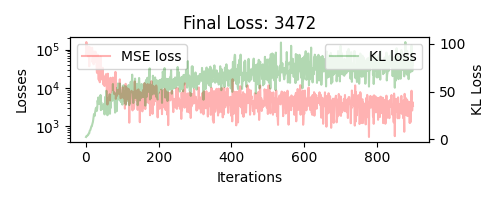

./saves/adaptive_run_default_20240314-092943/*.png
image_arrays shape: (2, 1200, 2100, 4)


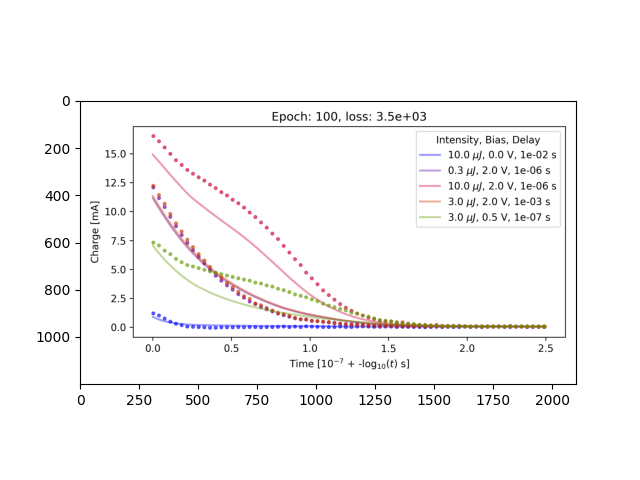

Epoch 1: Total Loss 4702.412, KL Loss 68.43, Feat. Loss 4673.60
Epoch 1: Total Loss 4738.869, KL Loss 85.35, Feat. Loss 4702.93
Epoch 1: Total Loss 899.787, KL Loss 61.57, Feat. Loss 873.86
Epoch 1: Total Loss 10873.763, KL Loss 77.06, Feat. Loss 10841.32
Epoch 1: Total Loss 5609.607, KL Loss 81.91, Feat. Loss 5575.12
Epoch 1: Total Loss 4245.932, KL Loss 81.55, Feat. Loss 4211.59
Epoch 1: Total Loss 5106.093, KL Loss 81.94, Feat. Loss 5071.59
Epoch 1: Total Loss 3978.515, KL Loss 88.97, Feat. Loss 3941.05
Epoch 1: Total Loss 4428.976, KL Loss 83.51, Feat. Loss 4393.82
Epoch 1 : 297.23, 293.90
Epoch 2: Total Loss 2076.198, KL Loss 84.45, Feat. Loss 2040.64
Epoch 2: Total Loss 2107.347, KL Loss 81.30, Feat. Loss 2073.11
Epoch 2: Total Loss 4510.867, KL Loss 85.46, Feat. Loss 4474.89
Epoch 2: Total Loss 1956.067, KL Loss 85.72, Feat. Loss 1919.98
Epoch 2: Total Loss 3214.983, KL Loss 72.26, Feat. Loss 3184.56
Epoch 2: Total Loss 9175.242, KL Loss 80.04, Feat. Loss 9141.54
Epoch 2: Total 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


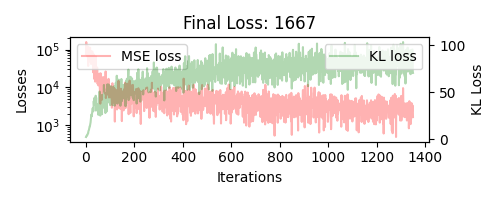

./saves/adaptive_run_default_20240314-092943/*.png
image_arrays shape: (3, 1200, 2100, 4)


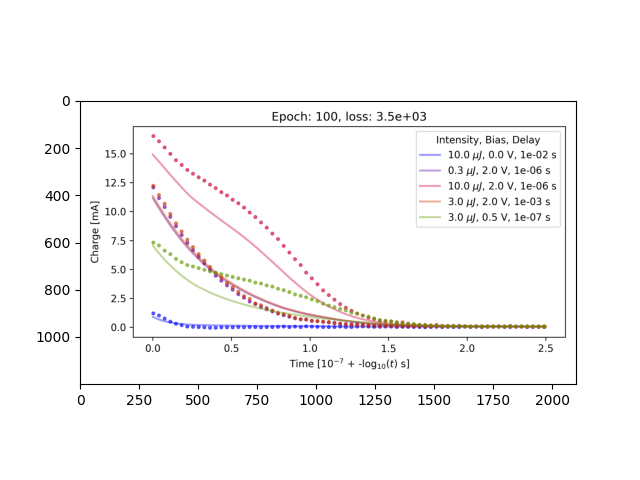

Epoch 1: Total Loss 2272.431, KL Loss 83.07, Feat. Loss 2219.96
Epoch 1: Total Loss 1969.355, KL Loss 84.47, Feat. Loss 1916.00
Epoch 1: Total Loss 1637.441, KL Loss 79.84, Feat. Loss 1587.02
Epoch 1: Total Loss 3389.774, KL Loss 84.27, Feat. Loss 3336.55
Epoch 1: Total Loss 2758.696, KL Loss 83.94, Feat. Loss 2705.68
Epoch 1: Total Loss 1777.513, KL Loss 77.51, Feat. Loss 1728.56
Epoch 1: Total Loss 940.983, KL Loss 87.62, Feat. Loss 885.64
Epoch 1: Total Loss 2785.421, KL Loss 68.06, Feat. Loss 2742.43
Epoch 1: Total Loss 4121.116, KL Loss 84.62, Feat. Loss 4067.67
Epoch 1 : 144.35, 142.03
Epoch 2: Total Loss 2541.839, KL Loss 74.32, Feat. Loss 2494.90
Epoch 2: Total Loss 1226.378, KL Loss 76.98, Feat. Loss 1177.76
Epoch 2: Total Loss 3135.398, KL Loss 87.37, Feat. Loss 3080.21
Epoch 2: Total Loss 2714.798, KL Loss 80.84, Feat. Loss 2663.74
Epoch 2: Total Loss 3525.559, KL Loss 100.49, Feat. Loss 3462.09
Epoch 2: Total Loss 1466.551, KL Loss 80.69, Feat. Loss 1415.59
Epoch 2: Total L

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


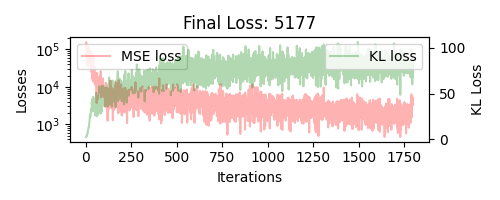

./saves/adaptive_run_default_20240314-092943/*.png
image_arrays shape: (4, 1200, 2100, 4)


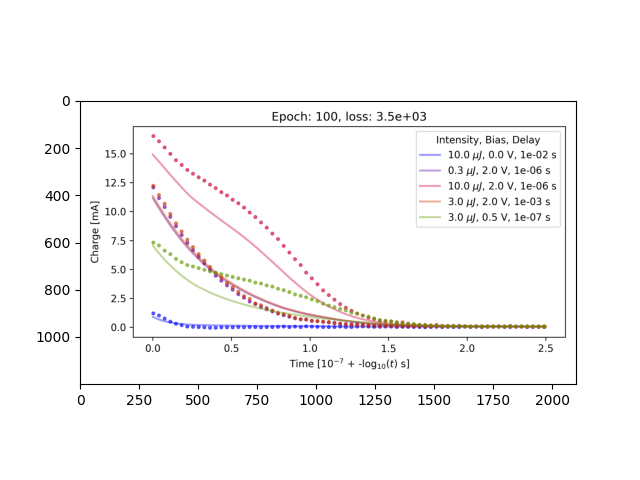

Epoch 1: Total Loss 5737.997, KL Loss 96.80, Feat. Loss 5656.48
Epoch 1: Total Loss 2505.693, KL Loss 86.77, Feat. Loss 2432.62
Epoch 1: Total Loss 3187.157, KL Loss 82.45, Feat. Loss 3117.72
Epoch 1: Total Loss 2479.287, KL Loss 73.91, Feat. Loss 2417.05
Epoch 1: Total Loss 2856.885, KL Loss 75.08, Feat. Loss 2793.66
Epoch 1: Total Loss 3172.440, KL Loss 72.85, Feat. Loss 3111.09
Epoch 1: Total Loss 3982.847, KL Loss 94.77, Feat. Loss 3903.04
Epoch 1: Total Loss 1631.073, KL Loss 78.85, Feat. Loss 1564.67
Epoch 1: Total Loss 3119.950, KL Loss 99.87, Feat. Loss 3035.85
Epoch 1 : 191.16, 195.00
Epoch 2: Total Loss 4115.388, KL Loss 102.86, Feat. Loss 4028.77
Epoch 2: Total Loss 1967.690, KL Loss 71.59, Feat. Loss 1907.40
Epoch 2: Total Loss 1592.020, KL Loss 80.22, Feat. Loss 1524.47
Epoch 2: Total Loss 2980.502, KL Loss 91.14, Feat. Loss 2903.76
Epoch 2: Total Loss 4262.925, KL Loss 97.07, Feat. Loss 4181.18
Epoch 2: Total Loss 2176.366, KL Loss 77.16, Feat. Loss 2111.39
Epoch 2: Total

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


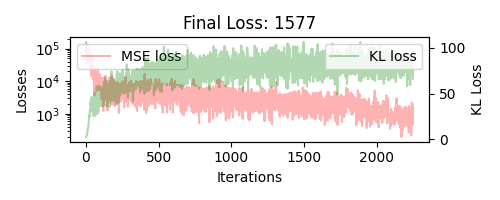

./saves/adaptive_run_default_20240314-092943/*.png
image_arrays shape: (5, 1200, 2100, 4)


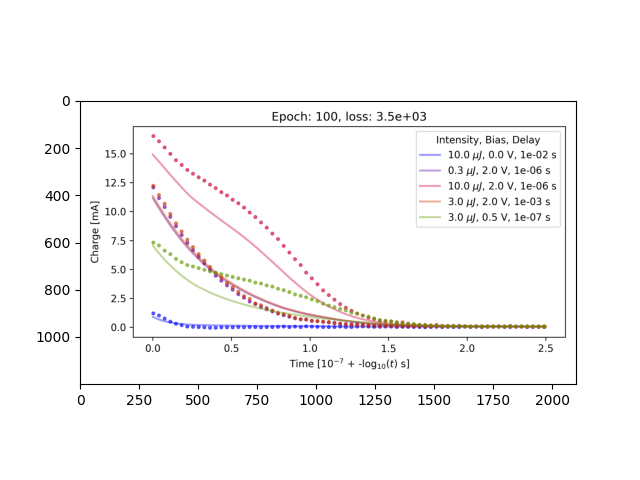

Epoch 1: Total Loss 3443.500, KL Loss 82.12, Feat. Loss 3357.06
Epoch 1: Total Loss 2354.311, KL Loss 87.40, Feat. Loss 2262.31
Epoch 1: Total Loss 2735.353, KL Loss 63.49, Feat. Loss 2668.52
Epoch 1: Total Loss 902.278, KL Loss 72.28, Feat. Loss 826.20
Epoch 1: Total Loss 1384.861, KL Loss 97.50, Feat. Loss 1282.23
Epoch 1: Total Loss 829.707, KL Loss 75.99, Feat. Loss 749.71
Epoch 1: Total Loss 2774.789, KL Loss 69.54, Feat. Loss 2701.59
Epoch 1: Total Loss 1629.976, KL Loss 64.68, Feat. Loss 1561.90
Epoch 1: Total Loss 801.569, KL Loss 87.56, Feat. Loss 709.40
Epoch 1 : 112.38, 101.87
Epoch 2: Total Loss 1930.123, KL Loss 91.91, Feat. Loss 1833.37
Epoch 2: Total Loss 1707.014, KL Loss 89.82, Feat. Loss 1612.47
Epoch 2: Total Loss 3293.554, KL Loss 69.08, Feat. Loss 3220.84
Epoch 2: Total Loss 2034.290, KL Loss 93.41, Feat. Loss 1935.97
Epoch 2: Total Loss 899.865, KL Loss 73.19, Feat. Loss 822.83
Epoch 2: Total Loss 666.700, KL Loss 85.89, Feat. Loss 576.29
Epoch 2: Total Loss 1303.

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


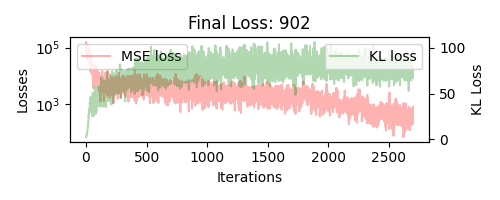

./saves/adaptive_run_default_20240314-092943/*.png
image_arrays shape: (6, 1200, 2100, 4)


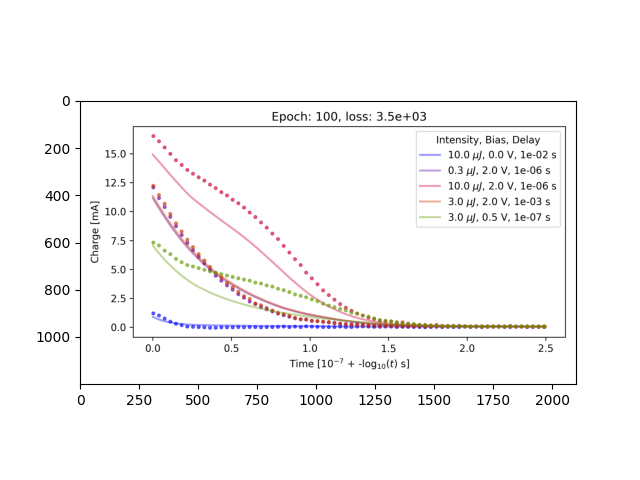

Epoch 1: Total Loss 217.358, KL Loss 77.49, Feat. Loss 119.48
Epoch 1: Total Loss 640.570, KL Loss 86.94, Feat. Loss 530.75
Epoch 1: Total Loss 469.056, KL Loss 74.02, Feat. Loss 375.56
Epoch 1: Total Loss 395.712, KL Loss 69.37, Feat. Loss 308.08
Epoch 1: Total Loss 204.974, KL Loss 55.27, Feat. Loss 135.16
Epoch 1: Total Loss 253.002, KL Loss 75.86, Feat. Loss 157.17
Epoch 1: Total Loss 362.619, KL Loss 67.32, Feat. Loss 277.58
Epoch 1: Total Loss 244.277, KL Loss 83.44, Feat. Loss 138.88
Epoch 1: Total Loss 385.341, KL Loss 68.39, Feat. Loss 298.96
Epoch 1 : 21.15, 22.66
Epoch 2: Total Loss 836.635, KL Loss 90.51, Feat. Loss 722.31
Epoch 2: Total Loss 261.043, KL Loss 55.86, Feat. Loss 190.49
Epoch 2: Total Loss 358.251, KL Loss 74.23, Feat. Loss 264.49
Epoch 2: Total Loss 1844.260, KL Loss 82.09, Feat. Loss 1740.57
Epoch 2: Total Loss 379.680, KL Loss 71.82, Feat. Loss 288.96
Epoch 2: Total Loss 218.860, KL Loss 66.53, Feat. Loss 134.82
Epoch 2: Total Loss 904.265, KL Loss 79.56, F

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


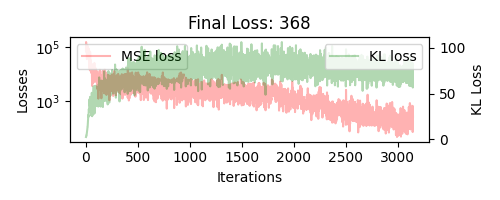

./saves/adaptive_run_default_20240314-092943/*.png
image_arrays shape: (7, 1200, 2100, 4)


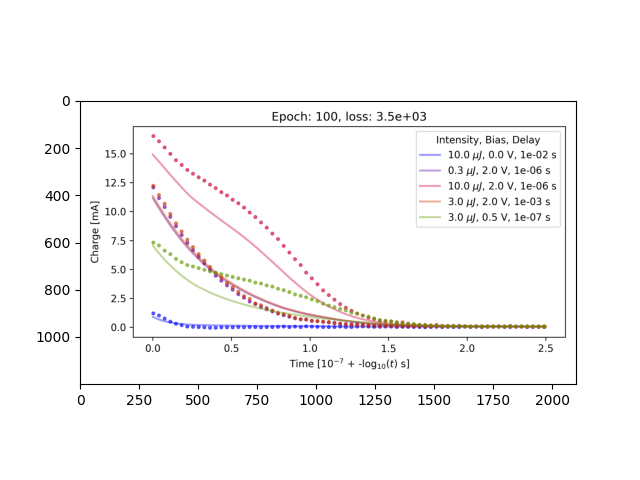

Training is done
The adaptive training parameters are: {'lr': array([0.00199526, 0.00170443, 0.00145599, 0.00124376, 0.00106247,
       0.0009076 , 0.00077531, 0.0006623 , 0.00056576, 0.00048329,
       0.00041285, 0.00035267, 0.00030126, 0.00025735, 0.00021984,
       0.0001878 , 0.00016042, 0.00013704, 0.00011706, 0.0001    ]), 'beta': array([0.        , 0.21052632, 0.42105263, 0.63157895, 0.84210526,
       1.05263158, 1.26315789, 1.47368421, 1.68421053, 1.89473684,
       2.10526316, 2.31578947, 2.52631579, 2.73684211, 2.94736842,
       3.15789474, 3.36842105, 3.57894737, 3.78947368, 4.        ]), 'epochs': [50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50]}
intialising model on device: cpu


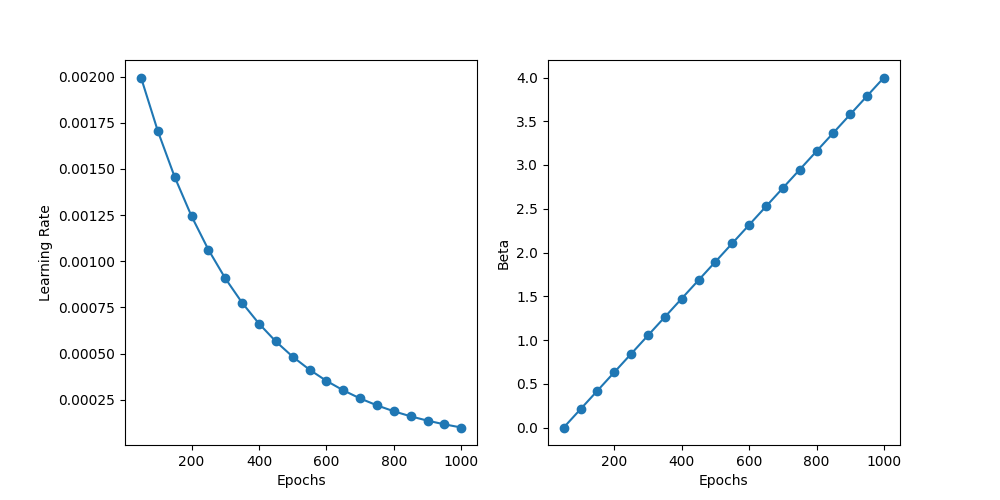

Epoch 1: Total Loss 59912.328, KL Loss 3.41, Feat. Loss 59912.33
Epoch 1: Total Loss 154113.953, KL Loss 3.50, Feat. Loss 154113.95
Epoch 1: Total Loss 91559.367, KL Loss 3.24, Feat. Loss 91559.37
Epoch 1: Total Loss 79516.258, KL Loss 3.56, Feat. Loss 79516.26
Epoch 1: Total Loss 85446.055, KL Loss 3.73, Feat. Loss 85446.05
Epoch 1: Total Loss 100125.234, KL Loss 4.12, Feat. Loss 100125.23
Epoch 1: Total Loss 114641.680, KL Loss 4.26, Feat. Loss 114641.68
Epoch 1: Total Loss 109286.125, KL Loss 5.01, Feat. Loss 109286.12
Epoch 1: Total Loss 122335.312, KL Loss 5.57, Feat. Loss 122335.31
Epoch 1 : 6112.91, 6257.83
Epoch 2: Total Loss 72470.789, KL Loss 6.22, Feat. Loss 72470.79
Epoch 2: Total Loss 129962.578, KL Loss 6.67, Feat. Loss 129962.58
Epoch 2: Total Loss 74990.820, KL Loss 7.74, Feat. Loss 74990.82
Epoch 2: Total Loss 126583.859, KL Loss 8.34, Feat. Loss 126583.86
Epoch 2: Total Loss 119401.086, KL Loss 9.01, Feat. Loss 119401.09
Epoch 2: Total Loss 62456.996, KL Loss 10.34, F

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


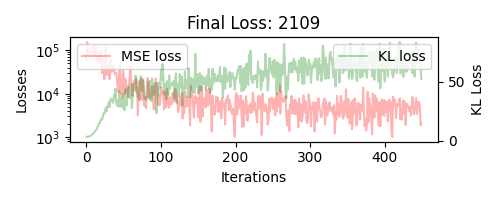

./saves/adaptive_run_default_20240314-095142/*.png
image_arrays shape: (1, 1200, 2100, 4)


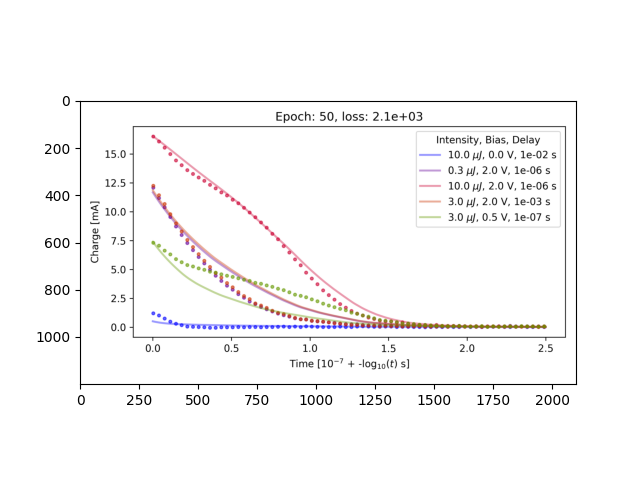

Epoch 1: Total Loss 4865.940, KL Loss 67.65, Feat. Loss 4851.70
Epoch 1: Total Loss 2022.546, KL Loss 56.68, Feat. Loss 2010.61
Epoch 1: Total Loss 4064.457, KL Loss 63.14, Feat. Loss 4051.17
Epoch 1: Total Loss 5239.551, KL Loss 60.97, Feat. Loss 5226.71
Epoch 1: Total Loss 6380.237, KL Loss 77.95, Feat. Loss 6363.83
Epoch 1: Total Loss 9359.790, KL Loss 70.90, Feat. Loss 9344.86
Epoch 1: Total Loss 5107.554, KL Loss 62.08, Feat. Loss 5094.48
Epoch 1: Total Loss 2453.620, KL Loss 51.53, Feat. Loss 2442.77
Epoch 1: Total Loss 6161.854, KL Loss 74.13, Feat. Loss 6146.25
Epoch 1 : 304.37, 319.22
Epoch 2: Total Loss 3610.661, KL Loss 62.98, Feat. Loss 3597.40
Epoch 2: Total Loss 7399.712, KL Loss 73.40, Feat. Loss 7384.26
Epoch 2: Total Loss 9647.040, KL Loss 71.53, Feat. Loss 9631.98
Epoch 2: Total Loss 6923.107, KL Loss 85.61, Feat. Loss 6905.08
Epoch 2: Total Loss 1915.930, KL Loss 53.21, Feat. Loss 1904.73
Epoch 2: Total Loss 919.109, KL Loss 71.68, Feat. Loss 904.02
Epoch 2: Total Lo

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


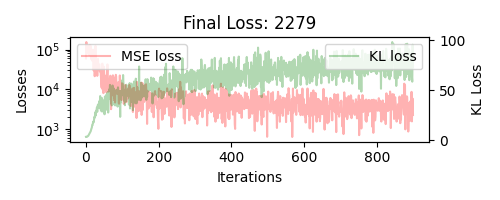

./saves/adaptive_run_default_20240314-095142/*.png
image_arrays shape: (2, 1200, 2100, 4)


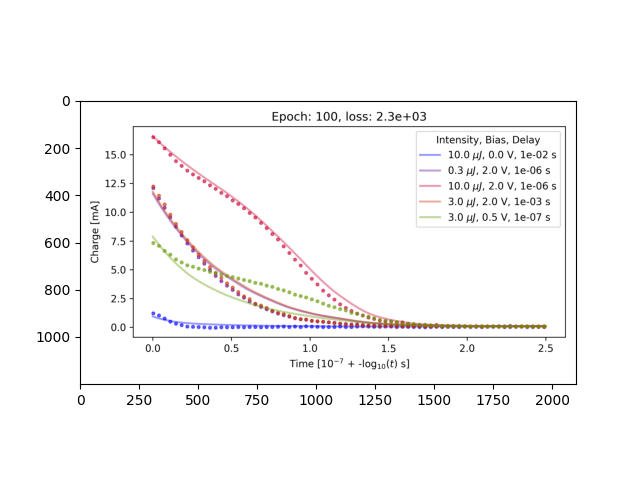

Epoch 1: Total Loss 860.202, KL Loss 68.34, Feat. Loss 831.43
Epoch 1: Total Loss 5521.105, KL Loss 84.73, Feat. Loss 5485.43
Epoch 1: Total Loss 4390.216, KL Loss 65.95, Feat. Loss 4362.45
Epoch 1: Total Loss 4884.331, KL Loss 77.75, Feat. Loss 4851.60
Epoch 1: Total Loss 3290.630, KL Loss 92.16, Feat. Loss 3251.83
Epoch 1: Total Loss 4580.996, KL Loss 86.54, Feat. Loss 4544.56
Epoch 1: Total Loss 3777.260, KL Loss 69.97, Feat. Loss 3747.80
Epoch 1: Total Loss 4066.445, KL Loss 70.41, Feat. Loss 4036.80
Epoch 1: Total Loss 2689.909, KL Loss 80.47, Feat. Loss 2656.03
Epoch 1 : 227.07, 254.15
Epoch 2: Total Loss 1573.286, KL Loss 69.42, Feat. Loss 1544.05
Epoch 2: Total Loss 4027.460, KL Loss 63.23, Feat. Loss 4000.84
Epoch 2: Total Loss 5372.279, KL Loss 91.48, Feat. Loss 5333.76
Epoch 2: Total Loss 2102.494, KL Loss 65.12, Feat. Loss 2075.07
Epoch 2: Total Loss 3744.075, KL Loss 76.96, Feat. Loss 3711.67
Epoch 2: Total Loss 3529.930, KL Loss 68.22, Feat. Loss 3501.21
Epoch 2: Total Lo

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


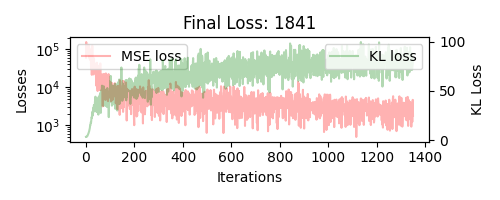

./saves/adaptive_run_default_20240314-095142/*.png
image_arrays shape: (3, 1200, 2100, 4)


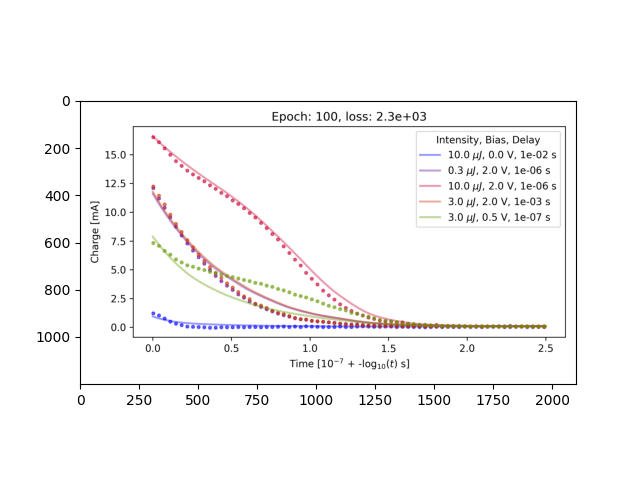

Epoch 1: Total Loss 1598.404, KL Loss 77.86, Feat. Loss 1549.23
Epoch 1: Total Loss 2525.823, KL Loss 76.88, Feat. Loss 2477.27
Epoch 1: Total Loss 2467.815, KL Loss 63.20, Feat. Loss 2427.90
Epoch 1: Total Loss 2990.433, KL Loss 92.63, Feat. Loss 2931.93
Epoch 1: Total Loss 3038.242, KL Loss 84.00, Feat. Loss 2985.19
Epoch 1: Total Loss 1982.844, KL Loss 73.84, Feat. Loss 1936.21
Epoch 1: Total Loss 1870.678, KL Loss 71.60, Feat. Loss 1825.45
Epoch 1: Total Loss 2323.141, KL Loss 83.60, Feat. Loss 2270.34
Epoch 1: Total Loss 3157.889, KL Loss 85.30, Feat. Loss 3104.01
Epoch 1 : 146.37, 154.24
Epoch 2: Total Loss 4980.455, KL Loss 79.80, Feat. Loss 4930.06
Epoch 2: Total Loss 4005.354, KL Loss 85.02, Feat. Loss 3951.66
Epoch 2: Total Loss 657.262, KL Loss 60.65, Feat. Loss 618.95
Epoch 2: Total Loss 1898.293, KL Loss 73.22, Feat. Loss 1852.05
Epoch 2: Total Loss 1770.434, KL Loss 78.53, Feat. Loss 1720.84
Epoch 2: Total Loss 1514.675, KL Loss 87.14, Feat. Loss 1459.64
Epoch 2: Total Lo

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


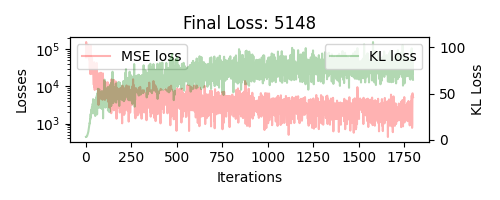

./saves/adaptive_run_default_20240314-095142/*.png
image_arrays shape: (4, 1200, 2100, 4)


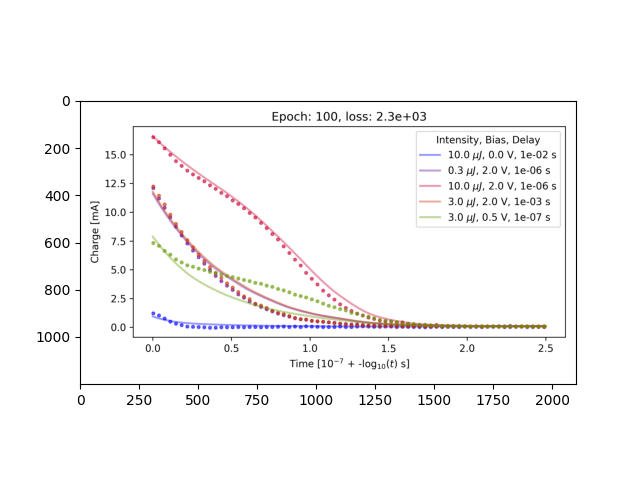

Epoch 1: Total Loss 1961.911, KL Loss 74.83, Feat. Loss 1898.89
Epoch 1: Total Loss 4458.714, KL Loss 79.17, Feat. Loss 4392.05
Epoch 1: Total Loss 3932.994, KL Loss 70.42, Feat. Loss 3873.69
Epoch 1: Total Loss 2897.195, KL Loss 79.29, Feat. Loss 2830.43
Epoch 1: Total Loss 5391.083, KL Loss 71.23, Feat. Loss 5331.10
Epoch 1: Total Loss 4696.566, KL Loss 78.17, Feat. Loss 4630.74
Epoch 1: Total Loss 2232.537, KL Loss 85.06, Feat. Loss 2160.91
Epoch 1: Total Loss 4092.377, KL Loss 84.31, Feat. Loss 4021.38
Epoch 1: Total Loss 1729.635, KL Loss 69.05, Feat. Loss 1671.48
Epoch 1 : 209.29, 245.81
Epoch 2: Total Loss 2875.583, KL Loss 65.88, Feat. Loss 2820.11
Epoch 2: Total Loss 4992.687, KL Loss 70.18, Feat. Loss 4933.59
Epoch 2: Total Loss 2856.034, KL Loss 72.56, Feat. Loss 2794.93
Epoch 2: Total Loss 3161.146, KL Loss 91.89, Feat. Loss 3083.76
Epoch 2: Total Loss 2239.434, KL Loss 63.44, Feat. Loss 2186.01
Epoch 2: Total Loss 2891.560, KL Loss 78.35, Feat. Loss 2825.58
Epoch 2: Total 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


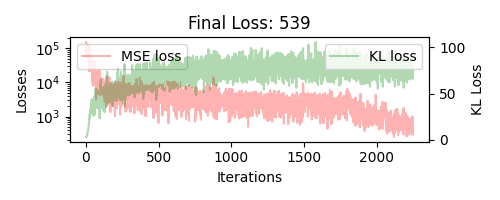

./saves/adaptive_run_default_20240314-095142/*.png
image_arrays shape: (5, 1200, 2100, 4)


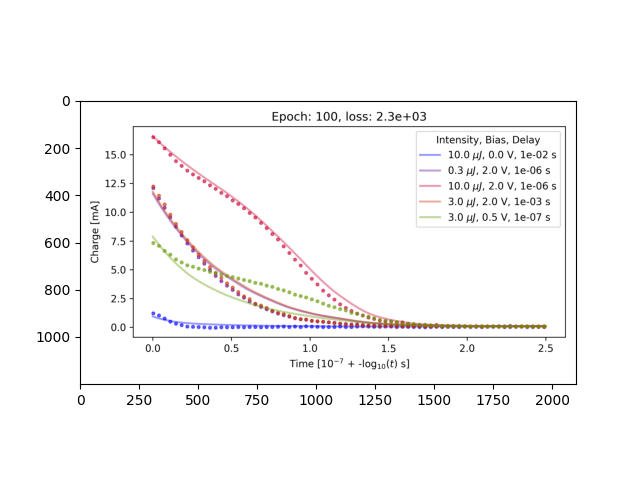

Epoch 1: Total Loss 958.985, KL Loss 90.87, Feat. Loss 863.33
Epoch 1: Total Loss 492.963, KL Loss 71.26, Feat. Loss 417.96
Epoch 1: Total Loss 524.307, KL Loss 69.02, Feat. Loss 451.66
Epoch 1: Total Loss 505.756, KL Loss 79.42, Feat. Loss 422.16
Epoch 1: Total Loss 787.731, KL Loss 85.63, Feat. Loss 697.60
Epoch 1: Total Loss 454.124, KL Loss 69.44, Feat. Loss 381.03
Epoch 1: Total Loss 628.239, KL Loss 60.76, Feat. Loss 564.28
Epoch 1: Total Loss 686.527, KL Loss 71.57, Feat. Loss 611.19
Epoch 1: Total Loss 602.295, KL Loss 76.45, Feat. Loss 521.82
Epoch 1 : 37.61, 37.64
Epoch 2: Total Loss 536.150, KL Loss 73.87, Feat. Loss 458.39
Epoch 2: Total Loss 826.527, KL Loss 76.46, Feat. Loss 746.04
Epoch 2: Total Loss 795.836, KL Loss 85.24, Feat. Loss 706.11
Epoch 2: Total Loss 387.010, KL Loss 79.46, Feat. Loss 303.37
Epoch 2: Total Loss 651.772, KL Loss 68.02, Feat. Loss 580.17
Epoch 2: Total Loss 261.232, KL Loss 71.48, Feat. Loss 185.99
Epoch 2: Total Loss 449.206, KL Loss 67.20, Fea

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


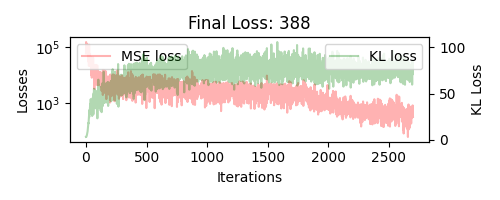

./saves/adaptive_run_default_20240314-095142/*.png
image_arrays shape: (6, 1200, 2100, 4)


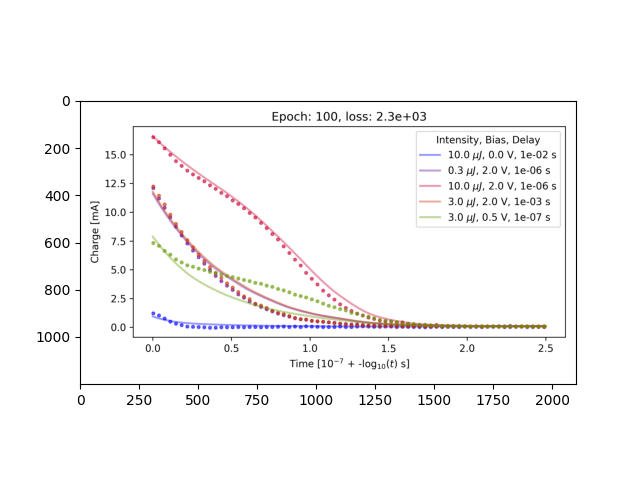

Training is done
The adaptive training parameters are: {'lr': array([0.00199526, 0.00170443, 0.00145599, 0.00124376, 0.00106247,
       0.0009076 , 0.00077531, 0.0006623 , 0.00056576, 0.00048329,
       0.00041285, 0.00035267, 0.00030126, 0.00025735, 0.00021984,
       0.0001878 , 0.00016042, 0.00013704, 0.00011706, 0.0001    ]), 'beta': array([0.        , 0.21052632, 0.42105263, 0.63157895, 0.84210526,
       1.05263158, 1.26315789, 1.47368421, 1.68421053, 1.89473684,
       2.10526316, 2.31578947, 2.52631579, 2.73684211, 2.94736842,
       3.15789474, 3.36842105, 3.57894737, 3.78947368, 4.        ]), 'epochs': [50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50]}
intialising model on device: cpu


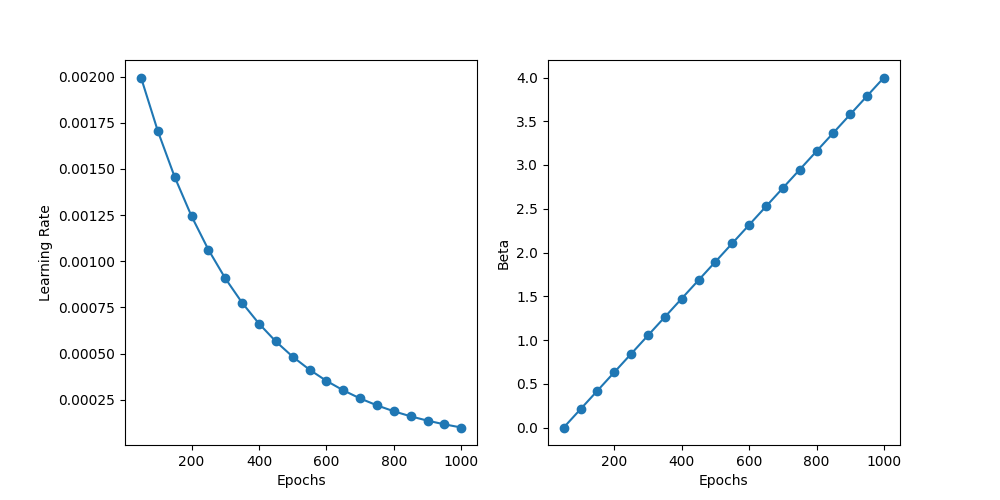

Epoch 1: Total Loss 95161.609, KL Loss 3.64, Feat. Loss 95161.61
Epoch 1: Total Loss 70477.867, KL Loss 3.21, Feat. Loss 70477.87
Epoch 1: Total Loss 106239.062, KL Loss 3.20, Feat. Loss 106239.06
Epoch 1: Total Loss 97363.438, KL Loss 3.38, Feat. Loss 97363.44
Epoch 1: Total Loss 74101.383, KL Loss 3.20, Feat. Loss 74101.38
Epoch 1: Total Loss 136188.984, KL Loss 4.13, Feat. Loss 136188.98
Epoch 1: Total Loss 168199.547, KL Loss 4.54, Feat. Loss 168199.55
Epoch 1: Total Loss 83007.398, KL Loss 4.69, Feat. Loss 83007.40
Epoch 1: Total Loss 63869.184, KL Loss 5.21, Feat. Loss 63869.18
Epoch 1 : 5964.06, 5947.60
Epoch 2: Total Loss 98873.477, KL Loss 6.37, Feat. Loss 98873.48
Epoch 2: Total Loss 87252.875, KL Loss 6.63, Feat. Loss 87252.88
Epoch 2: Total Loss 140918.578, KL Loss 7.54, Feat. Loss 140918.58
Epoch 2: Total Loss 61906.762, KL Loss 7.53, Feat. Loss 61906.76
Epoch 2: Total Loss 98429.188, KL Loss 9.59, Feat. Loss 98429.19
Epoch 2: Total Loss 69529.883, KL Loss 9.80, Feat. Loss

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


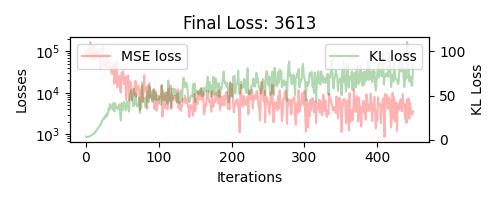

./saves/adaptive_run_default_20240314-101113/*.png
image_arrays shape: (1, 1200, 2100, 4)


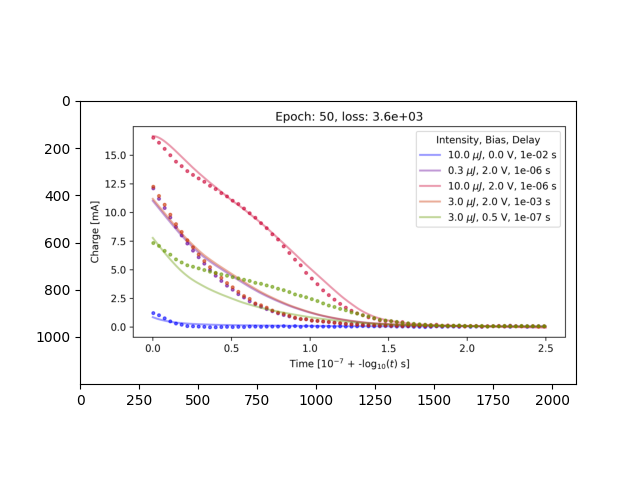

Epoch 1: Total Loss 4279.370, KL Loss 73.16, Feat. Loss 4263.97
Epoch 1: Total Loss 1783.557, KL Loss 72.18, Feat. Loss 1768.36
Epoch 1: Total Loss 8418.671, KL Loss 78.28, Feat. Loss 8402.19
Epoch 1: Total Loss 4053.242, KL Loss 81.82, Feat. Loss 4036.02
Epoch 1: Total Loss 1586.745, KL Loss 78.23, Feat. Loss 1570.28
Epoch 1: Total Loss 3779.654, KL Loss 91.53, Feat. Loss 3760.38
Epoch 1: Total Loss 6758.908, KL Loss 64.76, Feat. Loss 6745.27
Epoch 1: Total Loss 4355.586, KL Loss 78.51, Feat. Loss 4339.06
Epoch 1: Total Loss 5114.940, KL Loss 80.32, Feat. Loss 5098.03
Epoch 1 : 267.54, 267.46
Epoch 2: Total Loss 4690.944, KL Loss 84.84, Feat. Loss 4673.08
Epoch 2: Total Loss 4000.900, KL Loss 72.70, Feat. Loss 3985.59
Epoch 2: Total Loss 2267.037, KL Loss 76.92, Feat. Loss 2250.84
Epoch 2: Total Loss 4374.401, KL Loss 94.61, Feat. Loss 4354.48
Epoch 2: Total Loss 4228.919, KL Loss 68.37, Feat. Loss 4214.53
Epoch 2: Total Loss 6962.590, KL Loss 73.89, Feat. Loss 6947.03
Epoch 2: Total 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


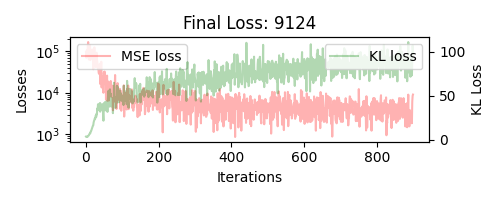

./saves/adaptive_run_default_20240314-101113/*.png
image_arrays shape: (2, 1200, 2100, 4)


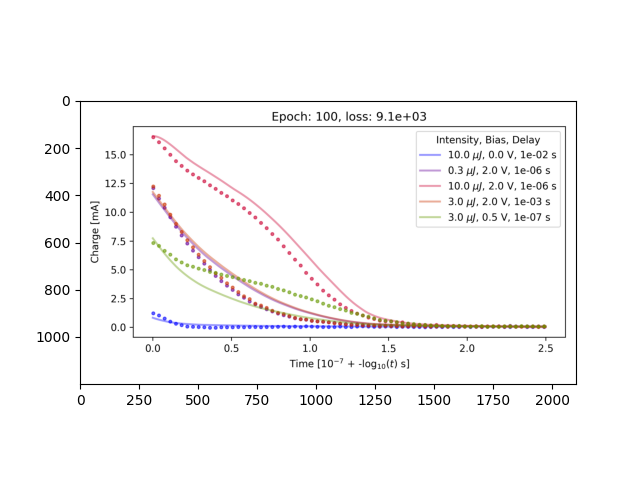

Epoch 1: Total Loss 4988.981, KL Loss 98.29, Feat. Loss 4947.60
Epoch 1: Total Loss 3725.038, KL Loss 83.18, Feat. Loss 3690.01
Epoch 1: Total Loss 2816.943, KL Loss 84.60, Feat. Loss 2781.32
Epoch 1: Total Loss 8840.161, KL Loss 99.41, Feat. Loss 8798.30
Epoch 1: Total Loss 2666.373, KL Loss 92.00, Feat. Loss 2627.64
Epoch 1: Total Loss 3177.328, KL Loss 80.76, Feat. Loss 3143.32
Epoch 1: Total Loss 1582.316, KL Loss 85.62, Feat. Loss 1546.27
Epoch 1: Total Loss 2302.506, KL Loss 87.56, Feat. Loss 2265.64
Epoch 1: Total Loss 1878.770, KL Loss 74.92, Feat. Loss 1847.23
Epoch 1 : 213.19, 176.06
Epoch 2: Total Loss 3530.640, KL Loss 80.73, Feat. Loss 3496.65
Epoch 2: Total Loss 4605.171, KL Loss 90.62, Feat. Loss 4567.01
Epoch 2: Total Loss 3740.513, KL Loss 91.50, Feat. Loss 3701.99
Epoch 2: Total Loss 8475.702, KL Loss 90.38, Feat. Loss 8437.65
Epoch 2: Total Loss 1886.594, KL Loss 75.80, Feat. Loss 1854.68
Epoch 2: Total Loss 3141.162, KL Loss 94.00, Feat. Loss 3101.58
Epoch 2: Total 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


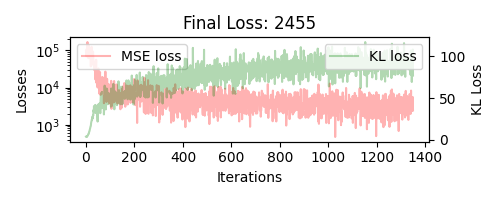

./saves/adaptive_run_default_20240314-101113/*.png
image_arrays shape: (3, 1200, 2100, 4)


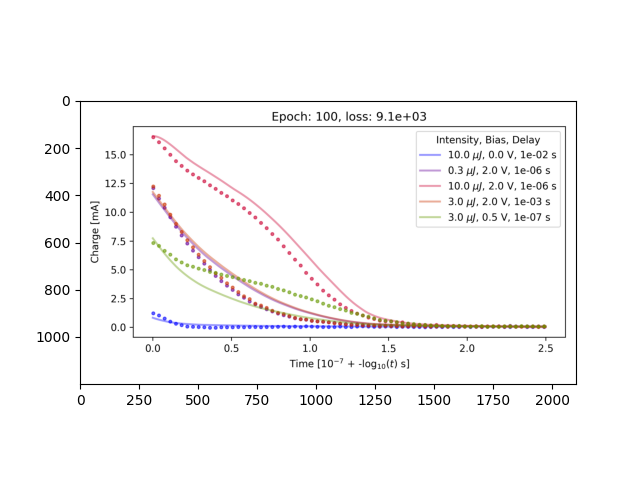

Epoch 1: Total Loss 1596.080, KL Loss 95.23, Feat. Loss 1535.94
Epoch 1: Total Loss 3353.057, KL Loss 114.47, Feat. Loss 3280.76
Epoch 1: Total Loss 2390.738, KL Loss 82.27, Feat. Loss 2338.78
Epoch 1: Total Loss 2961.710, KL Loss 95.35, Feat. Loss 2901.49
Epoch 1: Total Loss 2545.981, KL Loss 110.19, Feat. Loss 2476.39
Epoch 1: Total Loss 3307.004, KL Loss 86.03, Feat. Loss 3252.67
Epoch 1: Total Loss 2261.775, KL Loss 94.13, Feat. Loss 2202.33
Epoch 1: Total Loss 1633.539, KL Loss 75.53, Feat. Loss 1585.84
Epoch 1: Total Loss 7066.938, KL Loss 96.00, Feat. Loss 7006.31
Epoch 1 : 180.78, 159.12
Epoch 2: Total Loss 4355.700, KL Loss 117.61, Feat. Loss 4281.42
Epoch 2: Total Loss 3101.752, KL Loss 88.63, Feat. Loss 3045.77
Epoch 2: Total Loss 4669.634, KL Loss 96.26, Feat. Loss 4608.84
Epoch 2: Total Loss 2145.889, KL Loss 75.26, Feat. Loss 2098.35
Epoch 2: Total Loss 4394.589, KL Loss 93.56, Feat. Loss 4335.50
Epoch 2: Total Loss 2752.466, KL Loss 109.36, Feat. Loss 2683.40
Epoch 2: To

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


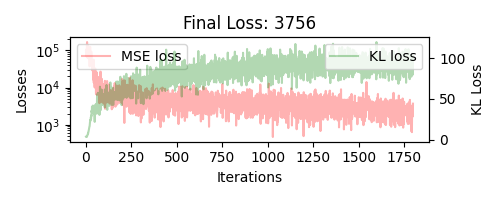

./saves/adaptive_run_default_20240314-101113/*.png
image_arrays shape: (4, 1200, 2100, 4)


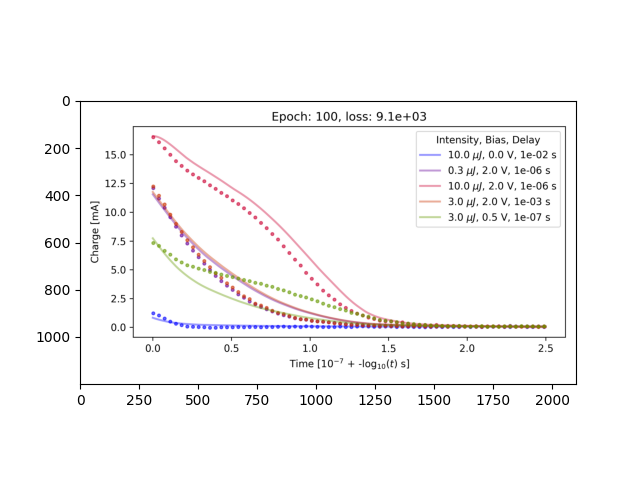

Epoch 1: Total Loss 2949.021, KL Loss 68.62, Feat. Loss 2891.23
Epoch 1: Total Loss 1291.042, KL Loss 94.84, Feat. Loss 1211.17
Epoch 1: Total Loss 1046.496, KL Loss 101.44, Feat. Loss 961.08
Epoch 1: Total Loss 1059.212, KL Loss 89.56, Feat. Loss 983.79
Epoch 1: Total Loss 2471.721, KL Loss 97.96, Feat. Loss 2389.23
Epoch 1: Total Loss 889.726, KL Loss 100.59, Feat. Loss 805.02
Epoch 1: Total Loss 4166.130, KL Loss 92.93, Feat. Loss 4087.87
Epoch 1: Total Loss 2677.820, KL Loss 94.18, Feat. Loss 2598.51
Epoch 1: Total Loss 2626.136, KL Loss 88.18, Feat. Loss 2551.88
Epoch 1 : 127.85, 154.48
Epoch 2: Total Loss 2404.994, KL Loss 86.55, Feat. Loss 2332.11
Epoch 2: Total Loss 3330.964, KL Loss 94.90, Feat. Loss 3251.05
Epoch 2: Total Loss 1429.959, KL Loss 94.86, Feat. Loss 1350.08
Epoch 2: Total Loss 3728.179, KL Loss 105.25, Feat. Loss 3639.55
Epoch 2: Total Loss 2295.373, KL Loss 96.02, Feat. Loss 2214.51
Epoch 2: Total Loss 983.947, KL Loss 94.22, Feat. Loss 904.60
Epoch 2: Total Los

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


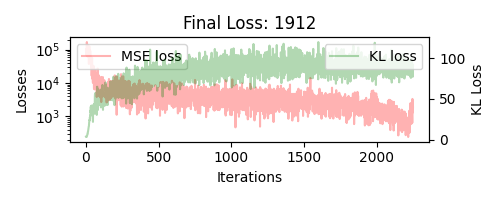

./saves/adaptive_run_default_20240314-101113/*.png
image_arrays shape: (5, 1200, 2100, 4)


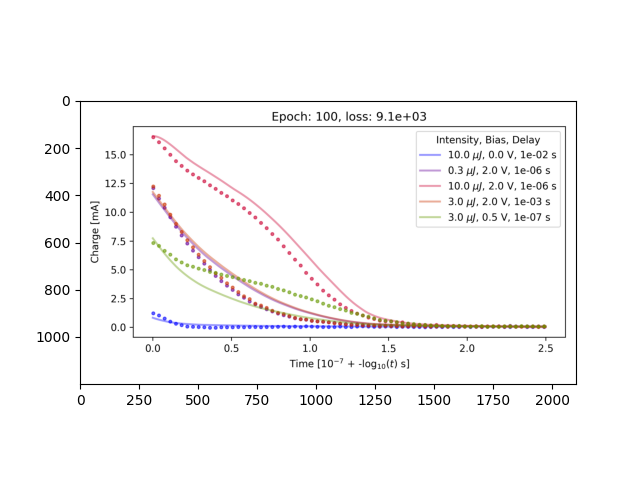

Epoch 1: Total Loss 950.124, KL Loss 88.90, Feat. Loss 856.54
Epoch 1: Total Loss 719.543, KL Loss 91.62, Feat. Loss 623.10
Epoch 1: Total Loss 1023.499, KL Loss 87.65, Feat. Loss 931.24
Epoch 1: Total Loss 901.609, KL Loss 80.03, Feat. Loss 817.36
Epoch 1: Total Loss 491.696, KL Loss 81.10, Feat. Loss 406.33
Epoch 1: Total Loss 1197.506, KL Loss 84.83, Feat. Loss 1108.21
Epoch 1: Total Loss 1236.793, KL Loss 81.29, Feat. Loss 1151.23
Epoch 1: Total Loss 1400.866, KL Loss 83.60, Feat. Loss 1312.87
Epoch 1: Total Loss 2413.169, KL Loss 91.98, Feat. Loss 2316.35
Epoch 1 : 68.90, 63.97
Epoch 2: Total Loss 544.118, KL Loss 71.90, Feat. Loss 468.43
Epoch 2: Total Loss 1175.061, KL Loss 99.03, Feat. Loss 1070.82
Epoch 2: Total Loss 741.566, KL Loss 86.73, Feat. Loss 650.27
Epoch 2: Total Loss 999.266, KL Loss 92.57, Feat. Loss 901.82
Epoch 2: Total Loss 899.312, KL Loss 83.20, Feat. Loss 811.73
Epoch 2: Total Loss 773.733, KL Loss 80.51, Feat. Loss 688.98
Epoch 2: Total Loss 1018.839, KL Los

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


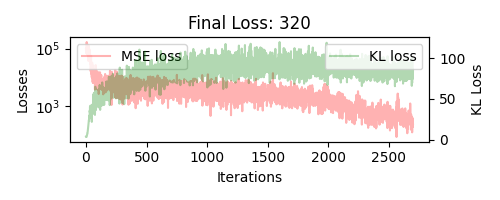

./saves/adaptive_run_default_20240314-101113/*.png
image_arrays shape: (6, 1200, 2100, 4)


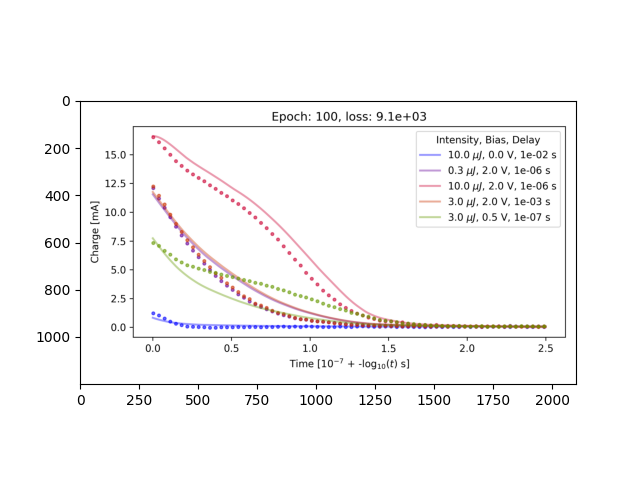

Training is done
The adaptive training parameters are: {'lr': array([0.00199526, 0.00170443, 0.00145599, 0.00124376, 0.00106247,
       0.0009076 , 0.00077531, 0.0006623 , 0.00056576, 0.00048329,
       0.00041285, 0.00035267, 0.00030126, 0.00025735, 0.00021984,
       0.0001878 , 0.00016042, 0.00013704, 0.00011706, 0.0001    ]), 'beta': array([4.        , 3.78947368, 3.57894737, 3.36842105, 3.15789474,
       2.94736842, 2.73684211, 2.52631579, 2.31578947, 2.10526316,
       1.89473684, 1.68421053, 1.47368421, 1.26315789, 1.05263158,
       0.84210526, 0.63157895, 0.42105263, 0.21052632, 0.        ]), 'epochs': [50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50]}
intialising model on device: cpu


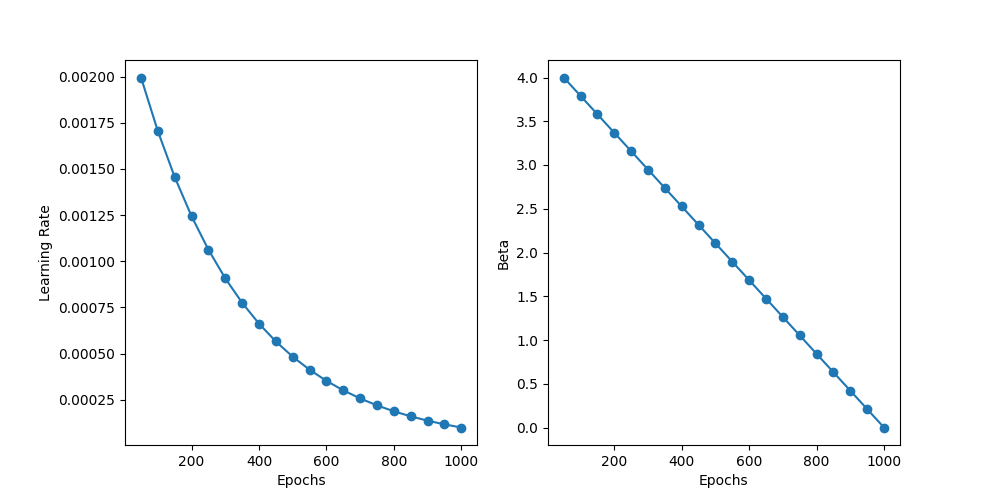

Epoch 1: Total Loss 117003.406, KL Loss 5.22, Feat. Loss 116982.52
Epoch 1: Total Loss 101998.578, KL Loss 4.79, Feat. Loss 101979.40
Epoch 1: Total Loss 133326.156, KL Loss 4.59, Feat. Loss 133307.78
Epoch 1: Total Loss 57084.305, KL Loss 4.25, Feat. Loss 57067.32
Epoch 1: Total Loss 158433.016, KL Loss 4.93, Feat. Loss 158413.28
Epoch 1: Total Loss 81405.367, KL Loss 5.41, Feat. Loss 81383.73
Epoch 1: Total Loss 59814.277, KL Loss 5.42, Feat. Loss 59792.61
Epoch 1: Total Loss 75519.250, KL Loss 6.32, Feat. Loss 75493.95
Epoch 1: Total Loss 142116.609, KL Loss 7.35, Feat. Loss 142087.22
Epoch 1 : 6178.01, 6374.91
Epoch 2: Total Loss 75104.305, KL Loss 7.66, Feat. Loss 75073.68
Epoch 2: Total Loss 97295.203, KL Loss 8.36, Feat. Loss 97261.75
Epoch 2: Total Loss 151624.516, KL Loss 9.83, Feat. Loss 151585.20
Epoch 2: Total Loss 53531.688, KL Loss 10.28, Feat. Loss 53490.56
Epoch 2: Total Loss 105899.750, KL Loss 11.99, Feat. Loss 105851.81
Epoch 2: Total Loss 65645.062, KL Loss 12.42, F

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


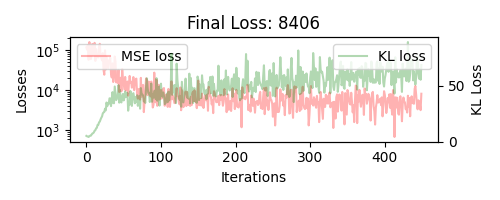

./saves/adaptive_run_default_20240314-102929/*.png
image_arrays shape: (1, 1200, 2100, 4)


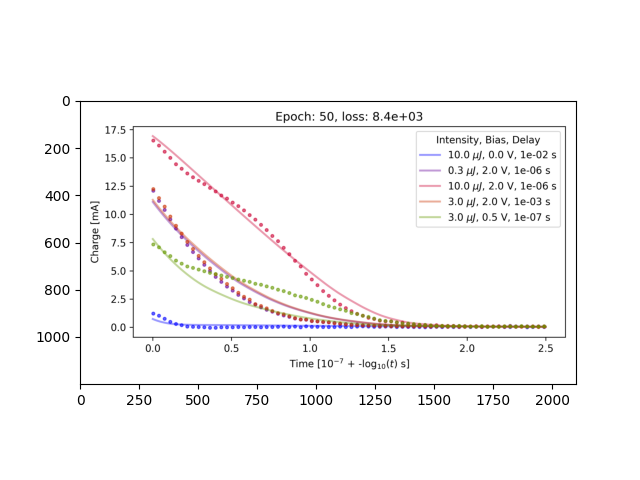

Epoch 1: Total Loss 6609.660, KL Loss 69.10, Feat. Loss 6347.79
Epoch 1: Total Loss 4052.047, KL Loss 70.01, Feat. Loss 3786.75
Epoch 1: Total Loss 3645.418, KL Loss 59.23, Feat. Loss 3420.97
Epoch 1: Total Loss 6122.316, KL Loss 61.72, Feat. Loss 5888.44
Epoch 1: Total Loss 5415.629, KL Loss 58.03, Feat. Loss 5195.73
Epoch 1: Total Loss 5210.189, KL Loss 67.16, Feat. Loss 4955.68
Epoch 1: Total Loss 3014.057, KL Loss 57.97, Feat. Loss 2794.40
Epoch 1: Total Loss 5626.963, KL Loss 53.32, Feat. Loss 5424.92
Epoch 1: Total Loss 1535.005, KL Loss 56.26, Feat. Loss 1321.81
Epoch 1 : 274.88, 325.64
Epoch 2: Total Loss 2347.970, KL Loss 63.29, Feat. Loss 2108.12
Epoch 2: Total Loss 3095.619, KL Loss 62.24, Feat. Loss 2859.75
Epoch 2: Total Loss 5602.051, KL Loss 55.20, Feat. Loss 5392.86
Epoch 2: Total Loss 7078.490, KL Loss 69.35, Feat. Loss 6815.68
Epoch 2: Total Loss 2795.730, KL Loss 52.36, Feat. Loss 2597.30
Epoch 2: Total Loss 5395.874, KL Loss 53.91, Feat. Loss 5191.57
Epoch 2: Total 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


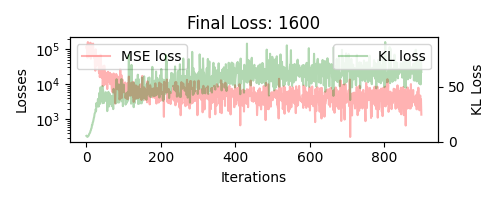

./saves/adaptive_run_default_20240314-102929/*.png
image_arrays shape: (2, 1200, 2100, 4)


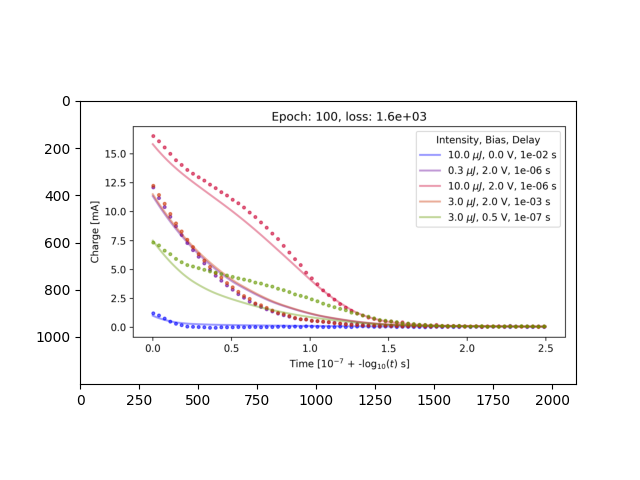

Epoch 1: Total Loss 1061.002, KL Loss 67.80, Feat. Loss 818.36
Epoch 1: Total Loss 6727.840, KL Loss 50.81, Feat. Loss 6545.98
Epoch 1: Total Loss 4448.895, KL Loss 62.21, Feat. Loss 4226.26
Epoch 1: Total Loss 8122.070, KL Loss 60.14, Feat. Loss 7906.83
Epoch 1: Total Loss 6637.605, KL Loss 73.91, Feat. Loss 6373.10
Epoch 1: Total Loss 2962.728, KL Loss 59.68, Feat. Loss 2749.14
Epoch 1: Total Loss 1751.235, KL Loss 62.57, Feat. Loss 1527.30
Epoch 1: Total Loss 3288.195, KL Loss 69.42, Feat. Loss 3039.75
Epoch 1: Total Loss 8270.846, KL Loss 60.82, Feat. Loss 8053.17
Epoch 1 : 288.47, 278.06
Epoch 2: Total Loss 6553.813, KL Loss 74.51, Feat. Loss 6287.13
Epoch 2: Total Loss 5058.895, KL Loss 53.35, Feat. Loss 4867.96
Epoch 2: Total Loss 5999.320, KL Loss 69.83, Feat. Loss 5749.41
Epoch 2: Total Loss 5288.827, KL Loss 65.49, Feat. Loss 5054.44
Epoch 2: Total Loss 3809.328, KL Loss 57.65, Feat. Loss 3603.02
Epoch 2: Total Loss 1926.659, KL Loss 55.97, Feat. Loss 1726.33
Epoch 2: Total L

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


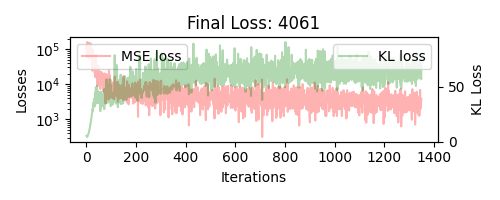

./saves/adaptive_run_default_20240314-102929/*.png
image_arrays shape: (3, 1200, 2100, 4)


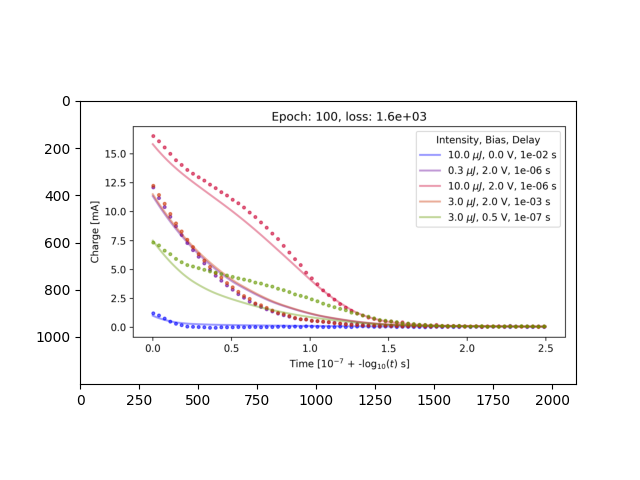

Epoch 1: Total Loss 2519.741, KL Loss 64.94, Feat. Loss 2300.99
Epoch 1: Total Loss 3426.114, KL Loss 61.89, Feat. Loss 3217.64
Epoch 1: Total Loss 3609.962, KL Loss 63.57, Feat. Loss 3395.82
Epoch 1: Total Loss 1442.588, KL Loss 62.32, Feat. Loss 1232.65
Epoch 1: Total Loss 2249.473, KL Loss 57.58, Feat. Loss 2055.51
Epoch 1: Total Loss 2477.866, KL Loss 56.21, Feat. Loss 2288.52
Epoch 1: Total Loss 5225.821, KL Loss 79.08, Feat. Loss 4959.45
Epoch 1: Total Loss 1483.036, KL Loss 61.14, Feat. Loss 1277.08
Epoch 1: Total Loss 3248.651, KL Loss 61.35, Feat. Loss 3042.00
Epoch 1 : 171.22, 157.48
Epoch 2: Total Loss 4267.127, KL Loss 63.59, Feat. Loss 4052.95
Epoch 2: Total Loss 1045.936, KL Loss 52.04, Feat. Loss 870.64
Epoch 2: Total Loss 3024.161, KL Loss 58.86, Feat. Loss 2825.90
Epoch 2: Total Loss 3155.815, KL Loss 60.48, Feat. Loss 2952.11
Epoch 2: Total Loss 2604.630, KL Loss 75.29, Feat. Loss 2351.03
Epoch 2: Total Loss 1932.264, KL Loss 72.42, Feat. Loss 1688.31
Epoch 2: Total L

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


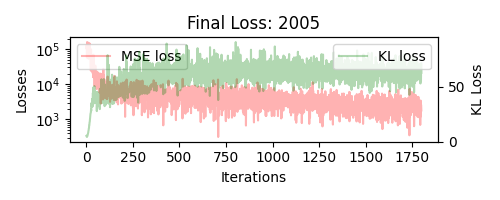

./saves/adaptive_run_default_20240314-102929/*.png
image_arrays shape: (4, 1200, 2100, 4)


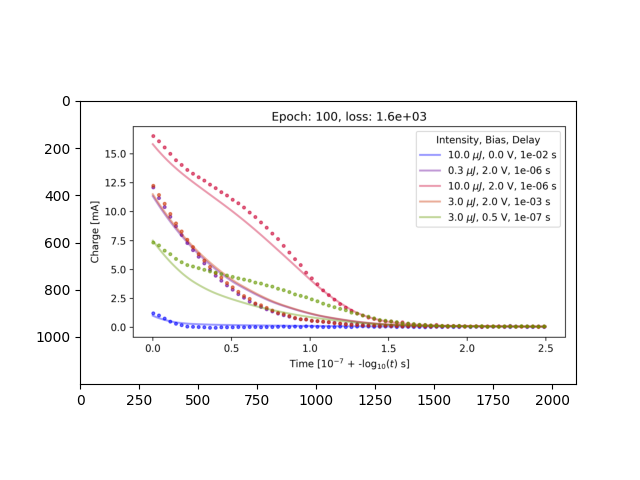

Epoch 1: Total Loss 1464.068, KL Loss 57.81, Feat. Loss 1281.51
Epoch 1: Total Loss 2657.834, KL Loss 61.17, Feat. Loss 2464.67
Epoch 1: Total Loss 2920.757, KL Loss 54.50, Feat. Loss 2748.64
Epoch 1: Total Loss 3446.765, KL Loss 67.94, Feat. Loss 3232.20
Epoch 1: Total Loss 1963.717, KL Loss 69.57, Feat. Loss 1744.02
Epoch 1: Total Loss 613.704, KL Loss 50.07, Feat. Loss 455.60
Epoch 1: Total Loss 4495.567, KL Loss 54.74, Feat. Loss 4322.69
Epoch 1: Total Loss 3082.843, KL Loss 56.16, Feat. Loss 2905.51
Epoch 1: Total Loss 3697.007, KL Loss 71.57, Feat. Loss 3471.00
Epoch 1 : 162.28, 182.55
Epoch 2: Total Loss 6737.200, KL Loss 61.07, Feat. Loss 6544.34
Epoch 2: Total Loss 3004.445, KL Loss 64.67, Feat. Loss 2800.22
Epoch 2: Total Loss 3711.982, KL Loss 53.07, Feat. Loss 3544.39
Epoch 2: Total Loss 2850.409, KL Loss 71.74, Feat. Loss 2623.87
Epoch 2: Total Loss 870.921, KL Loss 50.60, Feat. Loss 711.12
Epoch 2: Total Loss 2797.935, KL Loss 63.58, Feat. Loss 2597.16
Epoch 2: Total Loss

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


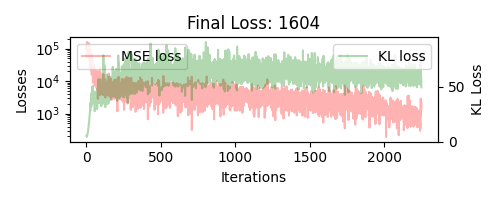

./saves/adaptive_run_default_20240314-102929/*.png
image_arrays shape: (5, 1200, 2100, 4)


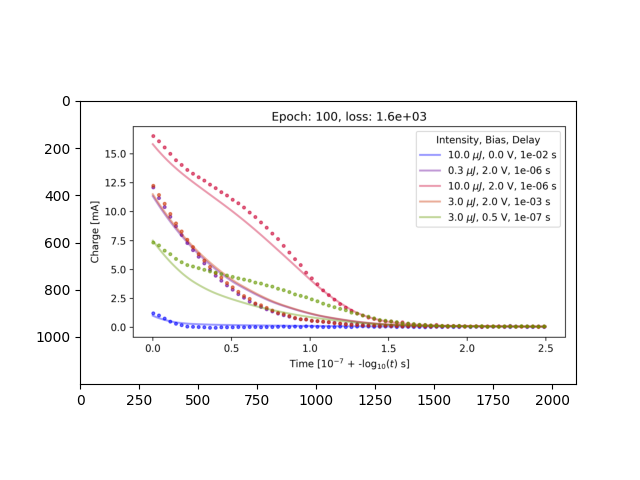

Epoch 1: Total Loss 1136.624, KL Loss 59.62, Feat. Loss 960.91
Epoch 1: Total Loss 1531.174, KL Loss 57.42, Feat. Loss 1361.92
Epoch 1: Total Loss 1710.137, KL Loss 63.09, Feat. Loss 1524.18
Epoch 1: Total Loss 2752.220, KL Loss 74.09, Feat. Loss 2533.86
Epoch 1: Total Loss 619.547, KL Loss 50.89, Feat. Loss 469.54
Epoch 1: Total Loss 3441.714, KL Loss 54.33, Feat. Loss 3281.59
Epoch 1: Total Loss 1806.335, KL Loss 60.10, Feat. Loss 1629.19
Epoch 1: Total Loss 1033.347, KL Loss 52.06, Feat. Loss 879.89
Epoch 1: Total Loss 925.938, KL Loss 63.43, Feat. Loss 739.00
Epoch 1 : 99.71, 95.70
Epoch 2: Total Loss 1571.830, KL Loss 50.81, Feat. Loss 1422.06
Epoch 2: Total Loss 1043.091, KL Loss 63.19, Feat. Loss 856.85
Epoch 2: Total Loss 784.792, KL Loss 55.30, Feat. Loss 621.81
Epoch 2: Total Loss 1679.213, KL Loss 65.95, Feat. Loss 1484.84
Epoch 2: Total Loss 1671.745, KL Loss 63.26, Feat. Loss 1485.28
Epoch 2: Total Loss 1478.063, KL Loss 65.21, Feat. Loss 1285.86
Epoch 2: Total Loss 904.67

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


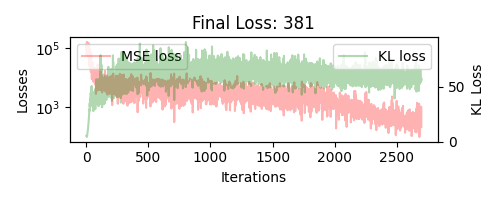

./saves/adaptive_run_default_20240314-102929/*.png
image_arrays shape: (6, 1200, 2100, 4)


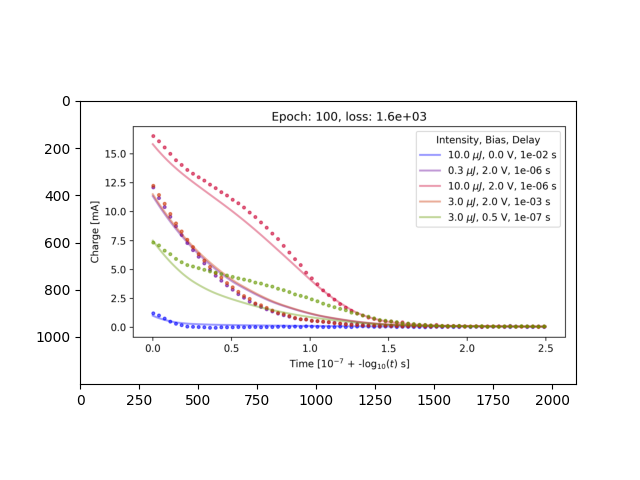

Training is done
The adaptive training parameters are: {'lr': array([0.00199526, 0.00170443, 0.00145599, 0.00124376, 0.00106247,
       0.0009076 , 0.00077531, 0.0006623 , 0.00056576, 0.00048329,
       0.00041285, 0.00035267, 0.00030126, 0.00025735, 0.00021984,
       0.0001878 , 0.00016042, 0.00013704, 0.00011706, 0.0001    ]), 'beta': array([4.        , 3.78947368, 3.57894737, 3.36842105, 3.15789474,
       2.94736842, 2.73684211, 2.52631579, 2.31578947, 2.10526316,
       1.89473684, 1.68421053, 1.47368421, 1.26315789, 1.05263158,
       0.84210526, 0.63157895, 0.42105263, 0.21052632, 0.        ]), 'epochs': [50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50]}
intialising model on device: cpu


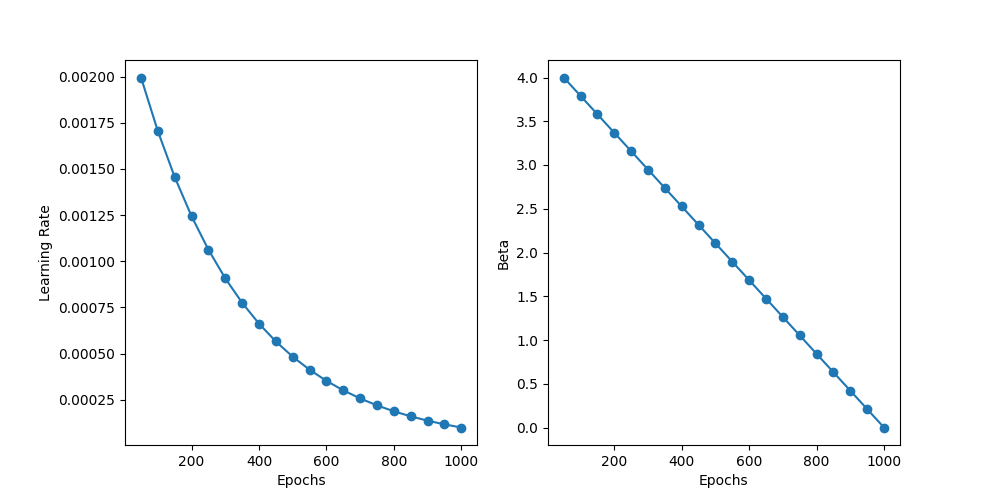

Epoch 1: Total Loss 79827.820, KL Loss 2.96, Feat. Loss 79815.98
Epoch 1: Total Loss 113848.898, KL Loss 3.19, Feat. Loss 113836.13
Epoch 1: Total Loss 95434.422, KL Loss 3.52, Feat. Loss 95420.34
Epoch 1: Total Loss 51422.156, KL Loss 3.77, Feat. Loss 51407.06
Epoch 1: Total Loss 134158.047, KL Loss 4.13, Feat. Loss 134141.53
Epoch 1: Total Loss 138843.641, KL Loss 4.77, Feat. Loss 138824.56
Epoch 1: Total Loss 123134.250, KL Loss 5.23, Feat. Loss 123113.31
Epoch 1: Total Loss 115794.062, KL Loss 6.23, Feat. Loss 115769.13
Epoch 1: Total Loss 58558.258, KL Loss 6.35, Feat. Loss 58532.84
Epoch 1 : 6073.48, 7115.56
Epoch 2: Total Loss 59594.422, KL Loss 7.25, Feat. Loss 59565.42
Epoch 2: Total Loss 107559.109, KL Loss 8.17, Feat. Loss 107526.42
Epoch 2: Total Loss 77330.859, KL Loss 8.80, Feat. Loss 77295.66
Epoch 2: Total Loss 102709.086, KL Loss 9.87, Feat. Loss 102669.62
Epoch 2: Total Loss 87428.242, KL Loss 9.96, Feat. Loss 87388.40
Epoch 2: Total Loss 106520.188, KL Loss 11.30, Fe

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


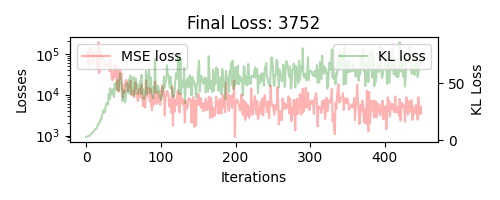

./saves/adaptive_run_default_20240314-105607/*.png
image_arrays shape: (1, 1200, 2100, 4)


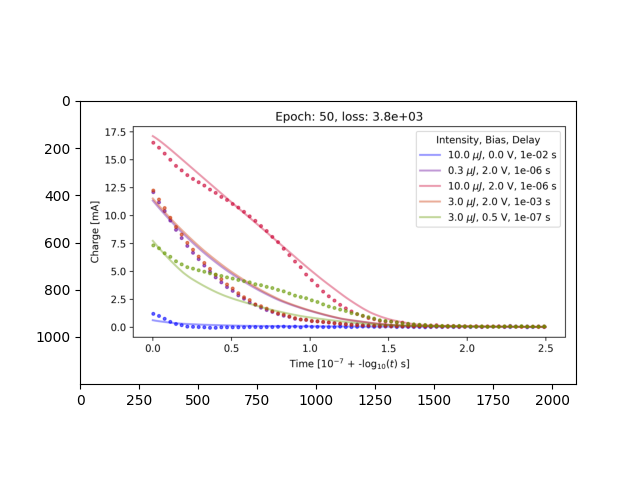

Epoch 1: Total Loss 2061.207, KL Loss 50.99, Feat. Loss 1867.98
Epoch 1: Total Loss 7085.473, KL Loss 56.68, Feat. Loss 6870.68
Epoch 1: Total Loss 2877.384, KL Loss 77.13, Feat. Loss 2585.10
Epoch 1: Total Loss 3065.231, KL Loss 76.51, Feat. Loss 2775.28
Epoch 1: Total Loss 5950.538, KL Loss 70.12, Feat. Loss 5684.81
Epoch 1: Total Loss 8444.281, KL Loss 77.17, Feat. Loss 8151.83
Epoch 1: Total Loss 3055.930, KL Loss 51.34, Feat. Loss 2861.39
Epoch 1: Total Loss 4735.384, KL Loss 57.63, Feat. Loss 4516.99
Epoch 1: Total Loss 11699.941, KL Loss 71.75, Feat. Loss 11428.04
Epoch 1 : 326.50, 295.96
Epoch 2: Total Loss 4610.525, KL Loss 71.37, Feat. Loss 4340.08
Epoch 2: Total Loss 4527.082, KL Loss 66.67, Feat. Loss 4274.43
Epoch 2: Total Loss 4551.483, KL Loss 66.51, Feat. Loss 4299.45
Epoch 2: Total Loss 3171.218, KL Loss 60.14, Feat. Loss 2943.32
Epoch 2: Total Loss 7970.124, KL Loss 67.24, Feat. Loss 7715.31
Epoch 2: Total Loss 4350.478, KL Loss 61.17, Feat. Loss 4118.68
Epoch 2: Tota

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


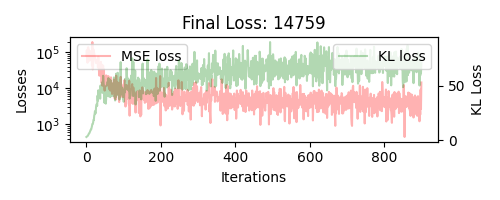

./saves/adaptive_run_default_20240314-105607/*.png
image_arrays shape: (2, 1200, 2100, 4)


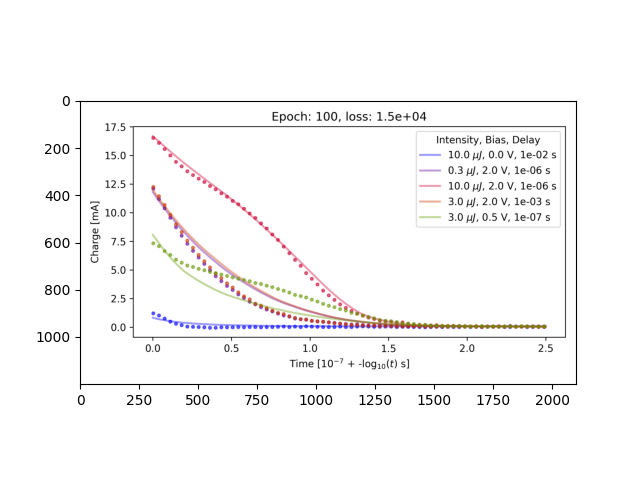

Epoch 1: Total Loss 7486.230, KL Loss 65.34, Feat. Loss 7252.37
Epoch 1: Total Loss 5302.332, KL Loss 67.83, Feat. Loss 5059.59
Epoch 1: Total Loss 4559.514, KL Loss 65.67, Feat. Loss 4324.49
Epoch 1: Total Loss 4482.355, KL Loss 73.47, Feat. Loss 4219.40
Epoch 1: Total Loss 6623.731, KL Loss 74.95, Feat. Loss 6355.49
Epoch 1: Total Loss 6045.532, KL Loss 69.26, Feat. Loss 5797.66
Epoch 1: Total Loss 5312.179, KL Loss 82.63, Feat. Loss 5016.47
Epoch 1: Total Loss 2550.203, KL Loss 63.46, Feat. Loss 2323.07
Epoch 1: Total Loss 3013.754, KL Loss 65.07, Feat. Loss 2780.87
Epoch 1 : 302.51, 331.40
Epoch 2: Total Loss 1285.693, KL Loss 67.40, Feat. Loss 1044.48
Epoch 2: Total Loss 5178.773, KL Loss 67.37, Feat. Loss 4937.66
Epoch 2: Total Loss 7657.106, KL Loss 73.22, Feat. Loss 7395.05
Epoch 2: Total Loss 4441.308, KL Loss 77.40, Feat. Loss 4164.30
Epoch 2: Total Loss 3773.474, KL Loss 61.41, Feat. Loss 3553.69
Epoch 2: Total Loss 3996.588, KL Loss 52.65, Feat. Loss 3808.14
Epoch 2: Total 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


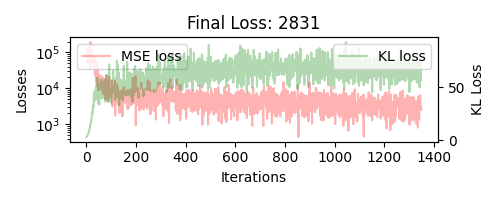

./saves/adaptive_run_default_20240314-105607/*.png
image_arrays shape: (3, 1200, 2100, 4)


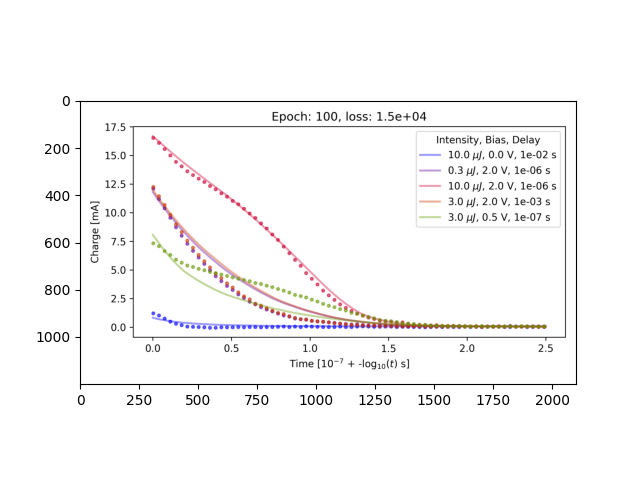

Epoch 1: Total Loss 3207.956, KL Loss 68.48, Feat. Loss 2977.30
Epoch 1: Total Loss 5091.919, KL Loss 64.71, Feat. Loss 4873.96
Epoch 1: Total Loss 3216.223, KL Loss 70.15, Feat. Loss 2979.94
Epoch 1: Total Loss 2544.138, KL Loss 66.63, Feat. Loss 2319.69
Epoch 1: Total Loss 3414.386, KL Loss 52.12, Feat. Loss 3238.83
Epoch 1: Total Loss 3370.893, KL Loss 58.59, Feat. Loss 3173.52
Epoch 1: Total Loss 2442.567, KL Loss 46.97, Feat. Loss 2284.34
Epoch 1: Total Loss 7108.542, KL Loss 81.72, Feat. Loss 6833.27
Epoch 1: Total Loss 1614.188, KL Loss 65.97, Feat. Loss 1391.97
Epoch 1 : 213.41, 201.01
Epoch 2: Total Loss 2625.105, KL Loss 65.53, Feat. Loss 2404.36
Epoch 2: Total Loss 2923.204, KL Loss 58.74, Feat. Loss 2725.34
Epoch 2: Total Loss 3590.456, KL Loss 70.29, Feat. Loss 3353.68
Epoch 2: Total Loss 4692.595, KL Loss 66.38, Feat. Loss 4469.00
Epoch 2: Total Loss 3741.011, KL Loss 56.64, Feat. Loss 3550.23
Epoch 2: Total Loss 2811.457, KL Loss 65.71, Feat. Loss 2590.12
Epoch 2: Total 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


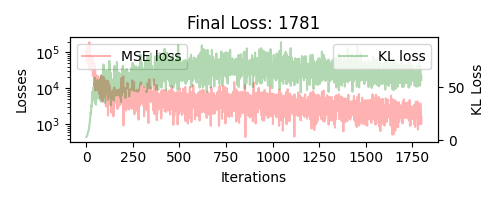

./saves/adaptive_run_default_20240314-105607/*.png
image_arrays shape: (4, 1200, 2100, 4)


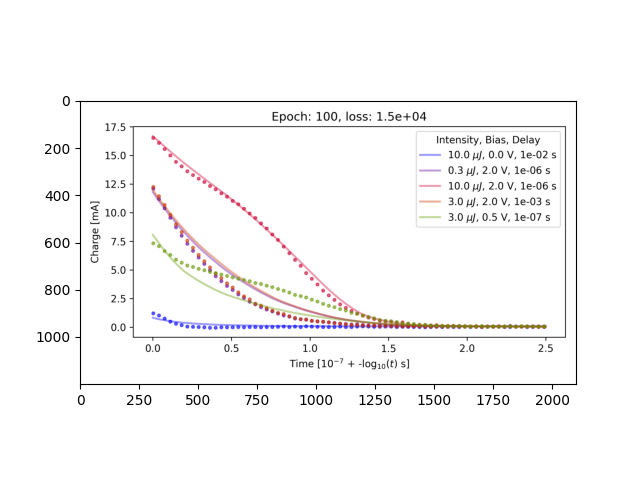

Epoch 1: Total Loss 1940.966, KL Loss 65.87, Feat. Loss 1732.96
Epoch 1: Total Loss 3192.290, KL Loss 61.22, Feat. Loss 2998.96
Epoch 1: Total Loss 1430.847, KL Loss 57.24, Feat. Loss 1250.08
Epoch 1: Total Loss 2619.480, KL Loss 61.25, Feat. Loss 2426.05
Epoch 1: Total Loss 3226.911, KL Loss 65.19, Feat. Loss 3021.05
Epoch 1: Total Loss 827.337, KL Loss 56.56, Feat. Loss 648.73
Epoch 1: Total Loss 2345.302, KL Loss 56.38, Feat. Loss 2167.27
Epoch 1: Total Loss 4059.111, KL Loss 60.55, Feat. Loss 3867.91
Epoch 1: Total Loss 1541.484, KL Loss 58.90, Feat. Loss 1355.50
Epoch 1 : 141.22, 146.58
Epoch 2: Total Loss 4238.485, KL Loss 65.04, Feat. Loss 4033.09
Epoch 2: Total Loss 3215.089, KL Loss 61.95, Feat. Loss 3019.47
Epoch 2: Total Loss 1784.588, KL Loss 55.28, Feat. Loss 1610.02
Epoch 2: Total Loss 1113.087, KL Loss 64.17, Feat. Loss 910.45
Epoch 2: Total Loss 1702.717, KL Loss 62.47, Feat. Loss 1505.43
Epoch 2: Total Loss 1938.749, KL Loss 59.82, Feat. Loss 1749.84
Epoch 2: Total Los

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


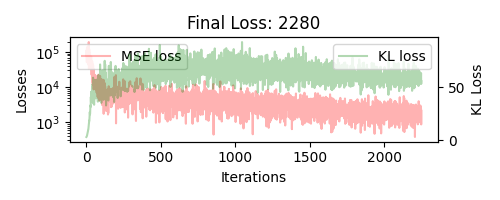

./saves/adaptive_run_default_20240314-105607/*.png
image_arrays shape: (5, 1200, 2100, 4)


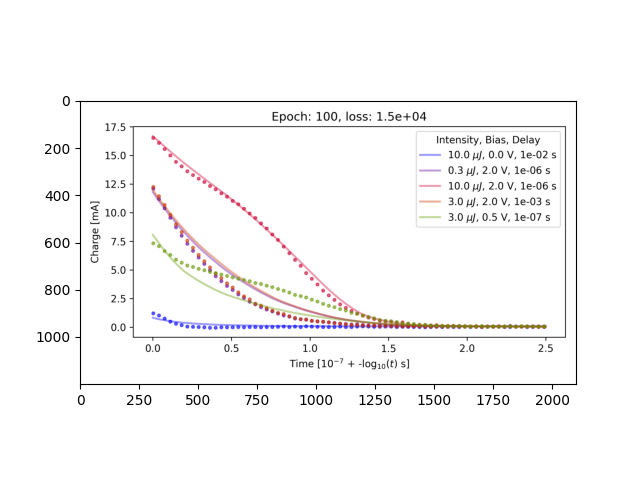

Epoch 1: Total Loss 1978.885, KL Loss 53.42, Feat. Loss 1821.43
Epoch 1: Total Loss 1216.873, KL Loss 66.65, Feat. Loss 1020.44
Epoch 1: Total Loss 1975.550, KL Loss 60.73, Feat. Loss 1796.55
Epoch 1: Total Loss 1911.075, KL Loss 64.31, Feat. Loss 1721.53
Epoch 1: Total Loss 860.374, KL Loss 54.67, Feat. Loss 699.23
Epoch 1: Total Loss 1934.704, KL Loss 55.18, Feat. Loss 1772.07
Epoch 1: Total Loss 2531.915, KL Loss 51.54, Feat. Loss 2380.02
Epoch 1: Total Loss 4613.985, KL Loss 61.56, Feat. Loss 4432.55
Epoch 1: Total Loss 1487.358, KL Loss 54.33, Feat. Loss 1327.24
Epoch 1 : 123.40, 120.92
Epoch 2: Total Loss 1712.770, KL Loss 62.25, Feat. Loss 1529.30
Epoch 2: Total Loss 4688.118, KL Loss 56.92, Feat. Loss 4520.36
Epoch 2: Total Loss 1808.088, KL Loss 61.02, Feat. Loss 1628.23
Epoch 2: Total Loss 1689.575, KL Loss 52.98, Feat. Loss 1533.42
Epoch 2: Total Loss 1416.540, KL Loss 56.44, Feat. Loss 1250.20
Epoch 2: Total Loss 2606.148, KL Loss 68.82, Feat. Loss 2403.30
Epoch 2: Total Lo

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


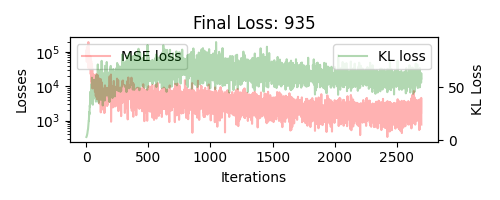

./saves/adaptive_run_default_20240314-105607/*.png
image_arrays shape: (6, 1200, 2100, 4)


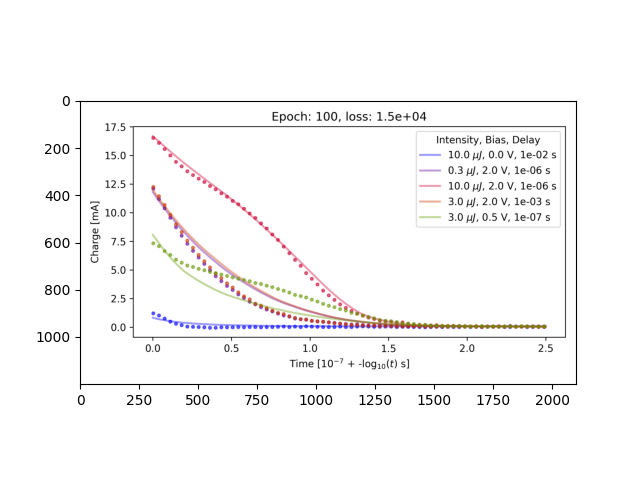

Epoch 1: Total Loss 1328.349, KL Loss 49.23, Feat. Loss 1193.62
Epoch 1: Total Loss 1920.680, KL Loss 64.68, Feat. Loss 1743.66
Epoch 1: Total Loss 1092.077, KL Loss 48.88, Feat. Loss 958.29
Epoch 1: Total Loss 3577.776, KL Loss 59.35, Feat. Loss 3415.35
Epoch 1: Total Loss 902.621, KL Loss 59.35, Feat. Loss 740.20
Epoch 1: Total Loss 2538.265, KL Loss 61.03, Feat. Loss 2371.22
Epoch 1: Total Loss 3128.460, KL Loss 61.65, Feat. Loss 2959.75
Epoch 1: Total Loss 1431.126, KL Loss 53.80, Feat. Loss 1283.88
Epoch 1: Total Loss 2095.347, KL Loss 63.19, Feat. Loss 1922.41
Epoch 1 : 120.10, 120.04
Epoch 2: Total Loss 3040.804, KL Loss 57.67, Feat. Loss 2882.96
Epoch 2: Total Loss 2034.826, KL Loss 51.88, Feat. Loss 1892.85
Epoch 2: Total Loss 1907.974, KL Loss 48.05, Feat. Loss 1776.48
Epoch 2: Total Loss 922.782, KL Loss 54.97, Feat. Loss 772.34
Epoch 2: Total Loss 1873.696, KL Loss 60.80, Feat. Loss 1707.29
Epoch 2: Total Loss 1281.304, KL Loss 58.03, Feat. Loss 1122.49
Epoch 2: Total Loss 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


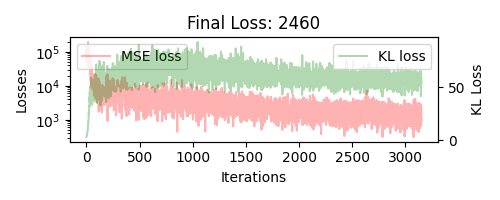

./saves/adaptive_run_default_20240314-105607/*.png
image_arrays shape: (7, 1200, 2100, 4)


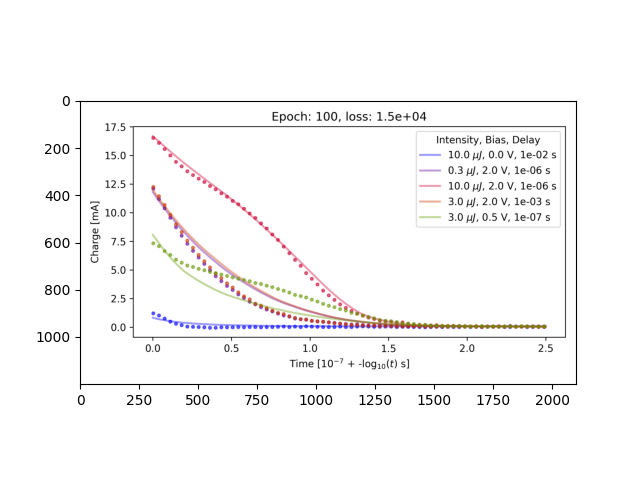

Epoch 1: Total Loss 1590.607, KL Loss 60.62, Feat. Loss 1437.45
Epoch 1: Total Loss 3570.366, KL Loss 63.47, Feat. Loss 3410.03
Epoch 1: Total Loss 2478.939, KL Loss 61.32, Feat. Loss 2324.02
Epoch 1: Total Loss 1294.244, KL Loss 56.46, Feat. Loss 1151.61
Epoch 1: Total Loss 749.672, KL Loss 50.75, Feat. Loss 621.45
Epoch 1: Total Loss 703.651, KL Loss 45.76, Feat. Loss 588.06
Epoch 1: Total Loss 1247.415, KL Loss 54.41, Feat. Loss 1109.95
Epoch 1: Total Loss 2014.840, KL Loss 61.55, Feat. Loss 1859.36
Epoch 1: Total Loss 683.369, KL Loss 53.91, Feat. Loss 547.18
Epoch 1 : 95.55, 80.89
Epoch 2: Total Loss 1584.014, KL Loss 61.47, Feat. Loss 1428.72
Epoch 2: Total Loss 1145.883, KL Loss 49.64, Feat. Loss 1020.48
Epoch 2: Total Loss 1731.798, KL Loss 51.61, Feat. Loss 1601.41
Epoch 2: Total Loss 2425.228, KL Loss 53.45, Feat. Loss 2290.20
Epoch 2: Total Loss 1104.916, KL Loss 61.94, Feat. Loss 948.43
Epoch 2: Total Loss 1689.974, KL Loss 63.03, Feat. Loss 1530.74
Epoch 2: Total Loss 1441

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


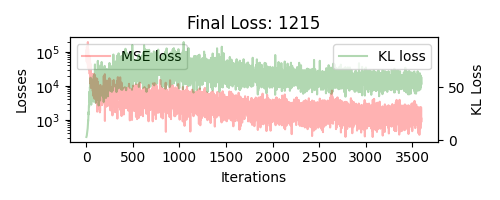

./saves/adaptive_run_default_20240314-105607/*.png
image_arrays shape: (8, 1200, 2100, 4)


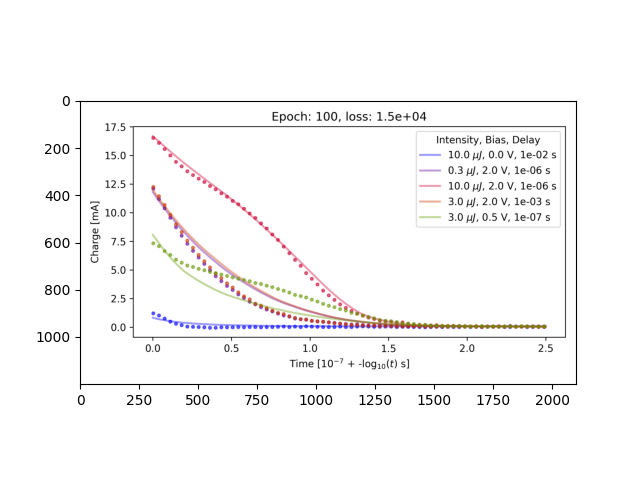

Epoch 1: Total Loss 1023.635, KL Loss 63.27, Feat. Loss 877.11
Epoch 1: Total Loss 1703.797, KL Loss 53.04, Feat. Loss 1580.97
Epoch 1: Total Loss 1024.951, KL Loss 49.54, Feat. Loss 910.22
Epoch 1: Total Loss 1443.185, KL Loss 57.48, Feat. Loss 1310.07
Epoch 1: Total Loss 1783.763, KL Loss 48.50, Feat. Loss 1671.44
Epoch 1: Total Loss 834.512, KL Loss 57.27, Feat. Loss 701.90
Epoch 1: Total Loss 1301.596, KL Loss 52.55, Feat. Loss 1179.91
Epoch 1: Total Loss 785.232, KL Loss 54.93, Feat. Loss 658.03
Epoch 1: Total Loss 1692.799, KL Loss 51.03, Feat. Loss 1574.62
Epoch 1 : 77.29, 81.35
Epoch 2: Total Loss 1174.417, KL Loss 55.05, Feat. Loss 1046.94
Epoch 2: Total Loss 1005.700, KL Loss 57.79, Feat. Loss 871.88
Epoch 2: Total Loss 1677.322, KL Loss 46.59, Feat. Loss 1569.43
Epoch 2: Total Loss 814.291, KL Loss 59.95, Feat. Loss 675.46
Epoch 2: Total Loss 981.349, KL Loss 50.26, Feat. Loss 864.96
Epoch 2: Total Loss 1947.707, KL Loss 51.48, Feat. Loss 1828.49
Epoch 2: Total Loss 1188.089

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


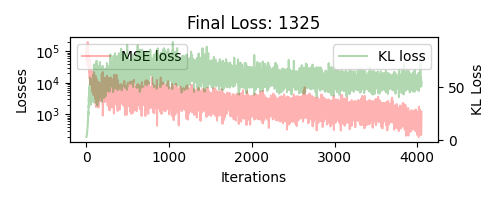

./saves/adaptive_run_default_20240314-105607/*.png
image_arrays shape: (9, 1200, 2100, 4)


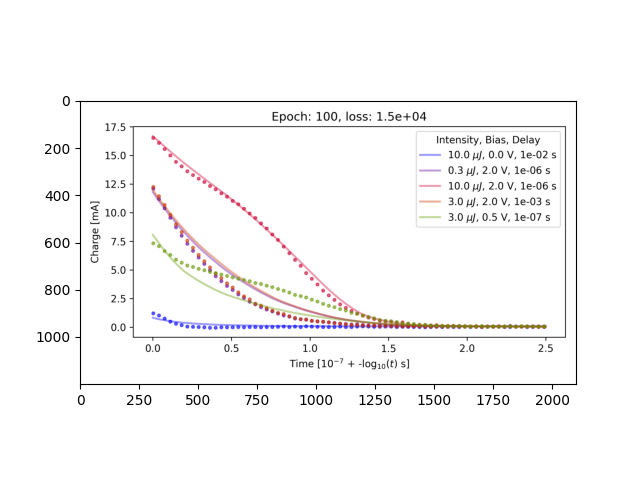

Epoch 1: Total Loss 745.914, KL Loss 52.21, Feat. Loss 635.99
Epoch 1: Total Loss 777.650, KL Loss 51.27, Feat. Loss 669.72
Epoch 1: Total Loss 786.742, KL Loss 64.11, Feat. Loss 651.77
Epoch 1: Total Loss 832.776, KL Loss 53.31, Feat. Loss 720.55
Epoch 1: Total Loss 1100.385, KL Loss 50.97, Feat. Loss 993.07
Epoch 1: Total Loss 977.024, KL Loss 57.24, Feat. Loss 856.51
Epoch 1: Total Loss 715.946, KL Loss 60.27, Feat. Loss 589.07
Epoch 1: Total Loss 834.718, KL Loss 57.39, Feat. Loss 713.91
Epoch 1: Total Loss 736.635, KL Loss 52.32, Feat. Loss 626.48
Epoch 1 : 50.05, 49.17
Epoch 2: Total Loss 693.311, KL Loss 49.82, Feat. Loss 588.43
Epoch 2: Total Loss 1113.423, KL Loss 47.20, Feat. Loss 1014.05
Epoch 2: Total Loss 960.193, KL Loss 54.49, Feat. Loss 845.48
Epoch 2: Total Loss 984.765, KL Loss 61.27, Feat. Loss 855.78
Epoch 2: Total Loss 1313.518, KL Loss 54.69, Feat. Loss 1198.38
Epoch 2: Total Loss 1112.402, KL Loss 65.09, Feat. Loss 975.37
Epoch 2: Total Loss 1109.651, KL Loss 52.

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


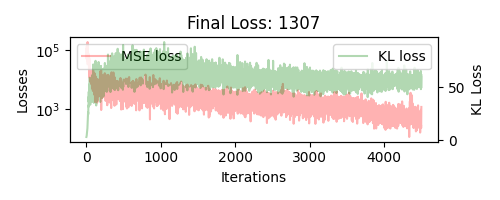

./saves/adaptive_run_default_20240314-105607/*.png
image_arrays shape: (10, 1200, 2100, 4)


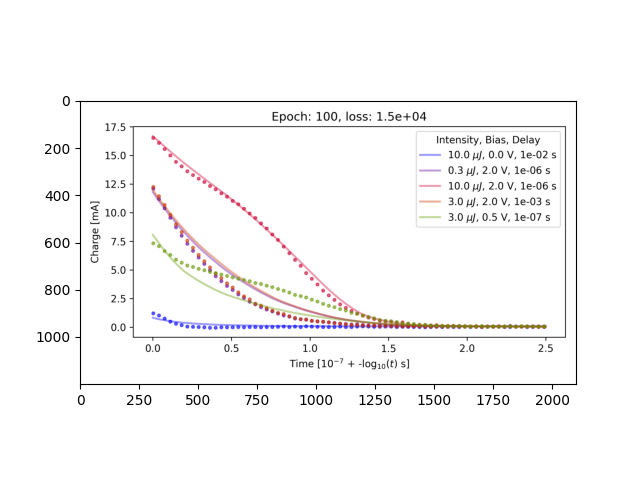

Epoch 1: Total Loss 566.024, KL Loss 47.42, Feat. Loss 476.18
Epoch 1: Total Loss 458.693, KL Loss 55.70, Feat. Loss 353.15
Epoch 1: Total Loss 670.465, KL Loss 61.47, Feat. Loss 553.99
Epoch 1: Total Loss 887.770, KL Loss 55.84, Feat. Loss 781.97
Epoch 1: Total Loss 949.534, KL Loss 54.67, Feat. Loss 845.95
Epoch 1: Total Loss 410.395, KL Loss 53.81, Feat. Loss 308.44
Epoch 1: Total Loss 562.523, KL Loss 60.45, Feat. Loss 447.98
Epoch 1: Total Loss 431.015, KL Loss 55.00, Feat. Loss 326.80
Epoch 1: Total Loss 432.381, KL Loss 62.02, Feat. Loss 314.87
Epoch 1 : 35.79, 35.16
Epoch 2: Total Loss 464.486, KL Loss 57.57, Feat. Loss 355.40
Epoch 2: Total Loss 464.390, KL Loss 55.06, Feat. Loss 360.07
Epoch 2: Total Loss 955.073, KL Loss 64.19, Feat. Loss 833.46
Epoch 2: Total Loss 720.406, KL Loss 49.35, Feat. Loss 626.90
Epoch 2: Total Loss 421.045, KL Loss 55.40, Feat. Loss 316.07
Epoch 2: Total Loss 244.599, KL Loss 52.95, Feat. Loss 144.26
Epoch 2: Total Loss 497.271, KL Loss 62.61, Fea

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


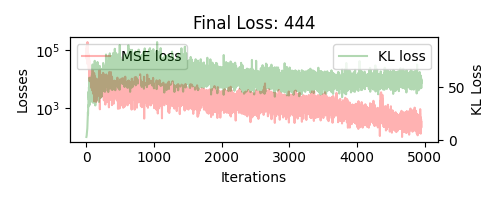

./saves/adaptive_run_default_20240314-105607/*.png
image_arrays shape: (11, 1200, 2100, 4)


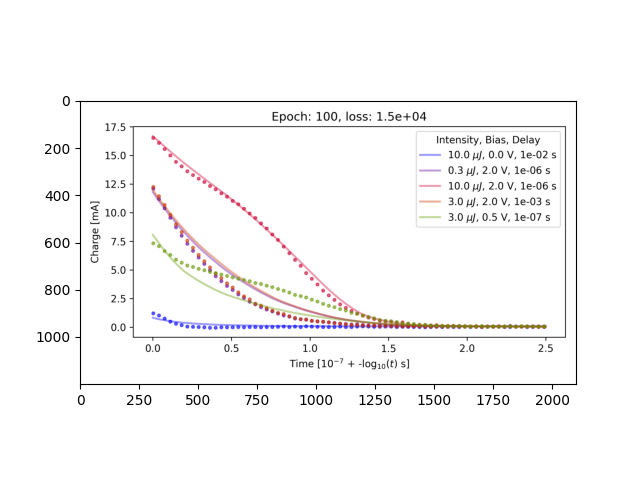

Training is done
The adaptive training parameters are: {'lr': array([0.00199526, 0.00170443, 0.00145599, 0.00124376, 0.00106247,
       0.0009076 , 0.00077531, 0.0006623 , 0.00056576, 0.00048329,
       0.00041285, 0.00035267, 0.00030126, 0.00025735, 0.00021984,
       0.0001878 , 0.00016042, 0.00013704, 0.00011706, 0.0001    ]), 'beta': array([4.        , 3.78947368, 3.57894737, 3.36842105, 3.15789474,
       2.94736842, 2.73684211, 2.52631579, 2.31578947, 2.10526316,
       1.89473684, 1.68421053, 1.47368421, 1.26315789, 1.05263158,
       0.84210526, 0.63157895, 0.42105263, 0.21052632, 0.        ]), 'epochs': [50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50, 50]}
intialising model on device: cpu


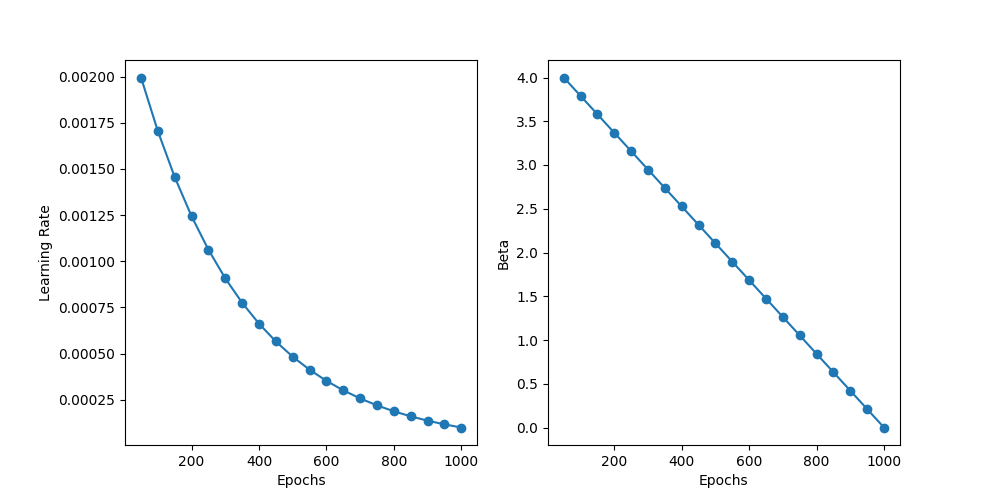

Epoch 1: Total Loss 126391.281, KL Loss 6.23, Feat. Loss 126366.35
Epoch 1: Total Loss 94984.312, KL Loss 5.64, Feat. Loss 94961.75
Epoch 1: Total Loss 111059.352, KL Loss 5.69, Feat. Loss 111036.59
Epoch 1: Total Loss 100533.430, KL Loss 5.81, Feat. Loss 100510.19
Epoch 1: Total Loss 79765.094, KL Loss 5.69, Feat. Loss 79742.32
Epoch 1: Total Loss 135633.078, KL Loss 6.16, Feat. Loss 135608.45
Epoch 1: Total Loss 131725.953, KL Loss 7.11, Feat. Loss 131697.50
Epoch 1: Total Loss 93435.766, KL Loss 6.96, Feat. Loss 93407.94
Epoch 1: Total Loss 73365.062, KL Loss 7.84, Feat. Loss 73333.71
Epoch 1 : 6312.62, 6283.34
Epoch 2: Total Loss 82854.289, KL Loss 8.28, Feat. Loss 82821.16
Epoch 2: Total Loss 103627.219, KL Loss 9.11, Feat. Loss 103590.79
Epoch 2: Total Loss 79918.609, KL Loss 10.02, Feat. Loss 79878.55
Epoch 2: Total Loss 98350.617, KL Loss 11.11, Feat. Loss 98306.19
Epoch 2: Total Loss 80432.336, KL Loss 11.49, Feat. Loss 80386.39
Epoch 2: Total Loss 114944.375, KL Loss 12.52, F

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


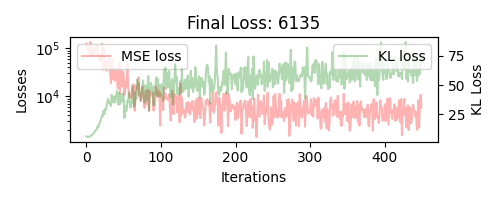

./saves/adaptive_run_default_20240314-115516/*.png
image_arrays shape: (1, 1200, 2100, 4)


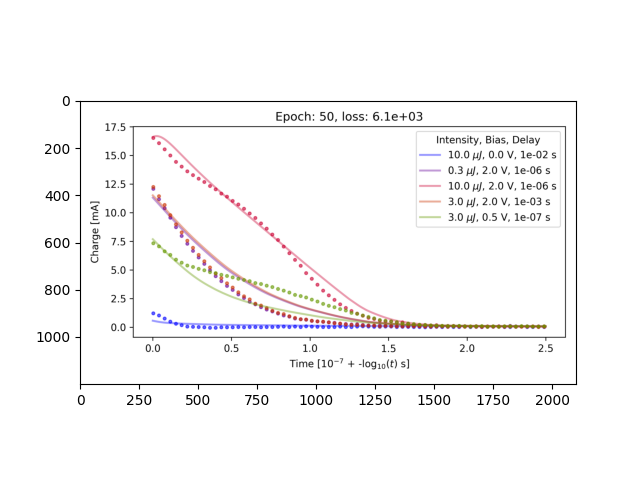

Epoch 1: Total Loss 4260.648, KL Loss 67.18, Feat. Loss 4006.08
Epoch 1: Total Loss 4995.317, KL Loss 57.77, Feat. Loss 4776.41
Epoch 1: Total Loss 5798.834, KL Loss 60.94, Feat. Loss 5567.89
Epoch 1: Total Loss 5999.337, KL Loss 56.56, Feat. Loss 5784.99
Epoch 1: Total Loss 4304.691, KL Loss 61.40, Feat. Loss 4072.01
Epoch 1: Total Loss 7672.703, KL Loss 74.20, Feat. Loss 7391.52
Epoch 1: Total Loss 3663.090, KL Loss 76.31, Feat. Loss 3373.90
Epoch 1: Total Loss 4355.616, KL Loss 69.52, Feat. Loss 4092.18
Epoch 1: Total Loss 3061.138, KL Loss 66.71, Feat. Loss 2808.35
Epoch 1 : 294.08, 272.23
Epoch 2: Total Loss 2670.347, KL Loss 71.36, Feat. Loss 2399.94
Epoch 2: Total Loss 4352.345, KL Loss 57.07, Feat. Loss 4136.09
Epoch 2: Total Loss 2104.771, KL Loss 55.31, Feat. Loss 1895.19
Epoch 2: Total Loss 8754.979, KL Loss 74.52, Feat. Loss 8472.59
Epoch 2: Total Loss 1327.907, KL Loss 65.39, Feat. Loss 1080.12
Epoch 2: Total Loss 2287.633, KL Loss 54.34, Feat. Loss 2081.70
Epoch 2: Total 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


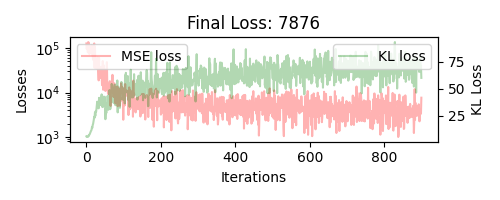

./saves/adaptive_run_default_20240314-115516/*.png
image_arrays shape: (2, 1200, 2100, 4)


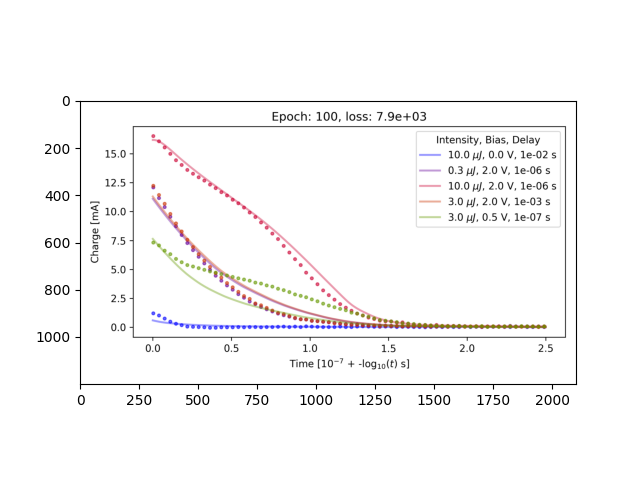

Epoch 1: Total Loss 1608.685, KL Loss 61.60, Feat. Loss 1388.21
Epoch 1: Total Loss 4047.943, KL Loss 65.73, Feat. Loss 3812.69
Epoch 1: Total Loss 7719.470, KL Loss 77.13, Feat. Loss 7443.42
Epoch 1: Total Loss 2678.114, KL Loss 55.62, Feat. Loss 2479.04
Epoch 1: Total Loss 4966.261, KL Loss 61.95, Feat. Loss 4744.56
Epoch 1: Total Loss 2118.476, KL Loss 58.47, Feat. Loss 1909.23
Epoch 1: Total Loss 4434.986, KL Loss 66.80, Feat. Loss 4195.91
Epoch 1: Total Loss 5255.123, KL Loss 83.62, Feat. Loss 4955.84
Epoch 1: Total Loss 2114.693, KL Loss 73.41, Feat. Loss 1851.95
Epoch 1 : 232.96, 253.00
Epoch 2: Total Loss 4230.074, KL Loss 72.14, Feat. Loss 3971.88
Epoch 2: Total Loss 2256.401, KL Loss 61.58, Feat. Loss 2036.03
Epoch 2: Total Loss 4446.173, KL Loss 74.85, Feat. Loss 4178.28
Epoch 2: Total Loss 4935.798, KL Loss 76.82, Feat. Loss 4660.85
Epoch 2: Total Loss 3029.012, KL Loss 69.57, Feat. Loss 2780.03
Epoch 2: Total Loss 5438.272, KL Loss 77.28, Feat. Loss 5161.67
Epoch 2: Total 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


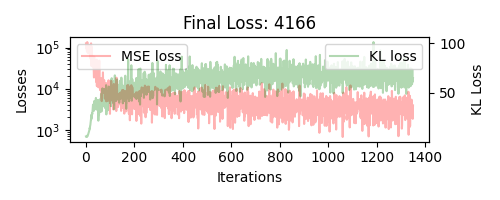

./saves/adaptive_run_default_20240314-115516/*.png
image_arrays shape: (3, 1200, 2100, 4)


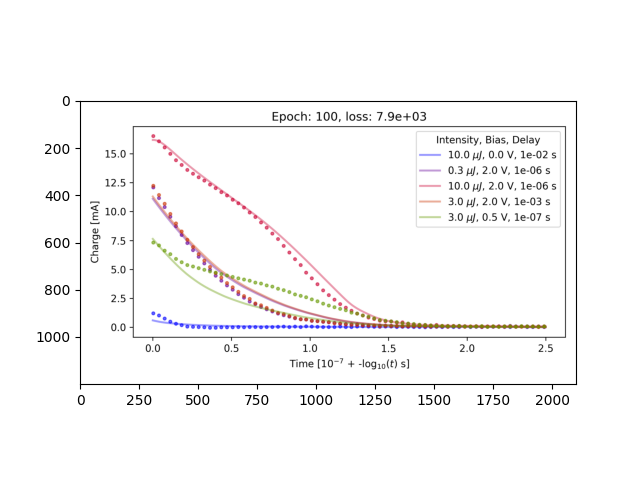

Epoch 1: Total Loss 1692.158, KL Loss 64.45, Feat. Loss 1475.07
Epoch 1: Total Loss 2884.515, KL Loss 51.40, Feat. Loss 2711.38
Epoch 1: Total Loss 6709.294, KL Loss 72.47, Feat. Loss 6465.18
Epoch 1: Total Loss 1985.663, KL Loss 69.14, Feat. Loss 1752.76
Epoch 1: Total Loss 3608.505, KL Loss 67.61, Feat. Loss 3380.77
Epoch 1: Total Loss 3317.387, KL Loss 64.07, Feat. Loss 3101.56
Epoch 1: Total Loss 2860.874, KL Loss 76.58, Feat. Loss 2602.92
Epoch 1: Total Loss 1350.066, KL Loss 66.07, Feat. Loss 1127.51
Epoch 1: Total Loss 4863.760, KL Loss 72.12, Feat. Loss 4620.83
Epoch 1 : 195.15, 180.28
Epoch 2: Total Loss 3336.715, KL Loss 63.77, Feat. Loss 3121.90
Epoch 2: Total Loss 3613.639, KL Loss 73.31, Feat. Loss 3366.71
Epoch 2: Total Loss 5443.377, KL Loss 78.72, Feat. Loss 5178.20
Epoch 2: Total Loss 1693.866, KL Loss 64.48, Feat. Loss 1476.68
Epoch 2: Total Loss 1664.912, KL Loss 62.58, Feat. Loss 1454.11
Epoch 2: Total Loss 4116.508, KL Loss 76.80, Feat. Loss 3857.83
Epoch 2: Total 

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


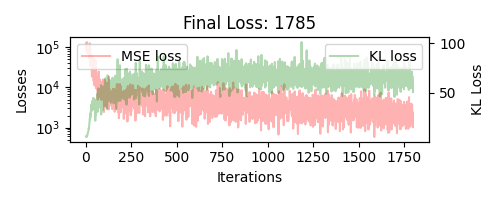

./saves/adaptive_run_default_20240314-115516/*.png
image_arrays shape: (4, 1200, 2100, 4)


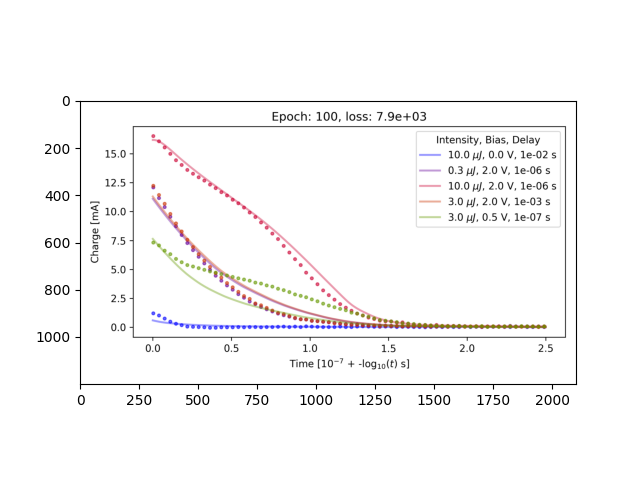

Epoch 1: Total Loss 1573.134, KL Loss 51.53, Feat. Loss 1410.42
Epoch 1: Total Loss 2170.713, KL Loss 61.05, Feat. Loss 1977.93
Epoch 1: Total Loss 1995.061, KL Loss 60.50, Feat. Loss 1804.00
Epoch 1: Total Loss 2968.968, KL Loss 51.99, Feat. Loss 2804.79
Epoch 1: Total Loss 2830.874, KL Loss 67.74, Feat. Loss 2616.96
Epoch 1: Total Loss 3773.817, KL Loss 70.97, Feat. Loss 3549.70
Epoch 1: Total Loss 1852.326, KL Loss 70.71, Feat. Loss 1629.03
Epoch 1: Total Loss 2229.002, KL Loss 67.42, Feat. Loss 2016.09
Epoch 1: Total Loss 1900.945, KL Loss 59.64, Feat. Loss 1712.61
Epoch 1 : 141.97, 135.67
Epoch 2: Total Loss 3834.793, KL Loss 69.04, Feat. Loss 3616.76
Epoch 2: Total Loss 3411.261, KL Loss 64.94, Feat. Loss 3206.18
Epoch 2: Total Loss 1019.380, KL Loss 52.52, Feat. Loss 853.53
Epoch 2: Total Loss 3816.247, KL Loss 73.21, Feat. Loss 3585.07
Epoch 2: Total Loss 2101.213, KL Loss 71.33, Feat. Loss 1875.96
Epoch 2: Total Loss 1551.907, KL Loss 52.04, Feat. Loss 1387.57
Epoch 2: Total L

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


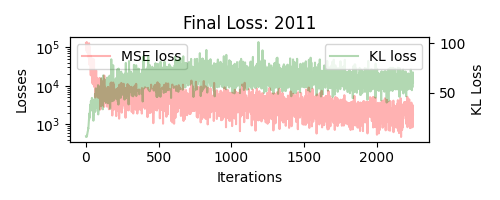

./saves/adaptive_run_default_20240314-115516/*.png
image_arrays shape: (5, 1200, 2100, 4)


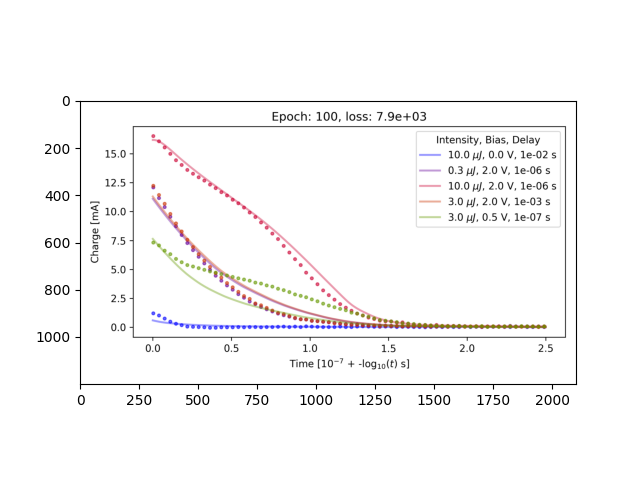

Epoch 1: Total Loss 2093.558, KL Loss 62.71, Feat. Loss 1908.72
Epoch 1: Total Loss 1664.068, KL Loss 53.90, Feat. Loss 1505.20
Epoch 1: Total Loss 1918.928, KL Loss 72.57, Feat. Loss 1705.05
Epoch 1: Total Loss 918.017, KL Loss 60.11, Feat. Loss 740.87
Epoch 1: Total Loss 2584.228, KL Loss 68.34, Feat. Loss 2382.82
Epoch 1: Total Loss 1119.907, KL Loss 48.73, Feat. Loss 976.29
Epoch 1: Total Loss 1292.412, KL Loss 58.23, Feat. Loss 1120.80
Epoch 1: Total Loss 4590.435, KL Loss 65.45, Feat. Loss 4397.54
Epoch 1: Total Loss 2101.952, KL Loss 64.70, Feat. Loss 1911.27
Epoch 1 : 121.89, 119.93
Epoch 2: Total Loss 1211.973, KL Loss 52.59, Feat. Loss 1056.97
Epoch 2: Total Loss 2505.433, KL Loss 52.40, Feat. Loss 2350.98
Epoch 2: Total Loss 4144.486, KL Loss 62.57, Feat. Loss 3960.08
Epoch 2: Total Loss 1555.875, KL Loss 66.92, Feat. Loss 1358.63
Epoch 2: Total Loss 2217.783, KL Loss 72.94, Feat. Loss 2002.80
Epoch 2: Total Loss 1817.773, KL Loss 65.82, Feat. Loss 1623.77
Epoch 2: Total Los

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


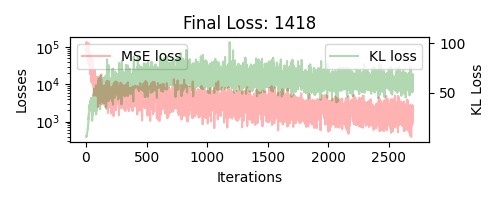

./saves/adaptive_run_default_20240314-115516/*.png
image_arrays shape: (6, 1200, 2100, 4)


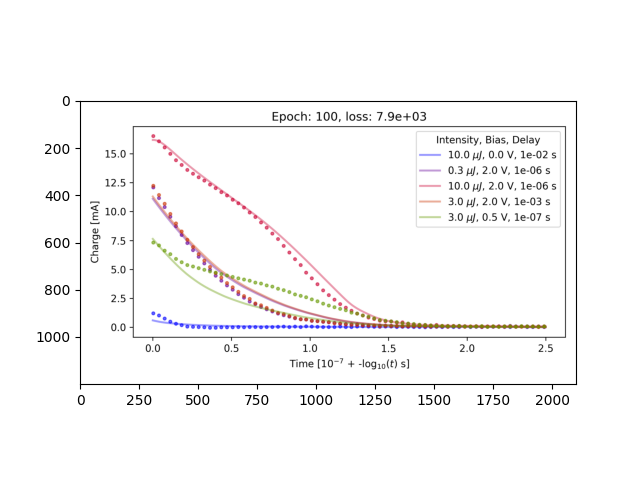

Epoch 1: Total Loss 1117.026, KL Loss 65.91, Feat. Loss 936.63
Epoch 1: Total Loss 3519.321, KL Loss 71.04, Feat. Loss 3324.89
Epoch 1: Total Loss 1331.945, KL Loss 47.25, Feat. Loss 1202.64
Epoch 1: Total Loss 1168.001, KL Loss 66.11, Feat. Loss 987.07
Epoch 1: Total Loss 2151.722, KL Loss 60.01, Feat. Loss 1987.47
Epoch 1: Total Loss 2281.929, KL Loss 59.35, Feat. Loss 2119.49
Epoch 1: Total Loss 2114.096, KL Loss 58.68, Feat. Loss 1953.49
Epoch 1: Total Loss 1329.742, KL Loss 64.18, Feat. Loss 1154.10
Epoch 1: Total Loss 812.264, KL Loss 49.36, Feat. Loss 677.19
Epoch 1 : 105.51, 83.25
Epoch 2: Total Loss 1469.106, KL Loss 69.17, Feat. Loss 1279.80
Epoch 2: Total Loss 1727.017, KL Loss 62.71, Feat. Loss 1555.40
Epoch 2: Total Loss 1654.631, KL Loss 54.64, Feat. Loss 1505.09
Epoch 2: Total Loss 2657.355, KL Loss 59.06, Feat. Loss 2495.72
Epoch 2: Total Loss 1127.220, KL Loss 60.33, Feat. Loss 962.10
Epoch 2: Total Loss 2341.899, KL Loss 60.13, Feat. Loss 2177.34
Epoch 2: Total Loss 1

C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:346: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-r" (-> color='r'). The keyword argument will take precedence.
  ax.plot(MSE_loss, '-r', label='MSE loss', alpha=0.3, color='red')
C:\Users\z5183876\AppData\Local\Temp\ipykernel_8068\3017134385.py:360: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "-g" (-> color='g'). The keyword argument will take precedence.
  ax1.plot(KL_loss, '-g', label='KL loss', alpha=0.3, color='green')


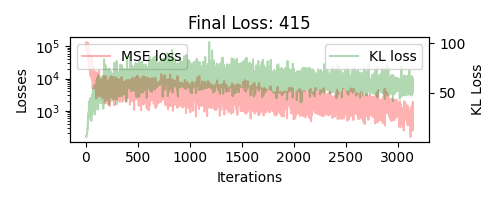

./saves/adaptive_run_default_20240314-115516/*.png
image_arrays shape: (7, 1200, 2100, 4)


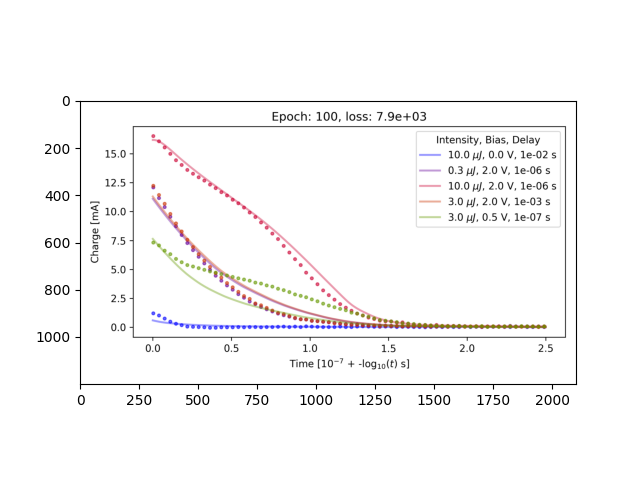

Training is done


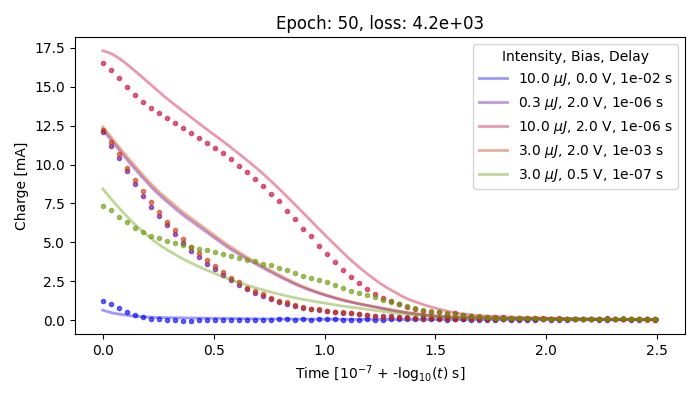

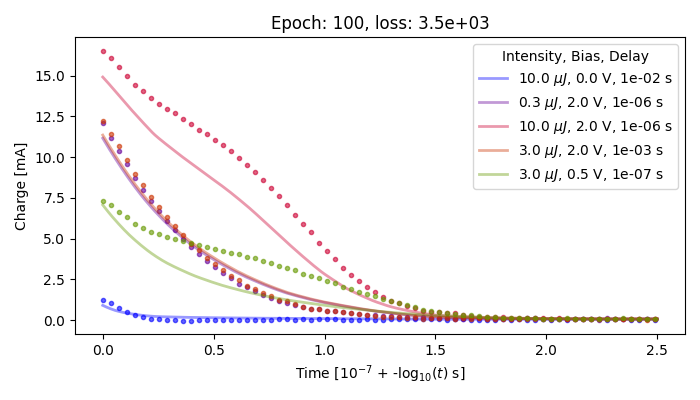

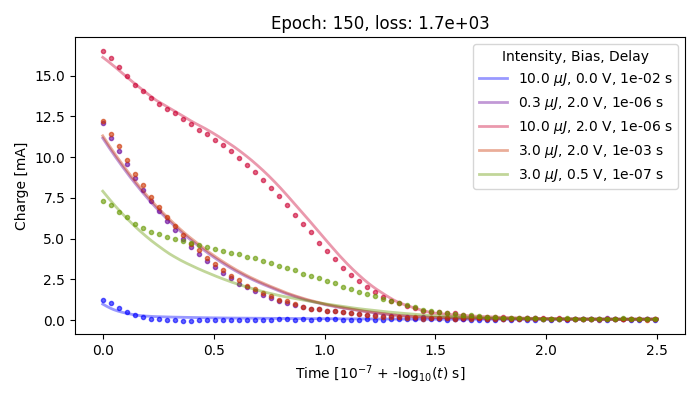

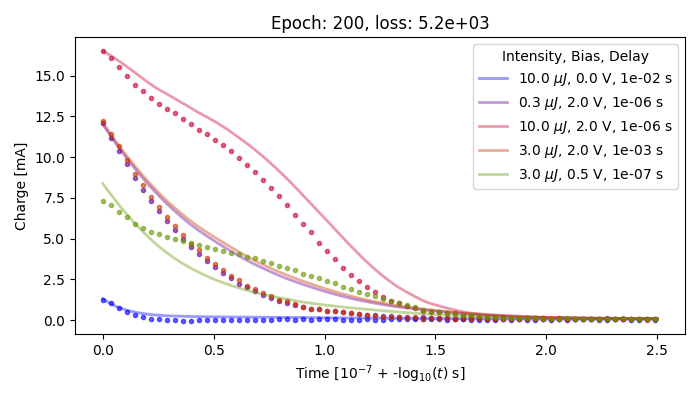

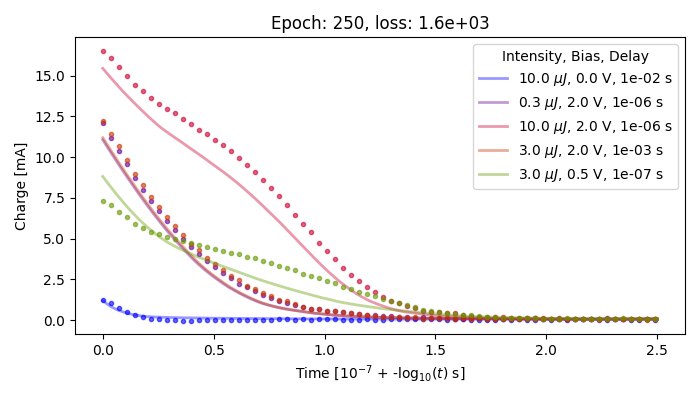

...

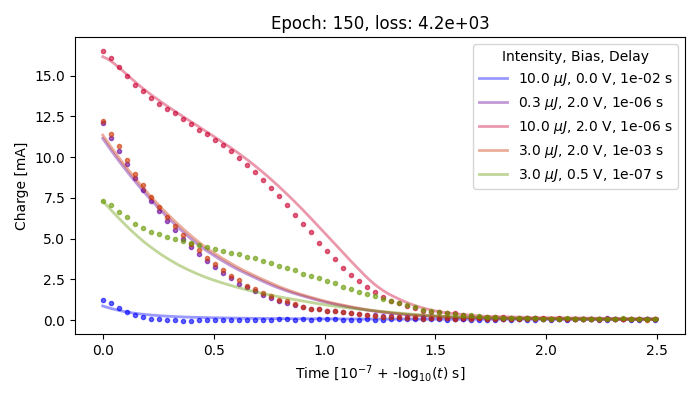

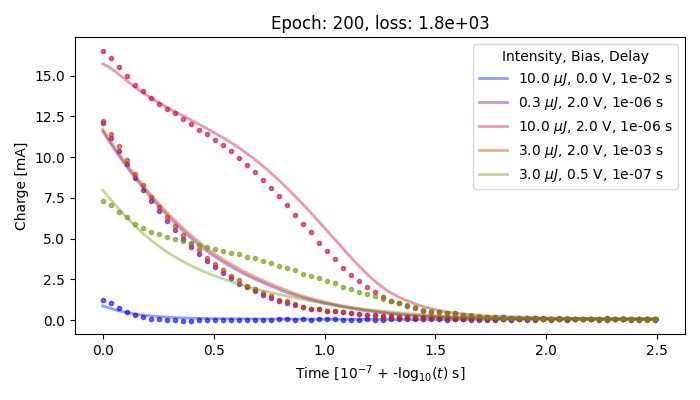

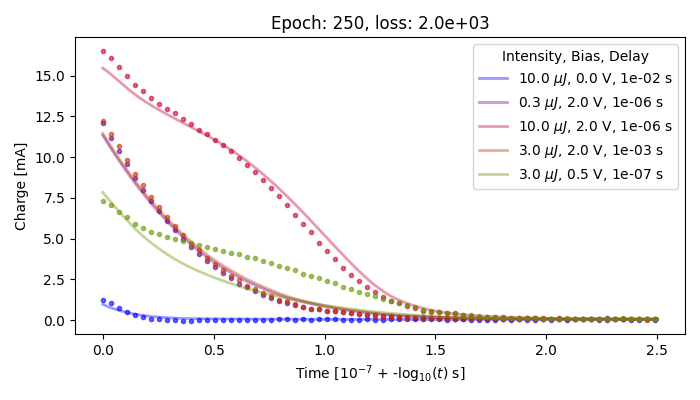

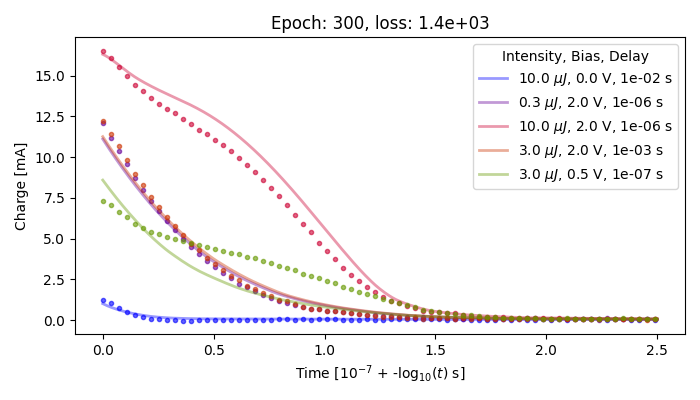

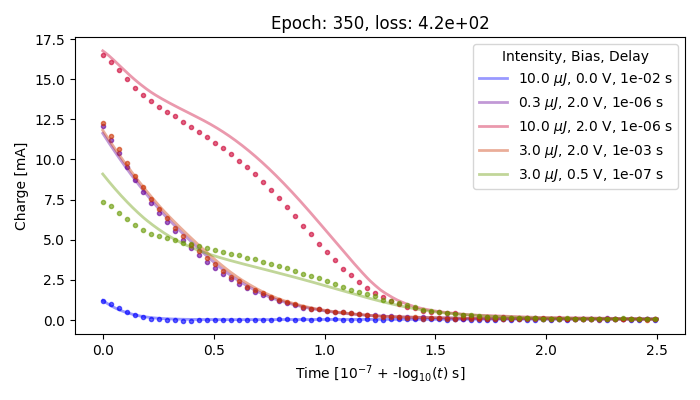

In [ ]:
# try different beta profile
# beta_profile = [
#     amp*np.sin(np.linspace(0, 5/2*np.pi, 20)) + 2,
#     amp*np.sin(np.linspace(0, 2*np.pi, 20)) + 2,
#     amp*np.sin(np.linspace(0, 3*np.pi, 20)) + 2,
#     amp*np.sin(np.linspace(0, 3.5*np.pi, 20)) + 2,
#     amp*np.sin(np.linspace(0, 4*np.pi, 20)) + 2,
#     amp*np.sin(np.linspace(0, 1.5*np.pi, 20)) + 2,
#     amp*np.sin(np.linspace(0, 1*np.pi, 20)) + 2,
# ]
# for beta_param in beta_profile:
#     adaptive_training['beta'] = beta_param
#     # repeat 3 times
#     adaptive_run_and_save(model_params, dataset, adaptive_training)
#     adaptive_run_and_save(model_params, dataset, adaptive_training)
#     adaptive_run_and_save(model_params, dataset, adaptive_training)

beta_profile = [
    np.linspace(0, 4, 20),
    np.linspace(4, 0, 20),
]
for beta_param in beta_profile:
    adaptive_training['beta'] = beta_param
    # repeat 3 times
    adaptive_run_and_save(model_params, dataset, adaptive_training)
    adaptive_run_and_save(model_params, dataset, adaptive_training)
    adaptive_run_and_save(model_params, dataset, adaptive_training)

## 3.2. Execute a grid search

The model parameters are: {'nhidden': 128, 'rnn_nhidden': 32, 'obs_dim': 1, 'latent_dim': 2, 'lr': 0.01, 'n_batch': 16, 'beta': 4, 'optim': Adam (
Parameter Group 0
    amsgrad: False
    betas: (0.9, 0.999)
    capturable: False
    differentiable: False
    eps: 1e-08
    foreach: None
    fused: None
    lr: 0.001
    maximize: False
    weight_decay: 0
), 'device': 'cpu', 'func': LatentODEfunc(
  (elu): ELU(alpha=1.0, inplace=True)
  (fci): Linear(in_features=16, out_features=128, bias=True)
  (fc1): Linear(in_features=128, out_features=128, bias=True)
  (fco): Linear(in_features=128, out_features=16, bias=True)
), 'rec': RecognitionRNN(
  (i2h): Linear(in_features=33, out_features=32, bias=True)
  (h2o): Linear(in_features=32, out_features=32, bias=True)
), 'dec': Decoder(
  (relu): ReLU(inplace=True)
  (fc1): Linear(in_features=16, out_features=128, bias=True)
  (fc2): Linear(in_features=128, out_features=1, bias=True)
), 'total_epochs_train': 10, 'epochs_per_train': 2, 'epochs':

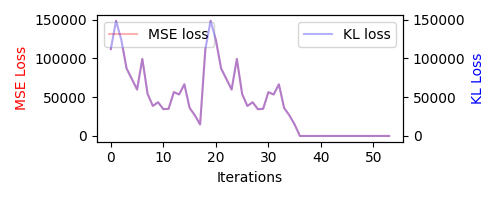

Epoch 1: Total Loss 17154.164, KL Loss 13.13, Feat. Loss 17101.64
Epoch 1: Total Loss 38941.508, KL Loss 18.39, Feat. Loss 38867.95
Epoch 1: Total Loss 22669.293, KL Loss 17.96, Feat. Loss 22597.47
Epoch 1: Total Loss 7859.785, KL Loss 16.12, Feat. Loss 7795.32
Epoch 1: Total Loss 36585.863, KL Loss 26.18, Feat. Loss 36481.14
Epoch 1: Total Loss 35687.367, KL Loss 29.32, Feat. Loss 35570.08
Epoch 1: Total Loss 23024.387, KL Loss 24.74, Feat. Loss 22925.43
Epoch 1: Total Loss 19479.578, KL Loss 31.11, Feat. Loss 19355.13
Epoch 1: Total Loss 33727.207, KL Loss 30.53, Feat. Loss 33605.09
Epoch 1 : 1567.53, 1439.02
Epoch 2: Total Loss 12697.400, KL Loss 21.05, Feat. Loss 12613.21
Epoch 2: Total Loss 13687.146, KL Loss 20.03, Feat. Loss 13607.03
Epoch 2: Total Loss 6175.909, KL Loss 19.64, Feat. Loss 6097.35
Epoch 2: Total Loss 12744.781, KL Loss 16.84, Feat. Loss 12677.44
Epoch 2: Total Loss 23210.037, KL Loss 17.80, Feat. Loss 23138.85
Epoch 2: Total Loss 18393.471, KL Loss 16.08, Feat. L

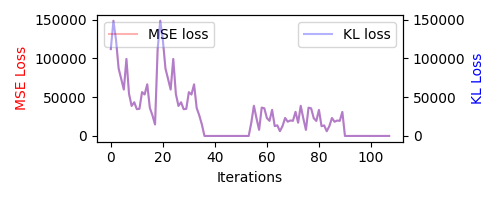

Epoch 1: Total Loss 15597.688, KL Loss 16.94, Feat. Loss 15529.92
Epoch 1: Total Loss 4603.218, KL Loss 17.80, Feat. Loss 4532.03
Epoch 1: Total Loss 23834.428, KL Loss 14.21, Feat. Loss 23777.61
Epoch 1: Total Loss 21249.842, KL Loss 15.39, Feat. Loss 21188.29
Epoch 1: Total Loss 9564.452, KL Loss 13.33, Feat. Loss 9511.13
Epoch 1: Total Loss 7946.814, KL Loss 15.37, Feat. Loss 7885.32
Epoch 1: Total Loss 14387.093, KL Loss 17.71, Feat. Loss 14316.27
Epoch 1: Total Loss 14881.318, KL Loss 17.06, Feat. Loss 14813.08
Epoch 1: Total Loss 9229.791, KL Loss 18.54, Feat. Loss 9155.62
Epoch 1 : 808.63, 899.19
Epoch 2: Total Loss 14156.646, KL Loss 20.12, Feat. Loss 14076.16
Epoch 2: Total Loss 5860.368, KL Loss 13.81, Feat. Loss 5805.14
Epoch 2: Total Loss 6400.264, KL Loss 13.42, Feat. Loss 6346.57
Epoch 2: Total Loss 31968.479, KL Loss 18.52, Feat. Loss 31894.39
Epoch 2: Total Loss 5125.890, KL Loss 10.53, Feat. Loss 5083.76
Epoch 2: Total Loss 7211.875, KL Loss 18.72, Feat. Loss 7137.00
E

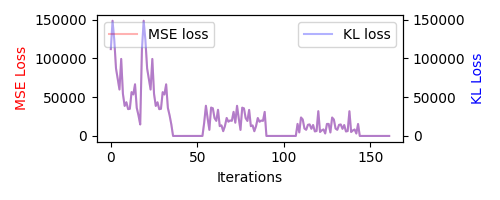

Epoch 1: Total Loss 9274.085, KL Loss 17.11, Feat. Loss 9205.64
Epoch 1: Total Loss 8416.079, KL Loss 14.38, Feat. Loss 8358.57
Epoch 1: Total Loss 10570.858, KL Loss 15.42, Feat. Loss 10509.16
Epoch 1: Total Loss 6450.667, KL Loss 17.17, Feat. Loss 6381.98
Epoch 1: Total Loss 6913.176, KL Loss 15.02, Feat. Loss 6853.09
Epoch 1: Total Loss 10974.697, KL Loss 21.19, Feat. Loss 10889.92
Epoch 1: Total Loss 6374.309, KL Loss 15.07, Feat. Loss 6314.02
Epoch 1: Total Loss 8981.253, KL Loss 19.01, Feat. Loss 8905.21
Epoch 1: Total Loss 4716.313, KL Loss 13.25, Feat. Loss 4663.29
Epoch 1 : 484.48, 526.00
Epoch 2: Total Loss 10517.582, KL Loss 17.43, Feat. Loss 10447.87
Epoch 2: Total Loss 3212.732, KL Loss 15.85, Feat. Loss 3149.34
Epoch 2: Total Loss 4241.135, KL Loss 12.09, Feat. Loss 4192.76
Epoch 2: Total Loss 1597.740, KL Loss 9.36, Feat. Loss 1560.31
Epoch 2: Total Loss 11437.831, KL Loss 16.89, Feat. Loss 11370.25
Epoch 2: Total Loss 5441.925, KL Loss 12.55, Feat. Loss 5391.74
Epoch 2:

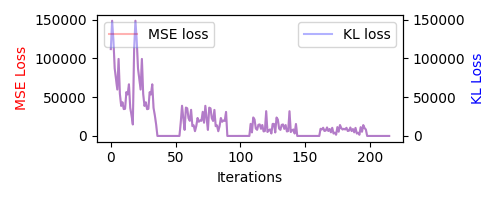

Epoch 1: Total Loss 5087.688, KL Loss 11.02, Feat. Loss 5043.61
Epoch 1: Total Loss 10522.902, KL Loss 13.96, Feat. Loss 10467.05
Epoch 1: Total Loss 12486.964, KL Loss 15.92, Feat. Loss 12423.28
Epoch 1: Total Loss 6843.114, KL Loss 17.79, Feat. Loss 6771.97
Epoch 1: Total Loss 6979.432, KL Loss 18.11, Feat. Loss 6906.99
Epoch 1: Total Loss 10427.046, KL Loss 17.33, Feat. Loss 10357.72
Epoch 1: Total Loss 5734.251, KL Loss 17.45, Feat. Loss 5664.43
Epoch 1: Total Loss 6436.203, KL Loss 15.40, Feat. Loss 6374.60
Epoch 1: Total Loss 16429.344, KL Loss 15.11, Feat. Loss 16368.89
Epoch 1 : 539.65, 436.21
Epoch 2: Total Loss 16205.884, KL Loss 15.43, Feat. Loss 16144.15
Epoch 2: Total Loss 6375.411, KL Loss 15.75, Feat. Loss 6312.40
Epoch 2: Total Loss 3582.637, KL Loss 13.98, Feat. Loss 3526.72
Epoch 2: Total Loss 7185.169, KL Loss 14.75, Feat. Loss 7126.17
Epoch 2: Total Loss 3331.845, KL Loss 17.11, Feat. Loss 3263.40
Epoch 2: Total Loss 8311.840, KL Loss 22.62, Feat. Loss 8221.36
Epoch

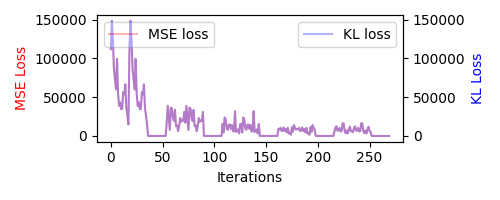

./saves/grid_seach/search2/lr_0.01_nb_16_ld_2_b_4_default_20240312-122639/*.png
image_arrays shape: (5, 1200, 2100, 4)


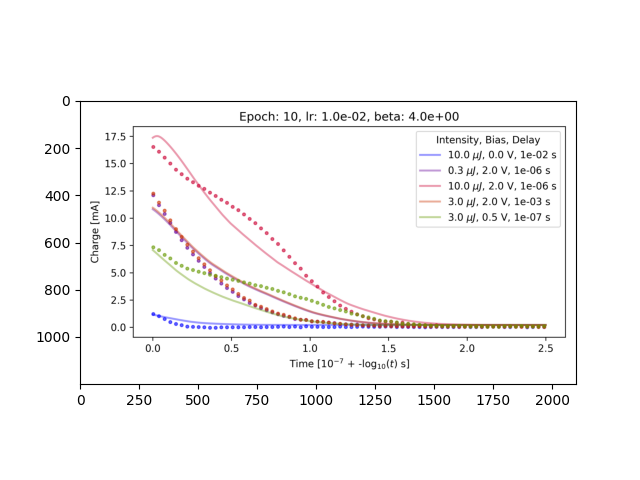

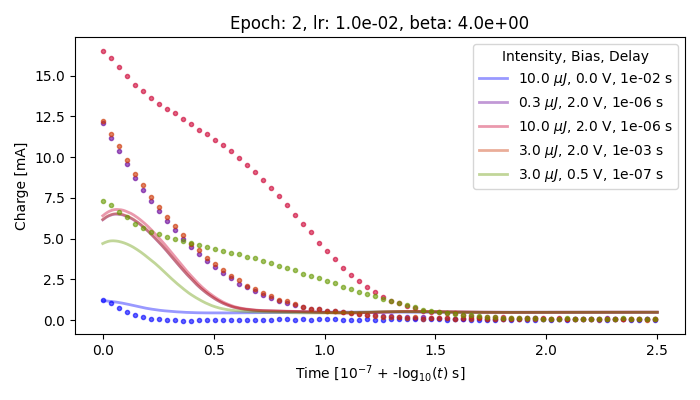

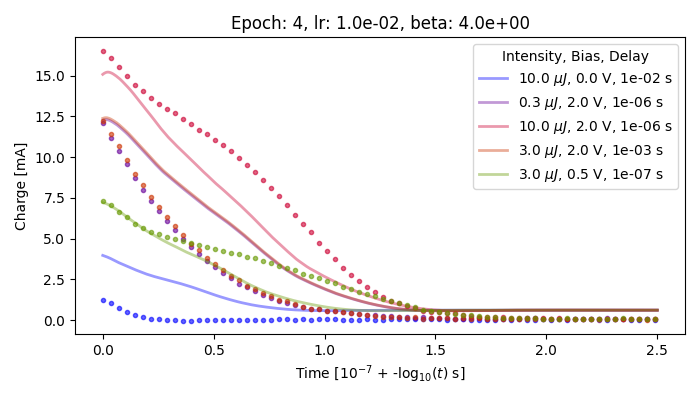

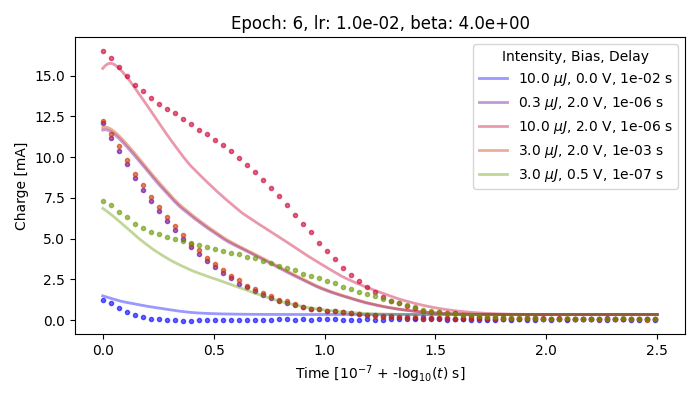

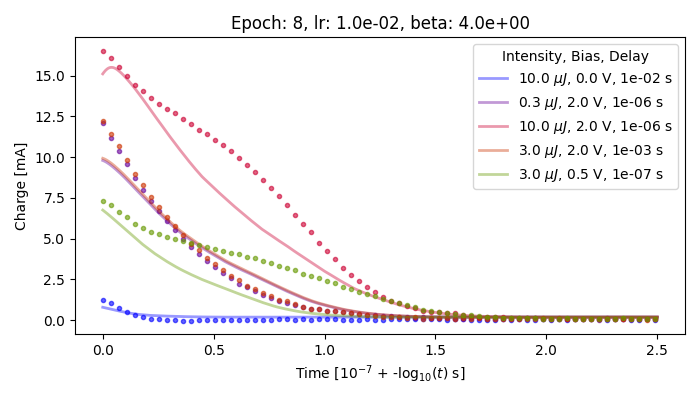

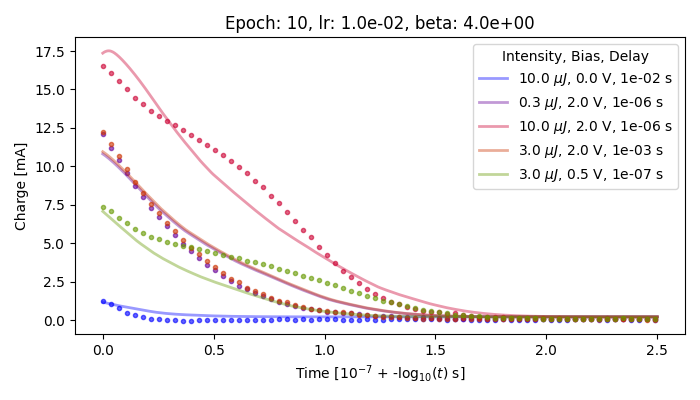

In [ ]:
grid_search(model_params)

## 3.3. Run and save

In [14]:
run_and_save(model_params, dataset)

0
The model parameters are: {'nhidden': 128, 'rnn_nhidden': 32, 'obs_dim': 1, 'latent_dim': 16, 'lr': 0.01, 'n_batch': 16, 'beta': 4, 'optim': None, 'device': None, 'func': None, 'rec': None, 'dec': None, 'total_epochs_train': 4, 'epochs_per_train': 2, 'epochs': 0, 'loss': 0, 'loss_thresh': 500, 'MSE_loss': 0, 'KL_loss': 0, 'name': 'default', 'desc': 'default run', 'folder': 'saves'}
0
intialising model on device: cpu
[0]
Epoch 1: Total Loss 151819.031, KL Loss 2.63, Feat. Loss 151808.50
Epoch 1: Total Loss 106148.945, KL Loss 2.89, Feat. Loss 106137.39
Epoch 1: Total Loss 96069.844, KL Loss 5.45, Feat. Loss 96048.05
Epoch 1: Total Loss 55699.531, KL Loss 8.19, Feat. Loss 55666.78
Epoch 1: Total Loss 110352.688, KL Loss 13.21, Feat. Loss 110299.84
Epoch 1: Total Loss 57105.117, KL Loss 17.17, Feat. Loss 57036.43


## 3.4. Others

In [ ]:
%ls

 Volume in drive C is OS
 Volume Serial Number is 369A-61BF

 Directory of c:\Users\z5183876\Documents\GitHub\ML_charge_modeling\nbks

12/03/2024  11:15 AM    <DIR>          .
12/03/2024  08:31 AM    <DIR>          ..
12/03/2024  08:22 AM    <DIR>          gifs
12/03/2024  12:14 PM         2,827,579 parameter_tuning.ipynb
12/03/2024  08:22 AM           498,255 ray.ipynb
12/03/2024  12:28 PM    <DIR>          saves
12/03/2024  08:23 AM         2,196,743 trce-lode-rebuild.ipynb
12/03/2024  08:23 AM           202,975 trce-process-updt.ipynb
               4 File(s)      5,725,552 bytes
               4 Dir(s)  321,914,171,392 bytes free


In [ ]:
#interpret grid search results

dataframe1 = pd.read_excel(".\saves\grid_seach\search1\excel_output\summary.xlsx")
 
# print(dataframe1)
data_dict = dataframe1.to_dict()

size = len(data_dict['Unnamed: 0'])
indexes = data_dict['Unnamed: 0']
learning_rates = data_dict['learning rate']
n_batchs = data_dict['n_batch']
latent_dims = data_dict['latent_dim']
betas = data_dict['beta']
lowest_loss = data_dict['lowest_loss']



minimum_loss = min(lowest_loss.values())
minimum_loss_index = list(lowest_loss.values()).index(minimum_loss)
print(f"minimum_loss: {minimum_loss} at index: {minimum_loss_index} with learning rate: {learning_rates[minimum_loss_index]}, n_batch: {n_batchs[minimum_loss_index]}, latent_dim: {latent_dims[minimum_loss_index]}, beta: {betas[minimum_loss_index]}")

lowest_loss_sorted = sorted(list(lowest_loss.values()))[:5]      #gets the 5 lowest loss values
lowest_loss_index = [list(lowest_loss.values()).index(i) for i in lowest_loss_sorted]  #gets the indexes of the 5 lowest loss values
print("\n Analysing the 5 lowest values: \n")
for i in lowest_loss_index:
    print(f"loss: {lowest_loss[i]} at index: {i} with learning rate: {learning_rates[i]}, n_batch: {n_batchs[i]}, latent_dim: {latent_dims[i]}, beta: {betas[i]}")

print("\n analysing average loss of each characterstic \n")

#get unique values of each characteristic
unique_learning_rates = list(set(learning_rates.values()))
unique_n_batchs = list(set(n_batchs.values()))
unique_latent_dims = list(set(latent_dims.values()))
unique_betas = list(set(betas.values()))\

best_learning_rate = unique_learning_rates[0]
max_loss = max(lowest_loss.values())

temp_min = max_loss
temp_avg = max_loss
best_learning_rate_min = 0
best_learning_rate_avg = 0
for lr in unique_learning_rates:
    lr_losses = [lowest_loss[i] for i in range(size) if learning_rates[i] == lr]
    print(f"\nanalysing learning rate: {lr}\n")
    minimum = min(lr_losses)
    print(f"minimum loss: {minimum}")
    print(f"25th percentile: {np.percentile(lr_losses, 25)}")
    mean = sum(lr_losses)/len(lr_losses)
    print(f"average loss: {mean}")
    print(f"75th percentile loss: {np.percentile(lr_losses, 75)}")
    if minimum < temp_min:
        temp_min = minimum
        best_learning_rate_min = lr
    if mean < temp_avg:
        temp_avg = mean
        best_learning_rate_avg = lr
print(f"\nbest learning rate for minimum loss: {best_learning_rate_min}")
print(f"best learning rate for average loss: {best_learning_rate_avg}\n")
    
temp_min = max_loss
temp_avg = max_loss
best_n_batch_min = 0
best_n_batch_avg = 0
for nb in unique_n_batchs:
    nb_losses = [lowest_loss[i] for i in range(size) if n_batchs[i] == nb]
    print(f"\nanalysing n_batch: {nb}\n")
    minimum = min(nb_losses)
    print(f"minimum loss: {minimum}")
    print(f"25th percentile: {np.percentile(nb_losses, 25)}")
    mean = sum(nb_losses)/len(nb_losses)
    print(f"average loss: {mean}")
    print(f"75th percentile loss: {np.percentile(nb_losses, 75)}")
    if minimum < temp_min:
        temp_min = minimum
        best_n_batch_min = nb
    if mean < temp_avg:
        temp_avg = mean
        best_n_batch_avg = nb
print(f"\nbest n_batch for minimum loss: {best_n_batch_min}")
print(f"best n_batch for average loss: {best_n_batch_avg}\n")

temp_min = max_loss
temp_avg = max_loss
best_latent_dim_min = 0
best_latent_dim_avg = 0
for ld in unique_latent_dims:
    ld_losses = [lowest_loss[i] for i in range(size) if latent_dims[i] == ld]
    print(f"\nanalysing latent_dim: {ld}\n")
    minimum = min(ld_losses)
    print(f"minimum loss: {minimum}")
    print(f"25th percentile: {np.percentile(ld_losses, 25)}")
    mean = sum(ld_losses)/len(ld_losses)
    print(f"average loss: {mean}")
    print(f"75th percentile loss: {np.percentile(ld_losses, 75)}")
    if minimum < temp_min:
        temp_min = minimum
        best_latent_dim_min = ld
    if mean < temp_avg:
        temp_avg = mean
        best_latent_dim_avg = ld
print(f"\nbest latent_dim for minimum loss: {best_latent_dim_min}")
print(f"best latent_dim for average loss: {best_latent_dim_avg}\n")


temp_min = max_loss
temp_avg = max_loss
best_beta_min = 0
best_beta_avg = 0
for b in unique_betas:
    b_losses = [lowest_loss[i] for i in range(size) if betas[i] == b]
    print(f"\nanalysing beta: {b}\n")
    minimum = min(b_losses)
    print(f"minimum loss: {minimum}")
    print(f"25th percentile: {np.percentile(b_losses, 25)}")
    mean = sum(b_losses)/len(b_losses)
    print(f"average loss: {mean}")
    print(f"75th percentile loss: {np.percentile(b_losses, 75)}")
    if minimum < temp_min:
        temp_min = minimum
        best_beta_min = b
    if mean < temp_avg:
        temp_avg = mean
        best_beta_avg = b
print(f"\nbest beta for minimum loss: {best_beta_min}")
print(f"best beta for average loss: {best_beta_avg}\n")

minimum_loss: 8813.390625 at index: 20 with learning rate: 0.01, n_batch: 16, latent_dim: 16, beta: 0.001

 Analysing the 5 lowest values: 

loss: 8813.390625 at index: 20 with learning rate: 0.01, n_batch: 16, latent_dim: 16, beta: 0.001
loss: 13821.625 at index: 9 with learning rate: 0.01, n_batch: 16, latent_dim: 2, beta: 4.0
loss: 14612.8681640625 at index: 16 with learning rate: 0.01, n_batch: 16, latent_dim: 8, beta: 0.5
loss: 15689.7685546875 at index: 46 with learning rate: 0.005, n_batch: 16, latent_dim: 16, beta: 0.5
loss: 16143.001953125 at index: 21 with learning rate: 0.01, n_batch: 16, latent_dim: 16, beta: 0.5

 analysing average loss of each characterstic 


analysing learning rate: 0.01

minimum loss: 8813.390625
25th percentile: 17082.22265625
average loss: 36204.0650390625
75th percentile loss: 51540.1328125

analysing learning rate: 0.005

minimum loss: 15689.7685546875
25th percentile: 18697.85546875
average loss: 33086.3885546875
75th percentile loss: 23377.257812

In [ ]:
# change summary avg loss -> 25%
# summary to include what the bads are.
# take the interesting examples/trends and look into them
# implement MSE/KL graphs.

# implement time-cutoff and run interesting trends at 200 epochs
# tweak/look into a or f tolerance

# start working on report. 


# loss: 13821.625 at index: 9 with learning rate: 0.01, n_batch: 16, latent_dim: 2, beta: 4.0

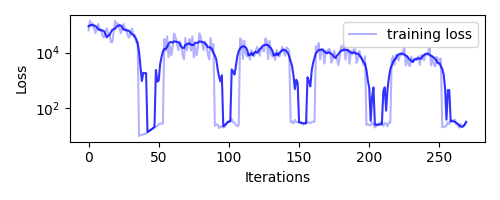

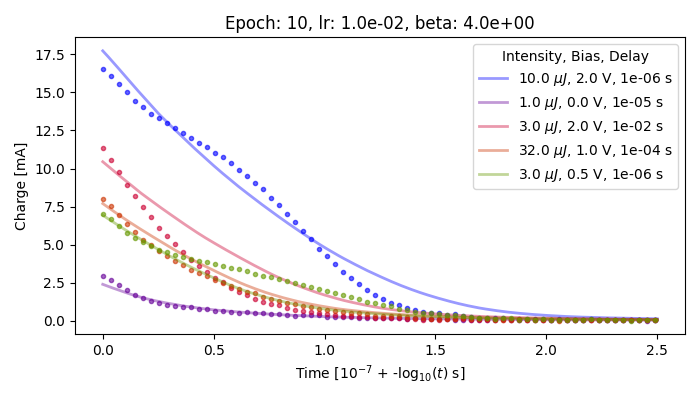

In [ ]:
plot_training_loss(model_params)
display_random_fit(model_params, dataset)

(150, 2) (150, 1000, 2)


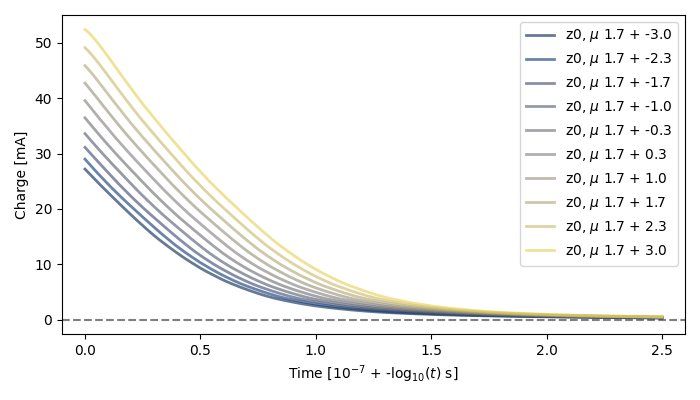

(150, 2) (150, 1000, 2)


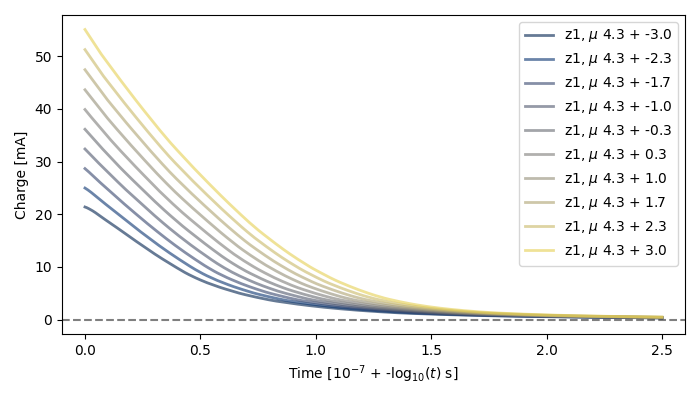

In [ ]:
sweep_latent_adaptives(model_params, dataset)

./saves/lr_0.01_nb_16_ld_2_b_4_default_20240312-122816/*.png
image_arrays shape: (5, 1200, 2100, 4)


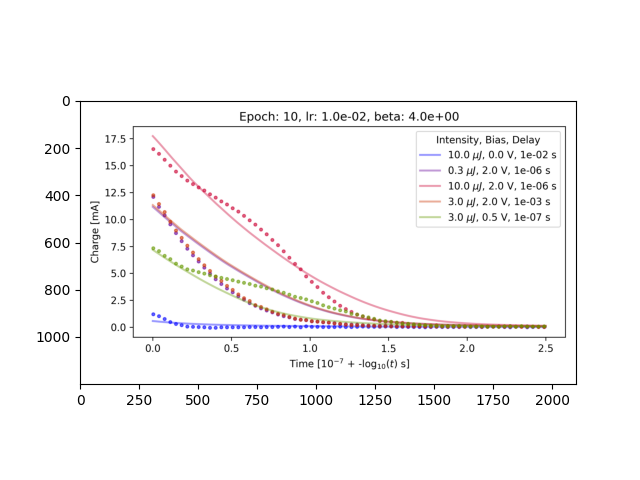

In [ ]:
compile_learning_gif(model_params)

select fixed subset to sample in gif
save the model
record params
plot param changes along with gif
remove 1 second bias
